# Cyclic hydration gravimetry and calorimetry
## data reduction and analysis for TGA/DSC/RH

### define global functions

In [1]:
def c_pad(data, length, mode='edge'):
    """ Pad 'data' to 'length' by applying a buffer to either side
        if 'data' and 'length' are both even, buffer is symmetric
        if 'data' and 'length' are both odd, buffer is symmetric
        if 'data' and 'length' differ, an element of padding is removed
            default is to remove the last element of padding
        Args
            data (numpy array): numpy array to pad
            length (int): number of elements to pad on each side of `data`
    """
    
    lo = len(data)
    lb = length - lo

    if lb % 2 > 0: # odd total length
        data_pad = np.pad(data, lb // 2, mode=mode)[:-1]
    elif lb < 2: # if desired length is 1 or fewer extra elements, array is unchanged
        data_pad = data
        print('c_pad: Array not paddable. Desired length probably shorter than array itself. Keeping original length')
    else: # even total length
        data_pad = np.pad(data, lb // 2, mode=mode)

    return data_pad
    
    
def smooth(data, sm=0.01, pmode='edge'):
    """ Smooth data with a running-average convolution kernel after padding.
        Return array with original length.
        Args
            data (array): 1D data array to smooth
            sm (float, int): fraction of data to average over
            mode ('same', 'valid', 'full'): follows convention of numpy's `convolve`
            pmode (numpy `pad` convention): values to padd array with
    """

    data_len = len(data)
    kernel = int(sm * data_len) // 2
    
    if kernel % 2 > 0: kernel = kernel + 1
    if kernel <= 0: kernel = 1

    data_pad = c_pad(data, data_len + kernel, mode=pmode) # always even length
    samples = np.ones(kernel)/kernel # always even length
    corr = np.convolve(data_pad, samples, mode='valid')[1:] # size data_len - kernel + 1
    
    return corr


def normalize(data):
    """" normalize data by subtracting min and dividing by max """

    sign = np.sign(np.sum(data))

    if sign > 0:
        norm_data = (data - np.sign(np.max(data))*np.min(data)) / (np.max(data) - np.sign(np.min(data))*np.min(data))
    else:
        norm_data = sign*(data - np.sign(np.max(data))*np.max(data)) / (np.min(data) - np.sign(np.max(data))*np.max(data))

    return norm_data
    
    
def phase_corr_1d(data1, data2):
    """ find phase lag between two signals in the Fourier domain by normalized phase-correlation """

    pcorr = data1 * np.conj(data2)
    pcorr_norm = pcorr / np.abs(pcorr)
    pcorr_inv = np.fft.ifft(pcorr_norm)

    return pcorr_inv


def vant_hoff_plot(T_data, K_data, plot=False):
    """ Do linear regression on the van 't hoff plots to get the slope (enthalpy) and intersection (entropy) """
    LinearModel = LinearRegression()
    T = np.array(T_data).reshape((len(T_data),1))
    logK = np.array(np.log(K_data)).reshape((len(K_data),1))
    LinearModel.fit(1/T, logK)
    slope = LinearModel.coef_[0][0]
    intersection = LinearModel.intercept_[0]
    delta_enthalpy = -slope*8.3145/1000 # KJ/mol
    delta_entropy = intersection*8.3145/1000 # KJ/mol/K
    if plot:
        plt.rcParams.update({'font.size': 10})
        plt.figure(figsize=(5,2.5))
        plt.plot(1/T, logK, 'o')
        plt.plot(1/T, LinearModel.predict(1/T))
        plt.xlabel('1/T (1/K)')
        plt.ylabel('ln(K)')
        plt.legend(['data', 'linear fit'])
        plt.tight_layout()
        plt.show()


    return delta_enthalpy, delta_entropy

### create CHGC class

In [2]:
#--- import libraries
import codecs
import re
import numpy as np
import matplotlib.pyplot as plt

import matplotlib.colors as mcolors
from scipy.special import erf
from scipy import optimize
from sklearn.linear_model import LinearRegression
import matplotlib.ticker as ticker
from sklearn.metrics import r2_score
from itertools import chain
import math
import seaborn as sns
import os
%config InlineBackend.figure_format = 'retina'

np.set_printoptions(threshold=np.inf) # to show all outputs from "print"
old_options = np.get_printoptions()   # to reset print options
plt.rcParams.update({'font.size': 20})
notebook_folder = os.path.dirname(os.path.abspath('__file__'))

#--- define chgc class

class chgc():
    """ chgc is a class that analyzes cyclic hydration gravimetry and calorimetry data.
        the input to chgc is a raw text file of temperature, weight, relative humidity, and/or heat flow profiles.
            pre-processing is based on Mettler-Toledo TGA-DSC3+ output format
        args:
            z - molar mass of sorbing substance used to calculate mole fractions
        
        methods:
            import_method - the temperature/relative humidity set points over time    
            parse_method -
            plot_method - 
            import_csv - 
    
    """
    #--- define chgc functions
    
    def __init__(self, z=762.3):
        # TGA/DSC3+ global variables
        self.z = z
        self.samp_int = None # sampling rate
        self.samp_unit = None # s or min typically
        
        # TGA/DSC3+ method variables
        self.method = None
        self.method_data = None
        self.segs = []
        self.seg_num = []
        self.seg_loc = []
        self.start_segs = []
        self.end_segs = []
        
        # TGA/DSC3+ segment variables
        self.duration = []
        self.duration_unit = None # check for difference with samp_unit
        self.time = []
        self.seg_time = []
        self.rh_set = []
        self.rh_prof = []
        self.temperature_set = []
        self.temperature_prof = []
        
        # TGA/DSC3+ outputs
        self.data = None
        self.data_grad = None
        self.data_fft = None
        self.data_fft_power = None
        self.data_fft_phase = None
        
        # Analysis
        self.enthalpies = []
        self.cps = []
        self.cpr = []
        self.cp = []
        self.weight_water = []
        self.mole_water = []
        self.real_water_weight = []
        self.real_water_mole = []
        self.x_rh = [] # real mole fraction of water at each RH level
        self.eff_rh = []
        self.hf_bg_sub = []
        self.hohne_fitted_params = []
        self.hohne_fitted_data = []
        self.testhf = []
        
    
    # --- define method functions ------------------------------------------
    def import_method(self, path):
        """ function to import the method file"""
        try: # try reading file
            codecs.open(path, encoding="utf-8", errors="ignore").readlines()
            self.method = open(path, encoding='utf-8').read()
        except UnicodeDecodeError: # if file can't be read, convert to utf-8
            with open(path, 'r', encoding='cp1252') as f:
                text = f.read()
            with open(path, 'w', encoding='utf-8') as f:
                f.write(text)
                self.method = open(path,encoding='utf-8').read()
    
    
    def parse_method(self):
        """ Parse a TGA/DSC method file into constituents for vizualization and analysis.
            Methods depict the temperature, relative humidity, and gas flow rate over a specified duration ...
                for a given number of segments
            Global variables are held constant over the course of an experiment
            Segment variables may change (or not) between segments
        """
        
        #--- search method document for segments, find location (element number) and number of segments 
        lines = self.method.split('\n')
        for i, line in enumerate(lines):
            if "sampling interval" in line.lower():
                self.samp_int = float(re.findall(r"\d+\.?\d*",line)[0])
                self.samp_unit = line.split(' ')[-1]
            
            if "segment" in line.lower():
                self.seg_loc.append(i)
                self.segs.append(line.split(' ')[-1])
                
            if "duration" in line.lower():
                self.duration.append(float(re.findall(r"\d+\.?\d*",line)[0]))
                self.duration_unit = line.split(' ')[-1]
                
            if "rel. humidity" in line.lower():
                self.rh_set.append([re.findall(r"\d+\.?\d*",line)[0]])
                
            if any(self.segs):
                if "temperature" in line.lower():
                    self.temperature_set.append([re.findall(r"\d+\.?\d*",line)[0]])
        
        #--- convert time units to seconds
        if self.duration_unit == self.samp_unit:
            pass
        elif self.samp_unit == 's':
            if self.duration_unit == 'min':
                self.duration = np.array(self.duration) * 60
        elif self.samp_unit == 'min': # not sure if this would happen
            if self.duration_unit == 's':
                self.duration = np.array(self.duration) / 60

        #--- make list of segment numbers for each datapoint, facilitating segmentwise operations
        self.seg_num = [float(num) * np.ones(int(float(dur) / self.samp_int)) for dur, num in zip(self.duration, self.segs)]
        self.seg_num = [int(t) for seg in self.seg_num for t in seg]
        self.seg_num = np.insert(self.seg_num, 0, 1)
                
        #--- put segment times into one list, and then take the cumulative sum for the running experiment time
        self.seg_time = [np.arange(self.samp_int, dur+1, self.samp_int)for dur in self.duration]
        self.seg_time[0] = np.insert(self.seg_time[0], 0, 0)
        
        self.time = [np.ones(int(float(dur) / self.samp_int)) for dur in self.duration] # this might break for different sample rates
        self.time = np.array([t for seg in self.time for t in seg])
        self.time = np.insert(np.cumsum(self.time), 0, 0)

        #--- find indeces corresponding to the end of each segment
        self.end_segs = np.array([len(seg) for seg in self.seg_time])
        self.end_segs[1:] += np.cumsum(self.end_segs[:-1]) - 1
        self.end_segs[0] = self.end_segs[0] - 1
        self.end_segs.astype(int) # recast as int for indexing
        
        #--- find indeces corresponding to the start of each segment
        self.start_segs = np.roll(self.end_segs, 1) + 1
        self.start_segs[0] = 0 # add first datapoint 
        self.start_segs.astype(int) # recast as int for indexing
        
        #--- make relative humidity profiles
        for seg, rh in zip(self.seg_time, self.rh_set):
            self.rh_prof.append(rh * len(seg))
        self.rh_prof = np.array([rh for seg in self.rh_prof for rh in seg]).astype('float64') #flatten
        
        #--- make temperature profiles
        for seg, t in zip(self.seg_time, self.temperature_set):
            self.temperature_prof.append(t * len(seg))
        self.temperature_prof = np.array([t for seg in self.temperature_prof for t in seg]).astype('float64') #flatten

    
    def plot_method(self, save=False, save_path=''):
        """ Plot the temperature and rh methods """
        
        fig, axs = plt.subplots(1,2, figsize=(22,6))
        plt.rcParams.update({'font.size': 20})

        axs[0].plot(self.time, self.rh_prof, color='b')
        axs[0].scatter(self.time[self.start_segs], self.rh_prof[self.start_segs], color='g', marker='o')
        axs[0].scatter(self.time[self.end_segs],   self.rh_prof[self.end_segs],   color='r', marker='o')
        axs[0].set_xlabel('time [min]')
        axs[0].set_ylabel('relative humidity [%]')
        

        axs[1].plot(self.time, self.temperature_prof, color='r')
        axs[1].scatter(self.time[self.start_segs], self.temperature_prof[self.start_segs], color='g', marker='o')
        axs[1].scatter(self.time[self.end_segs],   self.temperature_prof[self.end_segs],   color='r', marker='o')
        axs[1].set_xlabel('time [min]')
        axs[1].set_ylabel('reference temperature [$\degree$C]')

        plt.show
    
    
    #--- define data functions ------------------------------------------
    def import_csv(self, path, preprocess=False):
        """ function to import csv data from the specified path and convert to numpy array """
        if preprocess:
            skip_footer = 0
        else:
            skip_footer = 1
        
        self.data = np.genfromtxt(path, dtype=float, names=True, comments='[', skip_footer=skip_footer, encoding='cp1252') # data coming off Windows computer
        self.data_units = np.genfromtxt(path, dtype=str, names=True, autostrip=True, encoding='cp1252', skip_header=1, max_rows=1, deletechars='[]')
 
    
    def exclude_segments(self, segs=[1]):
        """ exclude segments from the data 
            Args
                segs (list): segment numbers to exclude. Default is [1], under the assumption that ...
                        you wouldn't call this method if you didn't want to remove at least one segment ...
                        and that the first one is the most likely to contain unwanted data
        """
        #--- preserve original data
        self.odata = self.data.copy()
        self.orh_prof = self.rh_prof.copy() 
        self.otemperature_prof = self.temperature_prof.copy()
        self.otime = self.time.copy()
        self.ostart_segs = self.start_segs.copy()
        self.oend_segs = self.start_segs.copy()
        self.oseg_num = self.seg_num.copy()
        
        #--- find indeces to remove
        ind_ex = np.in1d(np.array(self.seg_num), np.array(segs))
        ind_seg = np.in1d(np.array(self.segs).astype(int), np.array(segs))

        #--- remove indeces from data and profiles
        self.data = np.delete(self.data, ind_ex)
        self.rh_prof = np.delete(self.rh_prof, ind_ex)
        self.temperature_prof = np.delete(self.temperature_prof, ind_ex)
        self.time = np.delete(self.time, ind_ex)
        self.seg_num = np.delete(self.seg_num, ind_ex)
        self.end_segs = self.end_segs - self.end_segs[ind_seg] - 1
        self.end_segs = np.delete(self.end_segs, ind_seg)
        
        self.segs = [seg for seg in self.segs if int(seg) not in segs]
        
    
    def data_gradient(self, sm=0.01, pmode='edge'):
        """ Take gradient of loaded data (temperature, weight, heat flow, rh, etc.).
            Data can be smoothed to reduce noise.
            Smoothing can be applied uniformly to every curve or individually to each curve.
            
            Args
                sm (list or float): fraction of data length over which to smooth
                smode ('same', 'valid', 'full'): smoothing mode, based on numpy `convolve` convention
                pmode ('edge', etc.): based on numpy `pad` convention
            
        """
        self.data_grad = self.data.copy() # create data_grad array with same size and headers as data
        d_cols = len(self.data.dtype.names) # number of data columns
        
        if type(sm)==list:
            assert len(sm) == d_cols , "smoothing list length must match data column length (" + str(d_cols) + ")"
            print("data columns are " + str(self.data.dtype.names))
        else: # list of smoothing fractions
            l = len(self.data.dtype.names)
            smo = sm * np.ones(l)
        
        for smoo, name in zip(smo, self.data.dtype.names):
            if name.lower() == 'index': # skip the index column to preserve proper indeces
                pass
            if name.lower() == 't': # skip the time column to preserve proper times
                pass
            else:
                self.data_grad[name] = smooth(np.gradient(self.data_grad[name]), smoo, pmode=pmode) 
      
    
    def data_fouriertransform(self):
        """ Take Fourier Transform of loaded data (temperature, weight, heat flow, rh, etc.)
        """
        self.data_fft = self.data.copy() # create array with same size and headers as data
        self.data_fft_power = self.data.copy() # create array with same size and headers as data
        self.data_fft_phase = self.data.copy() # create array with same size and headers as data
       
        d_cols = len(self.data.dtype.names) # number of data columns
        d_type = list(zip(self.data.dtype.names, d_cols*['complex']))
        d_type_d = list(zip(self.data.dtype.names, d_cols*['float64']))
        
        self.data_fft = self.data_fft.astype(d_type)
        self.data_fft_power = self.data_fft_power.astype(d_type)
        
        for name in self.data.dtype.names:
            if name.lower() == 'index': # skip the index column to preserve proper indeces
                pass
            else:
                self.data_fft[name] = np.fft.fft(self.data_fft[name])
                self.data_fft_power[name] = np.abs(self.data_fft[name])**2
                self.data_fft_phase[name] = np.angle(self.data_fft[name])**2
        
        self.data_fft_power = self.data_fft_power.astype(d_type_d)
            
    
    def chgc_data(self, plot=True, save=False, save_path=''):
        """ Plot the raw CHGC data in five panels:
                1. Reference temperature
                2. Sample temperature
                3. Weight
                4. Heat Flow
                5. Relative Humidity
        """
        if plot:
            # fig, axs = plt.subplots(4, 1, figsize=(32, 32))
            # plt.rcParams.update({'font.size': 20})

            # axs[0].plot(self.time, self.rh_prof, color='b')
            # #axs[0].scatter(self.time[self.start_segs], self.rh_prof[self.start_segs], color='g', marker='o')
            # #axs[0].scatter(self.time[self.end_segs],   self.rh_prof[self.end_segs],   color='r', marker='o')
            # axs[0].set_xlabel('time [min]')
            # axs[0].set_ylabel('Designed relative humidity [%]')
            # axs[0].text(0.01, 0.92, 'a', transform=axs[0].transAxes, fontsize=30, fontweight='bold')

            # axs[1].plot(self.data['t'], self.data['RH'], color='g')
            # axs[1].set_xlabel('time [s]')
            # axs[1].set_ylabel(r'Relative humidity [%]')
            # axs[1].set_ylim([0,102])
            # axs[1].text(0.01, 0.92, 'b', transform=axs[1].transAxes, fontsize=30, fontweight='bold')

            # axs[2].plot(self.data['t'], self.data['Weight'], color='k')
            # axs[2].set_xlabel('time [s]')
            # axs[2].set_ylabel(r'Weight [mg]')
            # axs[2].text(0.01, 0.92, 'c', transform=axs[2].transAxes, fontsize=30, fontweight='bold')

            # axs[3].plot(self.data['t'], self.data['HF'], color='r')
            # axs[3].set_xlabel('time [s]')
            # axs[3].set_ylabel(r'Heat flow [mW]')
            # axs[3].text(0.01, 0.92, 'd', transform=axs[3].transAxes, fontsize=30, fontweight='bold')

            # plt.show
            fig, axs = plt.subplots(4, 1, figsize=(16, 16), sharex=True)  # 使用sharex=True来共享x轴
            plt.rcParams.update({'font.size': 16})  # 调整字体大小

            axs[0].plot(self.time, self.rh_prof, color='b')
            axs[0].set_ylabel('Designed \n relative humidity [%]')
            axs[0].text(0.01, 0.92, 'a', transform=axs[0].transAxes, fontsize=24, fontweight='bold')

            axs[1].plot(self.data['t'], self.data['RH'], color='g')
            axs[1].set_ylabel(r'Relative humidity [%]')
            axs[1].set_ylim([0,102])
            axs[1].text(0.01, 0.92, 'b', transform=axs[1].transAxes, fontsize=24, fontweight='bold')

            axs[2].plot(self.data['t'], self.data['Weight'], color='k')
            axs[2].set_ylabel(r'Weight [mg]', labelpad=15, y=0.5)
            axs[2].text(0.01, 0.92, 'c', transform=axs[2].transAxes, fontsize=24, fontweight='bold')

            axs[3].plot(self.data['t'], self.data['HF'], color='r')
            axs[3].set_xlabel('Time [s]')  # 只在最下面的子图上显示x轴标签
            axs[3].set_ylabel(r'Heat flow [mW]')
            axs[3].text(0.01, 0.92, 'd', transform=axs[3].transAxes, fontsize=24, fontweight='bold')

            plt.tight_layout()  # 调整子图间距
            plt.show()

        if save:
            plt.savefig(save_path)

    
    def chgc_grad_data(self, plot=True, save=False, save_path=''):
        """ Plot the raw CHGC data in five panels:
                1. Gradient of sample temperature
                2. Weight gradient
                3. Heat Flow
                4. Relative Humidity gradient
        """

        if plot:
            fig, axs = plt.subplots(4, 1, figsize=(32, 28))
            plt.rcParams.update({'font.size': 20})

            axs[0].plot(self.data_grad['t'], self.data_grad['Ts'], color='b')
            axs[0].set_xlabel(r'time [s]')
            axs[0].set_ylabel(r'$\partial$T/$\partial$t [$\degree$C / s]')

            axs[1].plot(self.data_grad['t'], self.data_grad['Weight'], color='k')
            axs[1].set_xlabel('time [s]')
            axs[1].set_ylabel(r'$\partial$weight/$\partial$t [mg/s]')
            axs[1].hlines(0, self.data_grad['t'][0], self.data_grad['t'][-1], linestyle="--", linewidth=1.5, color='grey')

            axs[2].plot(self.data_grad['t'], self.data_grad['HF'], color='r')
            axs[2].set_xlabel('time [s]')
            axs[2].set_ylabel(r'$\partial$heat flow/$\partial$t [mW/s]')
            axs[2].set_ylim([-np.max(self.data_grad['HF'])-0.0005, np.max(self.data_grad['HF'])+0.0005])

            axs[3].plot(self.data_grad['t'], self.data_grad['RH'], color='g')
            axs[3].set_xlabel('time [s]')
            axs[3].set_ylabel(r'$\partial$RH/$\partial$t [%/s]')

            plt.show

        if save:
            plt.savefig(save_path)

    def subtract_weight(self):
        self.data['HF'] = self.data['HF'] - self.data_grad['Weight']*1000


    def chgc_fft_data(self, sm=0.01, pmode='constant', plot=True):
        """ function to plot the fft of the data
            Args
                sm (int): smoothing kernel to apply - fraction of total data length
                pmode = padding mode for smoothing kernel - takes convention from numpy `pad`
        """
        self.data_fft_time = np.arange(len(self.data_fft))
        self.data_fft_freq = np.fft.rfftfreq(len(self.data_fft)) / self.samp_int
        self.data_fft_freq_len = len(self.data_fft_freq)

        if self.data_fft_freq_len % 2 > 0:
            self.data_fft_freq_len = self.data_fft_freq_len - 1

        #--- shift fft for visualization
        self.data_fft_shift = self.data_fft[:self.data_fft_freq_len+1]
        self.data_fft_shift_power = self.data_fft_power[:self.data_fft_freq_len+1]
        
        #--- frequency of one method segment and its index in frequency list
        self.seg_freq = 1 / ((self.data_fft_freq_len) / float(max(self.segs)))
        idx = (np.abs(self.data_fft_freq - self.seg_freq)).argmin()
        
        if plot: # --- make plots

            fig, axs = plt.subplots(2, 2, figsize=(16, 16))
            plt.rcParams.update({'font.size': 20})

            ax = np.ndarray.flatten(axs)

            ax[0].plot(self.data_fft_freq, self.data_fft_shift_power['Ts'], color='k')
            ax[0].vlines(self.data_fft_freq[idx], 0, self.data_fft_shift_power['Ts'][idx], color='r', linestyle='dashed')
            ax[0].set_xlabel(r'frequency [$s^{-1}$]')
            ax[0].set_ylabel(r'power [dB]')
            ax[0].set_xscale('log')
            ax[0].set_yscale('log')
            ax[0].set_title('sample temperature')
            
            ax[1].plot(self.data_fft_freq, self.data_fft_shift_power['Weight'], color='k')
            ax[1].vlines(self.data_fft_freq[idx], 0, self.data_fft_shift_power['Weight'][idx], color='r', linestyle='dashed')
            ax[1].set_xlabel(r'frequency [$s^{-1}$]')
            ax[1].set_ylabel(r'power [dB]')
            ax[1].set_xscale('log')
            ax[1].set_yscale('log')
            ax[1].set_title('weight')
            
            ax[2].plot(self.data_fft_freq, self.data_fft_shift_power['HF'], color='k')
            ax[2].vlines(self.data_fft_freq[idx], 0, self.data_fft_shift_power['HF'][idx], color='r', linestyle='dashed')
            ax[2].set_xlabel(r'frequency [$s^{-1}$]')
            ax[2].set_ylabel(r'power [dB]')
            ax[2].set_xscale('log')
            ax[2].set_yscale('log')
            ax[2].set_title('heat flow')
            
            ax[3].plot(self.data_fft_freq, self.data_fft_shift_power['RH'], color='k')
            ax[3].vlines(self.data_fft_freq[idx], 0, self.data_fft_shift_power['RH'][idx], color='r', linestyle='dashed')
            ax[3].set_xlabel(r'frequency [$s^{-1}$]')
            ax[3].set_ylabel(r'power [dB]')
            ax[3].set_xscale('log')
            ax[3].set_yscale('log')
            ax[3].set_title('relative humidity')

            plt.show()
            
            
            #--- plot frequency window corresponding to one segment (assuming equal segment lengths)
            s = 1 # data sampling for visualization
            #self.data_fft_freq_smooth = smooth(self.data_fft_freq, sm)

            fig, axs = plt.subplots(2, 2, figsize=(16, 16))
            plt.rcParams.update({'font.size': 20})

            ax = np.ndarray.flatten(axs)

            ax[0].plot(smooth(self.data_fft_freq[idx::s], sm), smooth(self.data_fft_shift_power['Ts'][idx::s], sm), color='k')
            ax[0].set_xlabel(r'frequency [$s^{-1}$]')
            ax[0].set_ylabel(r'power [dB]')
            ax[0].set_xscale('log')
            ax[0].set_yscale('log')
            ax[0].set_title('sample temperature')
            
            ax[1].plot(smooth(self.data_fft_freq[idx::s], sm), smooth(self.data_fft_shift_power['Weight'][idx::s], sm), color='k')
            ax[1].set_xlabel(r'frequency [$s^{-1}$]')
            ax[1].set_ylabel(r'power [dB]')
            ax[1].set_xscale('log')
            ax[1].set_yscale('log')
            ax[1].set_title('weight')
            
            ax[2].plot(smooth(self.data_fft_freq[idx::s], sm), smooth(self.data_fft_shift_power['HF'][idx::s], sm), color='k')
            ax[2].set_xlabel(r'frequency [$s^{-1}$]')
            ax[2].set_ylabel(r'power [dB]')
            ax[2].set_xscale('log')
            ax[2].set_yscale('log')
            ax[2].set_title('heat flow')
            
            ax[3].plot(smooth(self.data_fft_freq[idx::s], sm), smooth(self.data_fft_shift_power['RH'][idx::s], sm), color='k')
            ax[3].set_xlabel(r'frequency [$s^{-1}$]')
            ax[3].set_ylabel(r'power [dB]')
            ax[3].set_xscale('log')
            ax[3].set_yscale('log')
            ax[3].set_title('relative humidity')
            
            plt.show()
            
    
    def rh_lag(self, plot=True):
        """ determine phase lag between RH change and heat flow
        """
        # take phase correlation, then determine whether shift is positive or negative
        # how much first is shifted relative to second
        corr = phase_corr_1d(self.data_fft['HF'], self.data_fft['RH'])
        corr_ny = len(corr) // 2
        corr_argmax = np.argmax(corr)
        
        # check for negative shift
        if corr_argmax > corr_ny:
            corr_argmax = int(corr_argmax - len(corr))
            
        self.rhlag_idx = corr_argmax
        self.rhlag = corr_argmax * self.samp_int
        
        if plot:
            fig, axs = plt.subplots(1, 2, figsize=(12, 6))
            plt.rcParams.update({'font.size': 20})
            
            axs[0].plot(self.data['t'][:200], corr[:200], color='k')
            axs[0].set_title('positive shift')
            axs[0].set_ylim([10**-4, 10**0])
            axs[0].set_yscale('log')
            
            axs[1].plot(self.data['t'][-200:], corr[-200:], color='k')
            axs[1].set_title('negative shift')
            axs[1].set_ylim([10**-4, 10**0])
            axs[1].set_yscale('log')
            
            if self.rhlag_idx >= 0:
                axs[0].scatter(self.data['t'][self.rhlag_idx], corr[self.rhlag_idx], marker='o', s=128, color='r')
            else:
                axs[1].scatter(self.data['t'][self.rhlag_idx], corr[self.rhlag_idx], marker='o', s=128, color='r')
                
        return 
            
    
    def weight_lag(self, plot=True):
        """ determine phase lag between weight change and heat flow
        """
        # take phase correlation, then determine whether shift is positive or negative
        corr = phase_corr_1d(self.data_fft['Weight'], self.data_fft['HF'])
        corr_ny = len(corr) // 2
        corr_argmax = np.argmax(corr)
        
        #check for negative shift
        if corr_argmax > corr_ny:
            corr_argmax = int(corr_argmax - len(corr))
            
        self.weightlag_idx = corr_argmax
        self.weightlag = corr_argmax * self.samp_int
        
        if plot:
            fig, axs = plt.subplots(1, 2, figsize=(12, 6))
            plt.rcParams.update({'font.size': 20})
            
            #TODO fix the range on these plots!!!
            axs[0].plot(self.data['t'][:11000], corr[:11000], color='k')
            axs[0].set_title('positive shift')
            axs[0].set_ylim([10**-4, 10**0])
            axs[0].set_yscale('log')
            
            axs[1].plot(self.data['t'][-200:], corr[-200:], color='k')
            axs[1].set_title('negative shift')
            axs[1].set_ylim([10**-4, 10**0])
            axs[1].set_yscale('log')
            
            if self.weightlag_idx >= 0:
                axs[0].scatter(self.data['t'][self.weightlag_idx], corr[self.weightlag_idx], marker='o', s=128, color='r')
            else:
                axs[1].scatter(self.data['t'][self.weightlag_idx], corr[self.weightlag_idx], marker='o', s=128, color='r')
    

    def hydration_quant(self, fsize=100, hfextrema=1, massplot=True, bgplot=True, save=False, save_path=''):
        """ quantify hydration isotherms """
    
        # --- mass change in each segment
        self.minmass = np.zeros(len(self.segs))
        self.maxmass = np.zeros(len(self.segs))
        self.firstmass = np.zeros(len(self.segs))
        self.lastmass = np.zeros(len(self.segs))
        for idx, i in enumerate(self.segs):
            seg_idx = int(i)
            segwhere = self.seg_num == seg_idx
            self.minmass[idx] = np.min(self.data['Weight'][segwhere])
            self.maxmass[idx] = np.max(self.data['Weight'][segwhere])
            self.firstmass[idx] = self.data['Weight'][segwhere][0]
            self.lastmass[idx] = self.data['Weight'][segwhere][-1]
        
        self.mass_steps = self.lastmass - self.firstmass
        self.mass_steps[0] = abs(self.mass_steps[-1])
        self.water_weight = np.cumsum(self.mass_steps)
        self.mass_net = np.sum(self.mass_steps)
        self.mass_frac = self.lastmass/self.lastmass[0] - 1
        self.mole_frac = (self.water_weight / 1000 / 17.998) / (1.15*(np.min(self.data['Weight']) / self.z) + (self.water_weight / 1000 / 17.998))
        
        if massplot:
            fig, axs = plt.subplots(1,2, figsize=(22,6))
            plt.rcParams.update({'font.size': 20})

            axs[0].plot(self.data['RH'][self.end_segs], 100*self.mass_frac, color='k', marker='o')
            axs[0].scatter(self.data['RH'][self.end_segs], 100*self.mass_frac, color='k', marker='o')
            axs[0].set_xlabel('Relative humidity [%]')
            axs[0].set_ylabel('Mass change [%]')
            axs[0].text(0.01, 0.92, 'a', transform=axs[0].transAxes, fontsize=30, fontweight='bold')
            
            axs[1].plot(self.data['RH'][self.end_segs], self.mole_frac, color='k', marker='o')
            axs[1].scatter(self.data['RH'][self.end_segs], self.mole_frac, color='k', marker='o')
            axs[1].set_xlabel('Relative humidity [%]')
            axs[1].set_ylabel('$x_{H_2O}$')
            axs[1].text(0.01, 0.92, 'b', transform=axs[1].transAxes, fontsize=30, fontweight='bold')

            plt.show
        
        if save:
            plt.savefig(save_path)
        
        # --- heat flow background
        # --- assert that background must represent thermal steady state
        # --- i.e., fluctuations must arise from a random normal distribution centered at zero
        gaussian = lambda x, m, s : np.exp((-(x-m)**2)/(2*s**2))
        g_kernel = gaussian(np.arange(-fsize,fsize), 0, fsize)
            
        self.seg_bgs = np.zeros(len(self.segs))
        # --- find background for each bg segment
        for idx, seg in enumerate(self.segs): 
            # --- identify data most likely to be noise
            segwhere = self.seg_num == float(seg) # location of data in one segment
            bseg = np.ravel(self.data['HF'][segwhere]) # heat flow data in segment
            bseg_diff = np.sign(np.diff(bseg)) # minimum number of datapoints in excess of steady state (maximum length is n-1 for n datapoints)
            bseg_diff_sign = np.sign(np.sum(bseg_diff)) # side to which data skews most, i.e., is data generally increasing or decreasing
            bseg_diff_subdata = bseg_diff == bseg_diff_sign # location of data on side to which data skews most
            bseg_asymmetry = int(np.abs(np.sum(bseg_diff))) # total number of datapoints to remove
                        
            # --- Gaussian kernel smoothing of difference sign signal
            bseg_diff_corr = np.convolve(bseg_diff, g_kernel, mode='same') # base kernel size on power spectrum
            bseg_diff_keep = np.argsort(abs(bseg_diff_corr))[:bseg_asymmetry] # extremal values of the smoothed difference sign signal to remove from fit
            bseg_new = bseg[bseg_diff_keep]
            bseg_newmean = np.mean(bseg_new)
            bseg_newstd = np.std(bseg_new)
            #plt.hist(bseg_new, bins=int(np.sqrt(len(bseg_new)))); plt.show()
            
            ii = 0
            while ii <= hfextrema:
                bseg_low = bseg_newmean + bseg_newstd
                bseg_hi = bseg_newmean - bseg_newstd  
                bseg_hilow = np.sort([np.abs(bseg_low),np.abs(bseg_hi)])
                bseg_subwhere = (np.abs(bseg_new) > bseg_hilow[0]) & (np.abs(bseg_new) < bseg_hilow[1]) # data less than 1 std from mean
                bseg_new = bseg_new[bseg_subwhere]
                bseg_newmean = np.mean(bseg_new)
                bseg_newstd = np.std(bseg_new)
                bseg_bg = bseg_newmean
                ii += 1
                #plt.hist(bseg_new, bins=int(np.sqrt(len(bseg_new)))); plt.show()
            
            self.seg_bgs[idx] = bseg_bg
            #TODO - add location of background data
        
        if bgplot:
            fig, axs = plt.subplots(1, 2, figsize=(22,6))
            plt.rcParams.update({'font.size': 20})
            
            axs[0].plot(self.data['RH'][self.end_segs], self.seg_bgs, color='k')
            axs[0].scatter(self.data['RH'][self.end_segs], self.seg_bgs, color='k')
            axs[0].set_xlabel('RH [%]')
            axs[0].set_ylabel('Heat flow baseline [mW]')
            axs[0].text(0.01, 0.92, 'a', transform=axs[0].transAxes, fontsize=30, fontweight='bold')
            
            axs[1].plot(self.data['RH'][self.end_segs], self.seg_bgs/np.abs(self.mass_steps), color='k')
            axs[1].scatter(self.data['RH'][self.end_segs], self.seg_bgs/np.abs(self.mass_steps), color='k')
            axs[1].set_xlabel('RH [%]')
            axs[1].set_ylabel('Normalized Heat flow baseline [mW/g]', fontsize=18)
            axs[1].text(0.01, 0.92, 'b', transform=axs[1].transAxes, fontsize=30, fontweight='bold')
            
            plt.show()


    
    
    def hydration_integrate(self, peak_plot=True, plot=True, timefactor=1):
        """ integrate heat flow curves in each segment to get hydration enthalpies 
        """
        #--- plot settings
        if plot:
            fig, axs = plt.subplots(2, 2, figsize=(20, 12))
            plt.rcParams.update({'font.size': 24})
            ax = np.ndarray.flatten(axs)
            
            colors_hot = plt.cm.autumn(np.linspace(0,1,len(self.segs)//2 + 1))
            colors_cool = plt.cm.winter(np.linspace(0,1,len(self.segs)//2 + 2))
            j, k = 0, 0 # plot increment counters for display
        
        last_bg = self.seg_bgs[0] 
        #--- heat flow segments
        for i, seg in enumerate(self.segs):
            ind_ex = np.in1d(np.array(self.seg_num), int(seg))
            min_ind = np.min(np.argwhere(ind_ex))
            max_ind = np.max(np.argwhere(ind_ex))
            seg_time = np.arange(max_ind-min_ind)
            rh = self.rh_prof[min_ind]

            #last_bg = self.seg_bgs[i]

            # --- bg prof
            weight_grad = self.data_grad['Weight'][min_ind:max_ind]

            #weight_grad_argmax = np.argmax(np.max(np.abs(weight_grad))) # np.max 是一个最大值，索引最大值中的最大值，只会返回0.
            weight_grad_argmax = np.argmax(np.abs(weight_grad))

            #print(weight_grad[weight_grad_argmax])
            weight_sign = np.sign(weight_grad[weight_grad_argmax])
            left_data = - np.cumsum(weight_grad[:weight_grad_argmax][::-1]) 
            right_data = np.cumsum(weight_grad[weight_grad_argmax:])
            bg_data = np.concatenate((left_data, right_data))
            if weight_sign >= 0:
                bg_data_norm = (bg_data - np.min(bg_data)) / np.max(bg_data) 
            if weight_sign < 0:
                bg_data_norm = -(bg_data - np.max(bg_data)) / np.max(np.abs(bg_data))
            
            #--- heat flow baseline subtraction
            hf = self.data['HF'][min_ind:max_ind] - self.data['HF'][min_ind]  # last_bg # heat flow relative to previous segment
            #hf = hf - hf[0]
            #
            hf_sign = np.sign(hf[np.argmax(np.abs(hf))]) # endotherm or exotherm
            step = (self.seg_bgs[i]+10**-10) - last_bg
            step_sign = np.sign(step)
            #print('weight sign, hf sign, step sign:' + str((weight_sign, hf_sign, step_sign)))
            
            #mass change mask
            dm_norm = np.abs(weight_grad / np.max(np.abs(weight_grad)))
            dm_norm[dm_norm < 0.025] = 0
            dm_norm[dm_norm > 0.025] = 1
            #print(dm_norm)

            hf_bg_sub = (hf - step* bg_data_norm)  * dm_norm 
            last_bg = self.seg_bgs[i]
            self.hf_bg_sub.append(hf_bg_sub)
            if peak_plot:
                plt.plot(seg_time, hf_bg_sub, color='k', linestyle='dotted')
                plt.plot(seg_time, hf, color='r')
                plt.plot(seg_time, step*bg_data_norm, color='0.5')
                plt.plot(seg_time, dm_norm, color='0.2', linestyle='dashed')
                plt.show()
         
            #--- enthalpy
            hf_int = timefactor*np.trapz(hf_bg_sub, dx=self.samp_int) # (mW*s) # 1.25
            self.mole_water.append(self.mass_steps[i] / (1000 * 17.998)) # (mol H2O)
            #self.enthalpies.append((self.samp_int * hf_int * 17.998) / (1000 * self.mass_steps[i])) # (kJ/mol H2O)
            self.enthalpies.append((self.samp_int * hf_int)/self.mole_water[i]/1000/1000)
            self.cps.append((self.samp_int * step * 1000 * 17.998) / (2 * 1000 * self.mass_steps[i] * (273+18)))
            
            # --- make plots
            if hf_sign > 0:
                #j += 1
                color = colors_hot[j]
                j += 1
            else:
                #k += 1
                color = colors_cool[k]
                k += 1
            
            if plot:

                ax[0].plot(seg_time, hf_bg_sub, color=color)
                ax[0].set_xlabel('Time [s]', fontsize=24)
                ax[0].set_ylabel(r'Heat flow [mW]', fontsize=24)
                ax[0].hlines(0, 0, np.max(seg_time), color='k')
                ax[0].text(0.01, 0.92, 'a', transform=ax[0].transAxes, fontsize=28, fontweight='bold')

                ax[1].plot(seg_time, smooth(hf_bg_sub, sm=0.1), color=color)
                ax[1].set_xlabel('Time [s]', fontsize=24)
                ax[1].set_ylabel(r'Normalized heat flow [mW]', fontsize=24)
                ax[1].hlines(0, 0, np.max(seg_time),color='k')
                ax[1].text(0.01, 0.92, 'b', transform=ax[1].transAxes, fontsize=28, fontweight='bold')
                               
                if i > 0:

                    scatter_size = 70
                    # ax[2].scatter(self.data['RH'][self.end_segs][i], np.abs(self.enthalpies[i]), color=color)
                    # ax[2].plot(self.data['RH'][self.end_segs][i], np.abs(self.enthalpies[i]), color=color, linewidth=2)
                    ax[2].scatter(self.data['RH'][self.end_segs][i], self.enthalpies[i], color=color, s=scatter_size)
                    ax[2].plot(np.array(self.data['RH'][self.end_segs][i]), self.enthalpies[i], color=color, linewidth=2)
                    ax[2].set_xlabel(r'Relative humidity [%]', fontsize=24)
                    ax[2].set_ylabel(r'$|\Delta$H| [kJ/mol-water]', fontsize=24)
                    ax[2].set_ylim([0, np.nanmax(self.enthalpies)+10])
                    ax[2].text(0.01, 0.92, 'c', transform=ax[2].transAxes, fontsize=28, fontweight='bold')

                    # ax[3].scatter(self.mole_water[i], np.abs(self.enthalpies[i]), color=color)
                    # ax[3].plot(self.mole_water[i], np.abs(self.enthalpies[i]), color=color, linewidth=2)
                    ax[3].scatter(self.mole_water[i], self.enthalpies[i], color=color, s=scatter_size)
                    ax[3].plot(self.mole_water[i], self.enthalpies[i], color=color, linewidth=2)
                    ax[3].set_xlabel(r'$n$ $H_2O$', fontsize=24)
                    ax[3].set_ylabel(r'$|\Delta$H| [kJ/mol-water]', fontsize=24)
                    ax[3].set_ylim([0, np.nanmax(self.enthalpies)+10])
                    ax[3].text(0.01, 0.92, 'd', transform=ax[3].transAxes, fontsize=28, fontweight='bold')
                plt.tight_layout()

        plt.show()


    
    def equilibrium_constant(self, path, P_sat_T, preprocess=False):
        """ function to import csv data from the specified path and convert to numpy array """
        """ import the csv data of dry weight measurement. Function is same as "import_csv". """
        if preprocess:
            skip_footer = 0
        else:
            skip_footer = 1
        
        dry_data = np.genfromtxt(path, dtype=float, names=True, comments='[', skip_footer=skip_footer, encoding='cp1252') # data coming off Windows computer
        dry_data_units = np.genfromtxt(path, dtype=str, names=True, autostrip=True, encoding='cp1252', skip_header=1, max_rows=1, deletechars='[]')

        dry_weight = np.min(dry_data['Weight'])
        P_sat_25C = 3.171 # kPa

        for i, seg in enumerate(self.segs):
            ind_ex = np.in1d(np.array(self.seg_num), int(seg))
            min_ind = np.min(np.argwhere(ind_ex))
            max_ind = np.max(np.argwhere(ind_ex))
            self.eff_rh.append(self.rh_prof[min_ind])
            
            real_water_weight = self.data['Weight'][max_ind] - dry_weight
            self.x_rh.append(real_water_weight / self.data['Weight'][max_ind])

        # RH from 10% to 100% hydratio, from 90% to 0% dehydration.
        self.eff_rh[-1] = self.data['RH'][-1]
        k_eq = np.dot((self.eff_rh), 0.01) * (P_sat_25C/P_sat_T) * (self.x_rh)
        k_eq_hydration = k_eq[0:10]
        k_eq_dehydration = 1/ k_eq[10:]
        eff_rh_hyd = self.eff_rh[0:9]
        eff_rh_dehyd = self.eff_rh[10:19]

        return k_eq_hydration, k_eq_dehydration
    
        
    def hohne_fitting(self, p_0=[0, 2, 1000, 20], max_fev = 1000, save=False, save_path=''): # exclude segments before this fit.
        """ fit the hohne function to the background subtracted heat flow data """

        hohne_test_bg_sub = self.hf_bg_sub  # self.hf_bg_sub[1] - self.hf_bg_sub[1][0]
        hf_bg_sub_flat = list(chain.from_iterable(self.hf_bg_sub))
        plt.rcParams.update({'font.size': 10})
        plt.plot(self.data['HF']-self.data['HF'][0], linewidth = 1, color='tomato', linestyle='-', label='Original HF ')
        plt.plot(hf_bg_sub_flat, linewidth = 1, color='blue', linestyle='--', label = 'Bg Subtracted HF')
        plt.title('Comparison of HF and HF-Background Subtracted')
        plt.xlabel('Time [s]')
        plt.ylabel(r'$\Delta$ T [K]')
        plt.legend() #['HF', 'HF - BG'], fontsize=10

        def hohne_function(x, a1_, a2_, tau1_, tau2_):
            return a1_*np.exp(-x/tau1_)+a2_*np.exp(-x/tau2_) 
         
        fitted_params = np.zeros((len(self.hf_bg_sub), 4))
        fitted_hohne_bg_sub = np.zeros((len(self.hf_bg_sub), len(self.hf_bg_sub[0])))

        r2_scores = np.zeros((len(self.hf_bg_sub), 1))

        # for i in range(len(self.hf_bg_sub)):
        #     fitted_hohne_bg_sub.append()

        for i, seg in enumerate(self.segs):
            if seg == self.segs[-1]: # The last segment is usually longer, cannot adapt into the fitted_hohne_bg_sub array.
                break
            ppot, pcov = optimize.curve_fit(hohne_function, np.arange(len(hohne_test_bg_sub[i])), hohne_test_bg_sub[i], p0=p_0, maxfev=max_fev)
            fitted_params[i] = ppot
            fitted_hohne_bg_sub[i] = hohne_function(np.arange(len(hohne_test_bg_sub[i])), *ppot)
            r2_scores[i] = round(r2_score(fitted_hohne_bg_sub[i], hohne_test_bg_sub[i]), 2)

            
        
        ppot_last_seg, pcov_last_seg = optimize.curve_fit(hohne_function, np.arange(len(hohne_test_bg_sub[-1])), hohne_test_bg_sub[-1], p0=p_0, maxfev=max_fev)
        fitted_params_last_seg = ppot_last_seg
        fitted_hohne_bg_sub_last_seg = hohne_function(np.arange(len(hohne_test_bg_sub[-1])), *ppot_last_seg)
        r2_scores[-1] = round(r2_score(fitted_hohne_bg_sub_last_seg, hohne_test_bg_sub[-1]), 2)
        fitted_params[-1] = fitted_params_last_seg

        self.hohne_fitted_params =  fitted_params
        self.hohne_fitted_data = list(chain.from_iterable(fitted_hohne_bg_sub)).extend(fitted_hohne_bg_sub_last_seg)

        pad_width = ((0,0), (0, len(self.hf_bg_sub[-1]) - len(self.hf_bg_sub[0])))
        fitted_hohne_bg_sub = np.pad(fitted_hohne_bg_sub, pad_width, mode='constant', constant_values=None)
        fitted_hohne_bg_sub[-1] = fitted_hohne_bg_sub_last_seg

        np.set_printoptions(suppress=True) # print the fitted parameters in normal format
        print('Fitted Parameters are')
        print(fitted_params)
        #np.set_printoptions(**old_options) # reset the print options
        

        #sns.set_style("whitegrid")
        fig, axs = plt.subplots(math.ceil(len(self.hf_bg_sub) / 3), 3, figsize=(20, 18), constrained_layout=True, squeeze=False, gridspec_kw={'hspace': 0.2, 'wspace': 0.2})

        for i, seg in enumerate(self.segs):
            row = i // 3
            col = i % 3
            axs[row, col].plot(hohne_test_bg_sub[i], linewidth=1.5, color='tomato', linestyle='-', label='BG subtracted HF')
            axs[row, col].plot(fitted_hohne_bg_sub[i], linewidth=1.5, color='blue', linestyle='--', label='Hohne Fit')
            axs[row, col].set_title('Relative humidity ' + str(int(float(self.rh_set[i+1][0]))) + '%'+ '  ' r'$R^2$ = ' + str(r2_scores[i]), size=18)
            axs[row, col].set_xlabel('Time [s]', size=16)
            axs[row, col].set_ylabel('HF [mW]', size=16)
            axs[row, col].legend(fontsize=14)
            #axs[row, col].annotate(r'$R^2$ = ' + str(r2_scores[i]), xy=(0.4, 0.9), xycoords='axes fraction', size=16)

            # hide the tick label
            axs[row, col].tick_params(axis='both', which='both', labelsize=14, length=0)

        # hide the empty subplots
        if len(self.hf_bg_sub) < axs.size:
            for i in range(len(self.hf_bg_sub), axs.size):
                axs.flatten()[i].axis("off")

        plt.tight_layout()
        if save:
            plt.savefig(save_path, dpi=300)
        plt.show()
        sns.reset_orig()


    

### Test

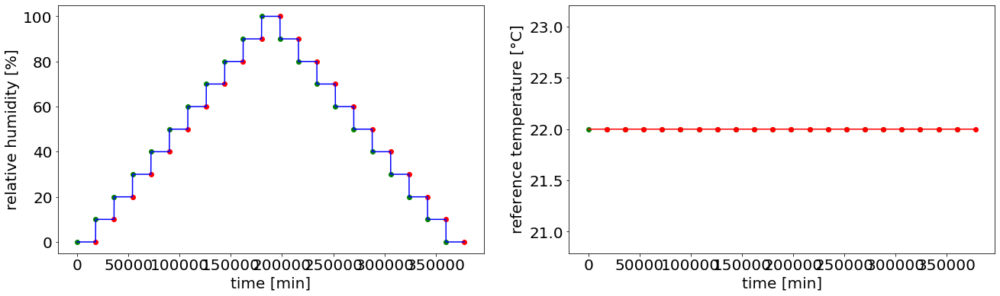

In [158]:
YT1_22C_longtime = chgc()
YT1_22C_longtime.import_method('YT1_temperature_study_22C_5h_method/YT1_temperature_study_22C_5h_method.txt')
YT1_22C_longtime.parse_method()
YT1_22C_longtime.plot_method()
YT1_22C_longtime.import_csv('YT1_temperature_study_22C_5h_method/YT1_22C_longtime_5h.txt', preprocess=True)
YT1_22C_longtime.exclude_segments(segs=[1])
YT1_22C_longtime.data_gradient(sm=1*10**-3)

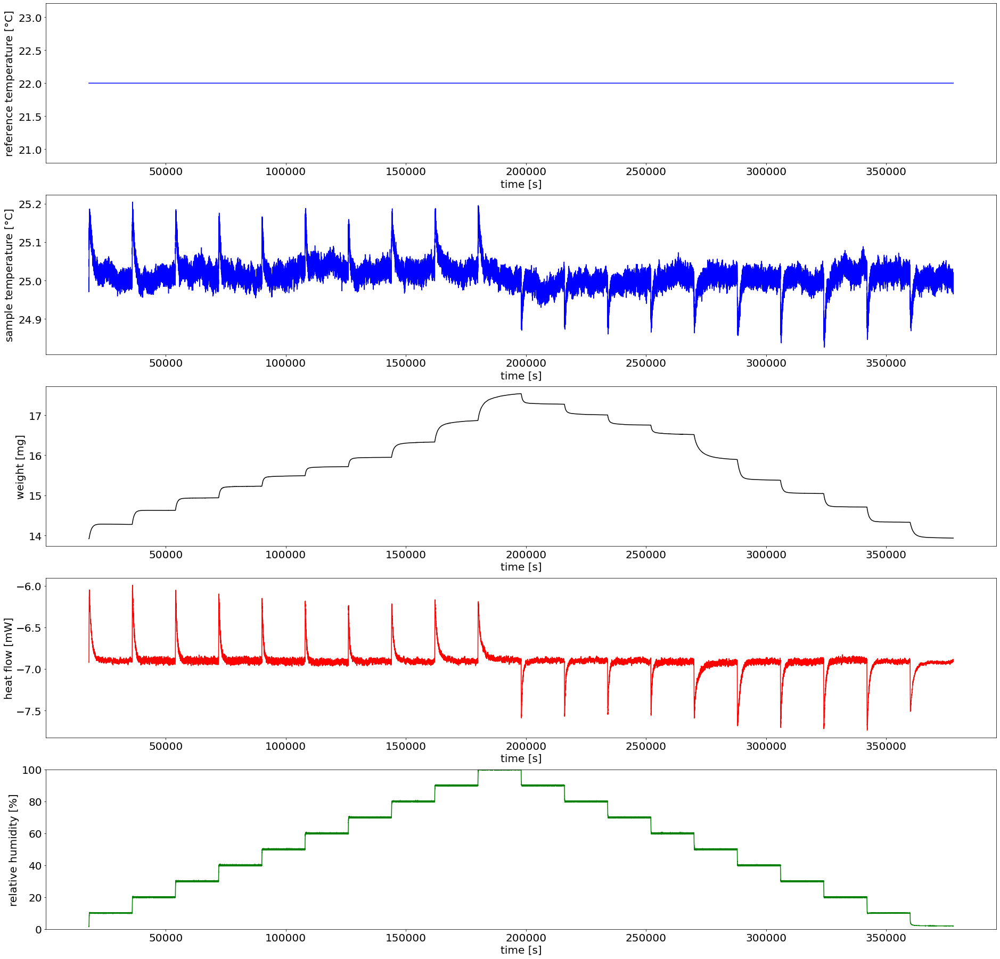

In [159]:
YT1_22C_longtime.chgc_data()

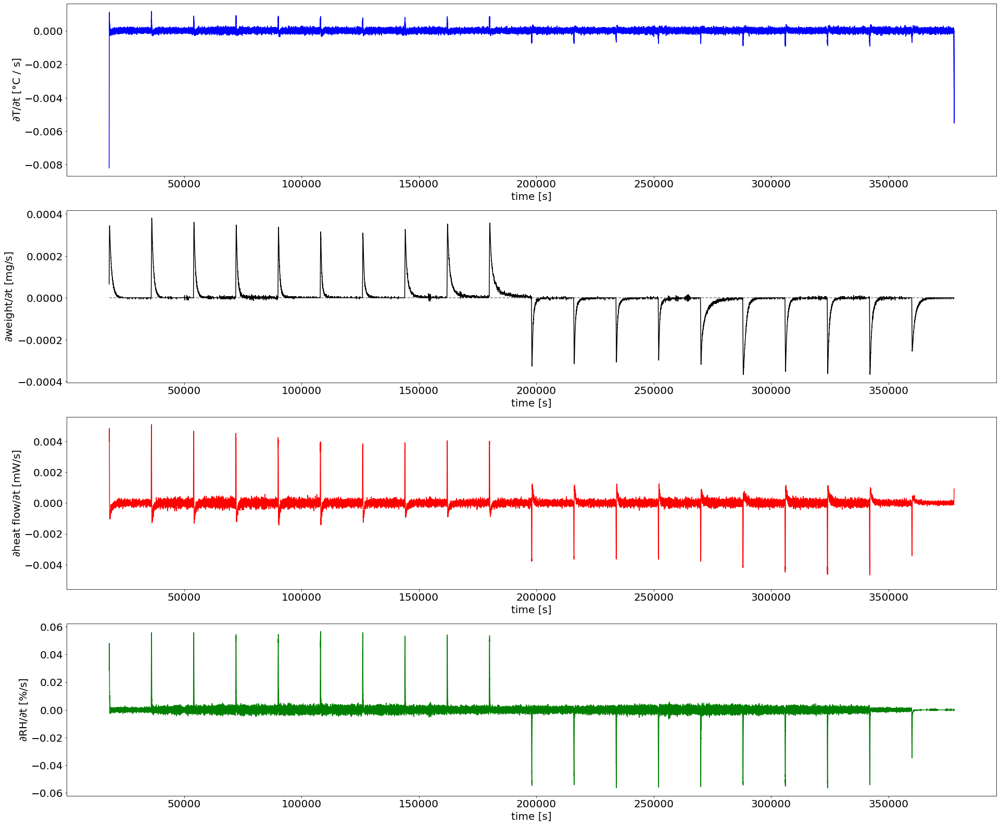

In [160]:
YT1_22C_longtime.chgc_grad_data()

In [23]:
YT1_22C_longtime.subtract_weight()

In [24]:
YT1_22C_longtime.data_fouriertransform()

C:\Users\yunti\AppData\Local\Temp\ipykernel_20896\3497724221.py:287: ComplexWarning: Casting complex values to real discards the imaginary part
  self.data_fft_power = self.data_fft_power.astype(d_type_d)


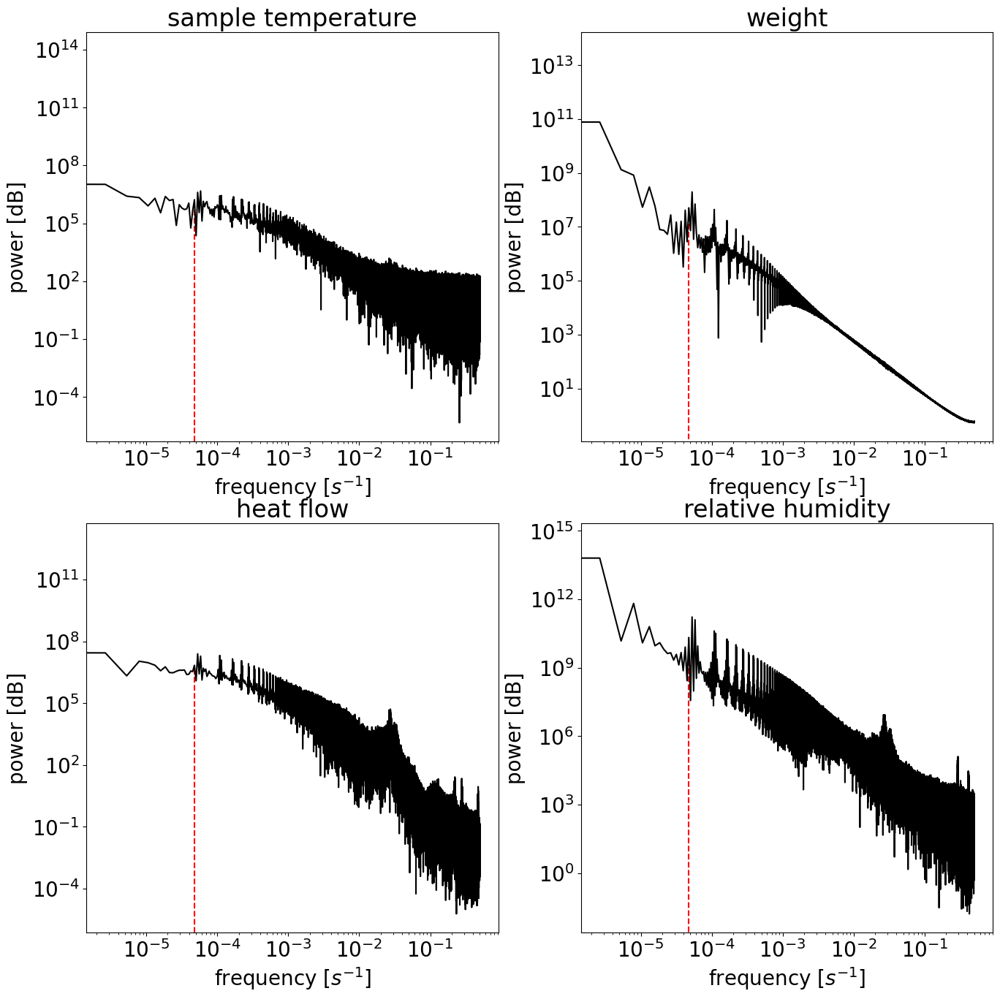

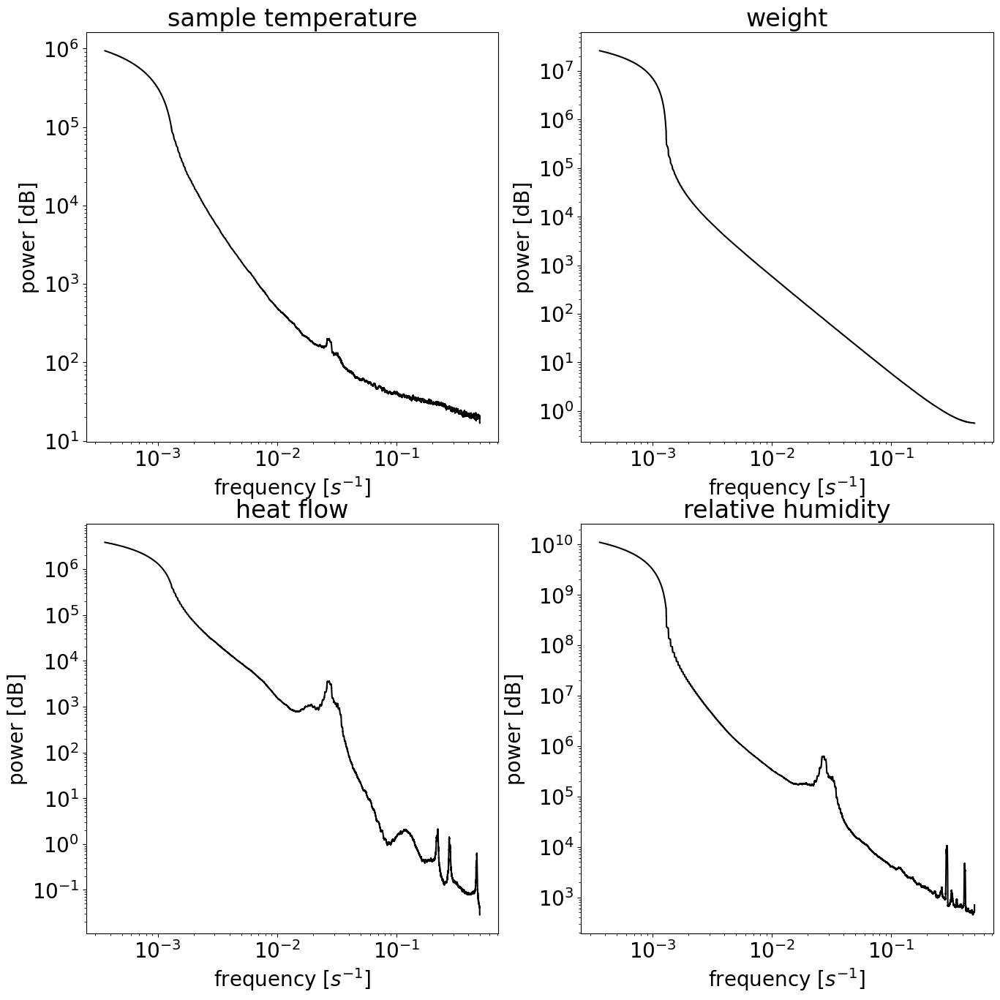

In [25]:
YT1_22C_longtime.chgc_fft_data()

c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:136: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


-7.0

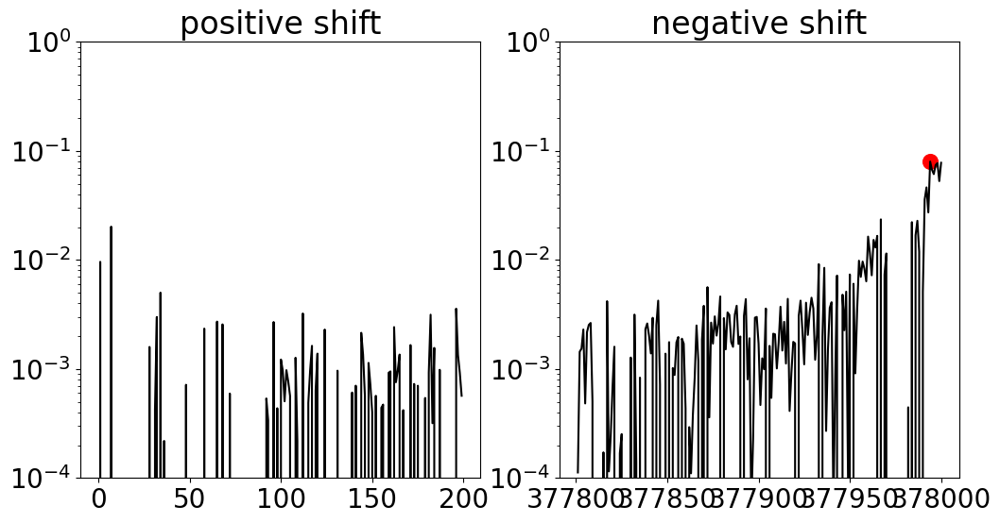

In [26]:
YT1_22C_longtime.rh_lag()
YT1_22C_longtime.rhlag

c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_asarray.py:136: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


1.0

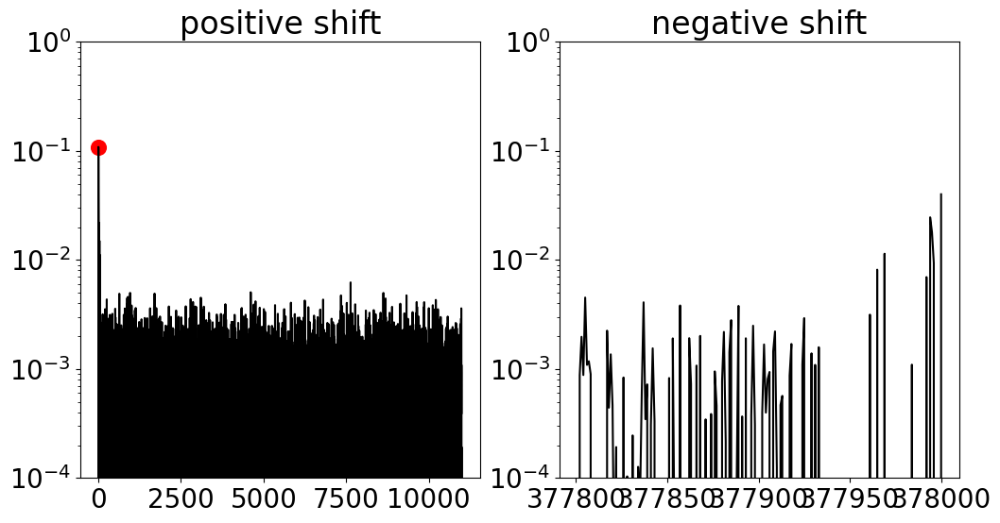

In [27]:
YT1_22C_longtime.weight_lag()
YT1_22C_longtime.weightlag

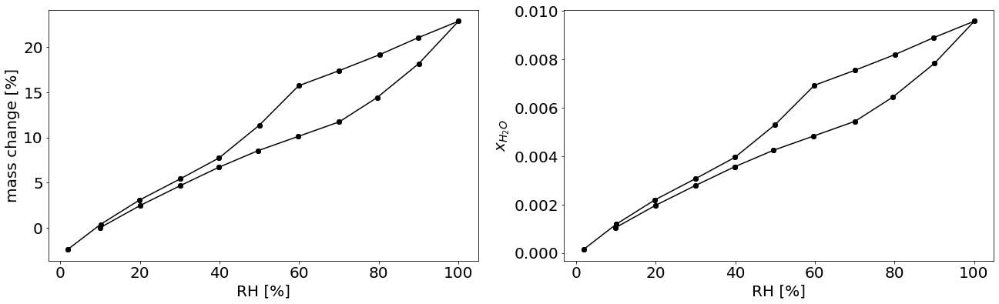

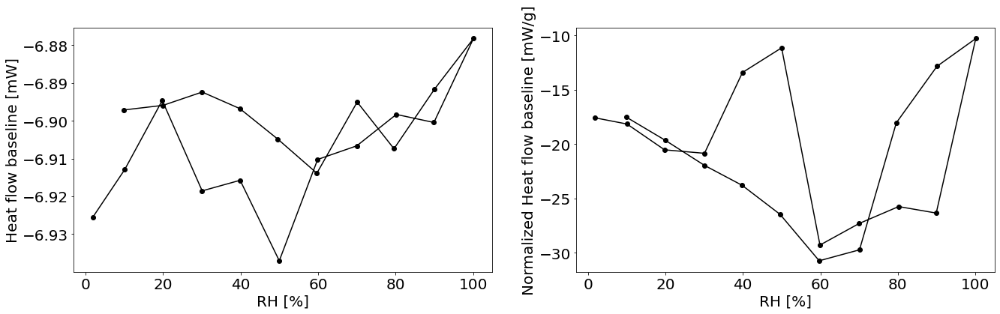

In [161]:
YT1_22C_longtime.hydration_quant(fsize=100, hfextrema=1)

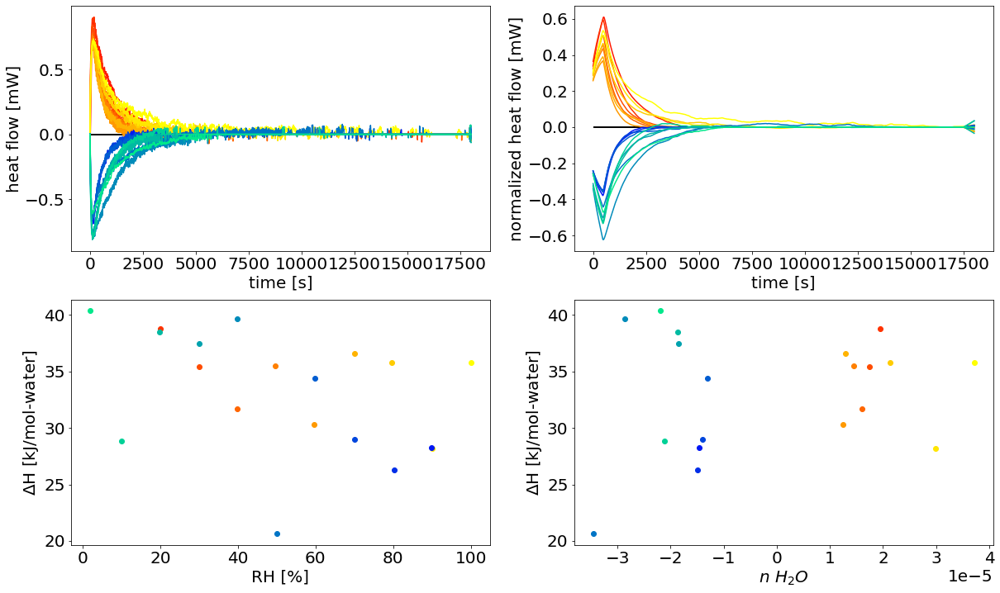

In [162]:
YT1_22C_longtime.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

C:\Users\yunti\AppData\Local\Temp/ipykernel_34328/3837022821.py:810: RuntimeWarning: overflow encountered in exp
  return a1_*np.exp(-x/tau1_)+a2_*np.exp(-x/tau2_)


Fitted Parameters are
[[  -1.30641624    1.04245996   56.92056047  973.54169931]
 [  -1.20518802    1.13194323   42.16973976  725.42514039]
 [  -1.08049904    1.02482831   38.15230915  646.20974257]
 [  -1.04913122    1.01363692   42.74527392  559.58607531]
 [  -0.98290735    0.95590482   38.82233995  566.74562107]
 [  -0.95156167    0.95149324   40.04833564  446.03757727]
 [  -0.9036716     0.89049814   37.95443971  541.60957233]
 [  -0.83975512    0.76568861   31.62147891  944.6948814 ]
 [  -0.87104256    0.81236563   39.16044463 1049.2831037 ]
 [  -0.81778985    0.71265643   28.14764404 1571.0615691 ]
 [  -0.96452285    0.99406917  477.4446412    49.78782453]
 [  -0.86243011    0.92449332  495.83186927   41.95606642]
 [  -0.86617339    0.92759681  500.4807743    39.88566678]
 [  -0.80007179    0.88185602  547.40948916   31.59280489]
 [  -0.64150702    0.75374648 1281.43003838   23.62309383]
 [  -0.91530551    0.91776179 1306.34855312   45.743887  ]
 [  -0.91530994    0.99437452  776

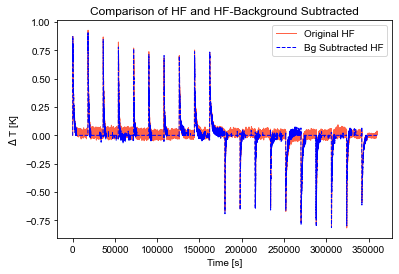

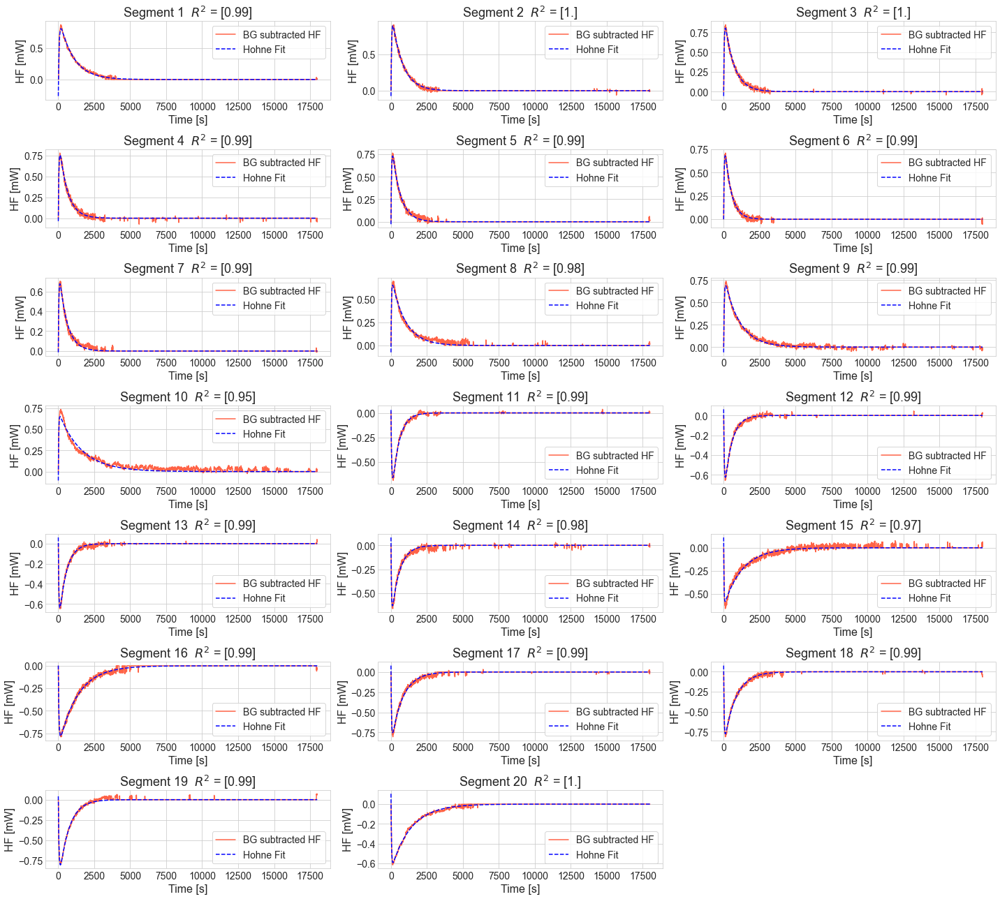

In [163]:
YT1_22C_longtime.hohne_fitting()

### Hohne Fitting

#### Mass

Fitted Parameters are
[[ -1.44277943   1.21815015  72.23474062 369.22300675]
 [ -1.4905779    1.35469485  37.1721421  328.82069819]
 [ -1.24791111   1.17896309  34.09971712 310.40259166]
 [ -1.22786632   1.16879466  34.16240014 272.65530224]
 [ -1.06889067   1.00972381  31.97850934 284.02802421]
 [ -1.09950681   1.01104103  30.65273605 244.82923319]
 [ -1.06126178   1.02276399  34.55963617 226.14616022]
 [ -0.90202751   0.85047774  30.53297418 336.69453519]
 [ -0.88564495   0.82518737  32.06524489 388.74304119]
 [ -0.98726424   0.92840119  38.31227403 322.2823437 ]
 [ -1.84722466   1.89251137 145.72544766  58.26300018]
 [ -0.96115152   1.02997006 243.64222718  36.33999692]
 [ -1.03932536   1.0630589  223.06336162  38.51388691]
 [ -0.99283048   1.05290372 202.70688233  32.05717409]
 [ -0.84432345   0.93493692 327.25001655  26.27777599]
 [ -1.07266104   1.0867347  448.15817942  45.36027434]
 [ -1.33067654   1.32232294 261.53790636  51.21208672]
 [ -1.0149727    1.11207109 469.09955946  2

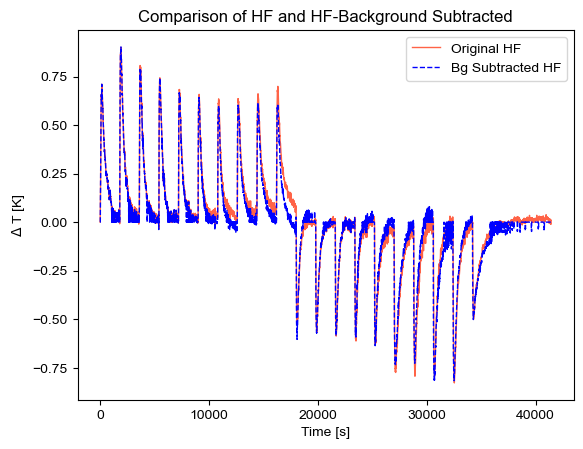

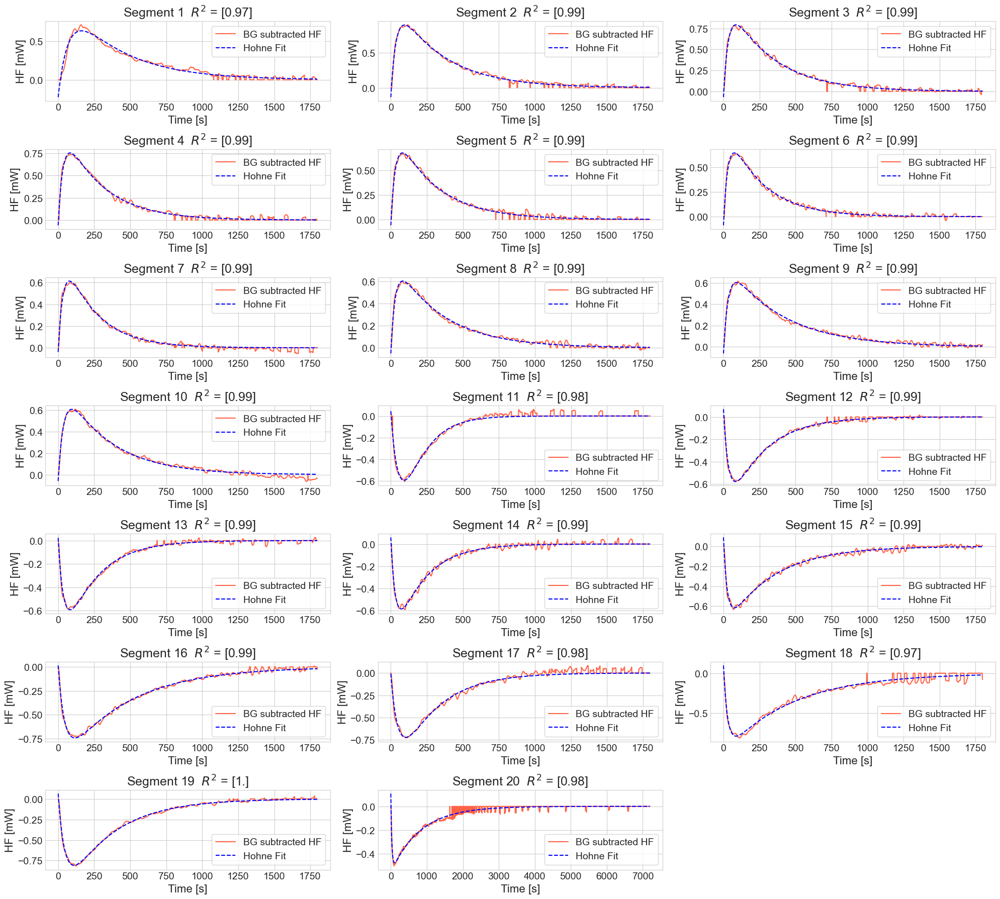

In [84]:
chgc_mass_10mg.hohne_fitting(save=True, p_0 = [-2,2,20,50], save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_10mg_hohne_fitting.png')

Fitted Parameters are
[[  -1.2579148     0.97255331   64.33089292  608.79470048]
 [  -1.40693039    1.26024516   38.04818818  475.49001445]
 [  -1.22006017    1.12359183   34.7564059   447.33776692]
 [  -1.19444565    1.13352084   35.262749    372.2427347 ]
 [  -1.23784199    1.19831005   43.84611047  313.62194673]
 [  -1.18299401    1.12305191   39.26672159  289.25672444]
 [  -0.91540068    0.8427612    27.73383812  474.8342015 ]
 [  -1.14043886    1.13614564   47.63701849  301.22223972]
 [  -0.96832046    0.8736293    35.64562842  523.48018913]
 [  -1.09897641    1.04321482   44.63450455  410.27047254]
 [ 227.46894837 -227.4274114    99.40720272  100.19661124]
 [   1.06889652   -0.97439296   35.60105648  337.5713215 ]
 [   1.06168336   -0.98283343   33.55417527  343.68639059]
 [   0.99525142   -0.90918528   29.24303403  382.8445934 ]
 [   1.04900478   -0.95883492   34.25036018  386.10837899]
 [   1.29422423   -1.33242287   66.59869372  444.59244789]
 [   1.10422491   -1.03255789   34

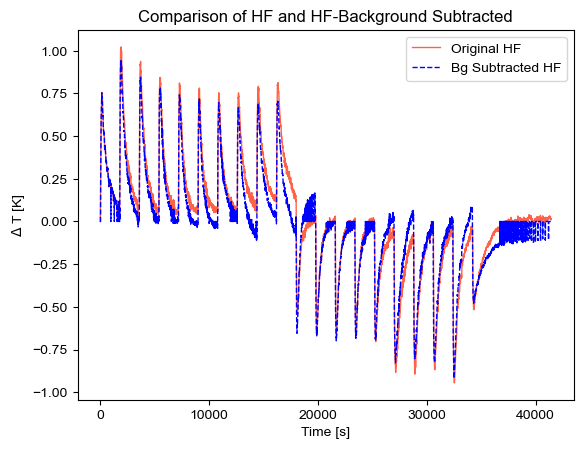

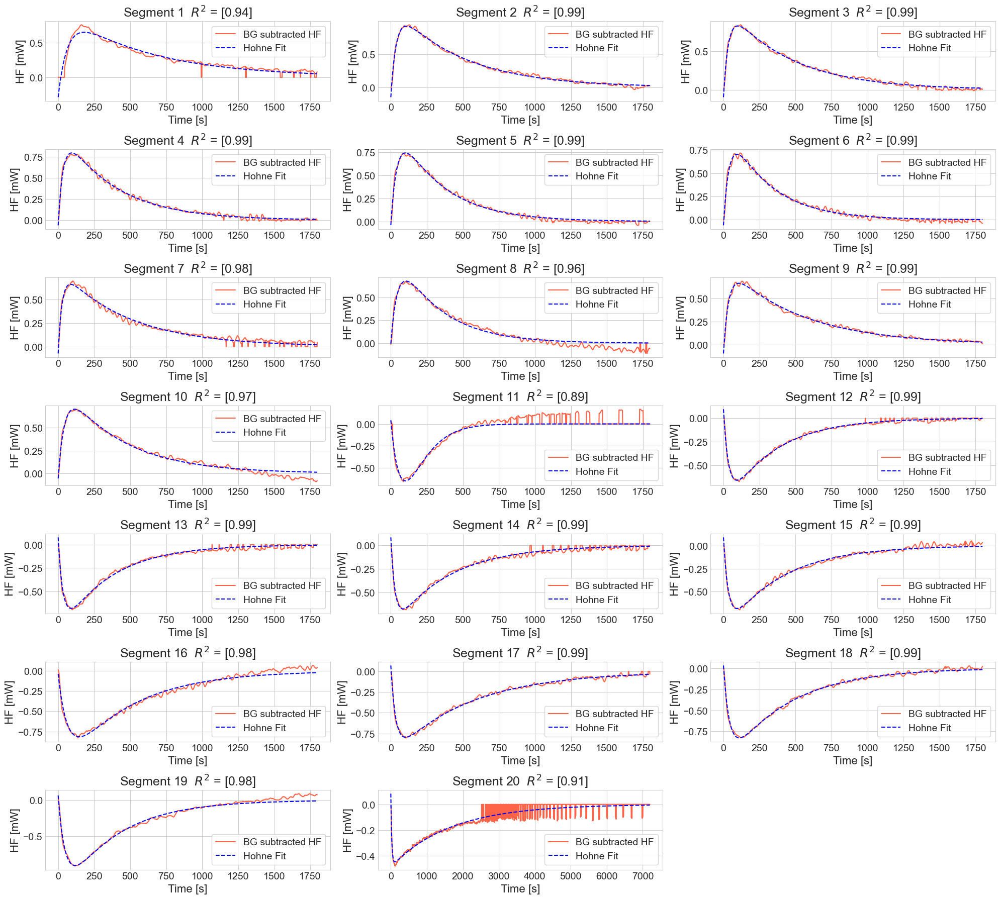

In [86]:
chgc_mass_15mg.hohne_fitting(save=True, p_0 = [5,10,50,200], max_fev = 5000, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_15mg_hohne_fitting.png')

Fitted Parameters are
[[  -1.43518182    1.09466547   56.2994787   740.83257352]
 [  -1.63586222    1.56457228   45.76686298  492.65723446]
 [  -1.71644508    1.70419623   45.289711    339.93946177]
 [  -1.24031205    1.20469547   33.00549171  624.60137799]
 [-227.82813771  227.93060597  119.85190599  121.14942202]
 [  -1.0772731     0.96933313   20.3159054   970.84272044]
 [  -1.42013013    1.38336173   44.96329024  313.47443473]
 [  -1.20180292    1.11298409   33.79653073  592.20854769]
 [  -1.36222766    1.3618954    49.86645477  403.7032886 ]
 [  -1.22018872    1.13050065   38.41419869  588.54420501]
 [-144.19215917  144.26569664  117.00417757  115.07940438]
 [  -1.29154298    1.37350457  347.35509933   41.79479552]
 [  -1.20450314    1.3096736   341.75325712   37.01529274]
 [  -1.23091862    1.2945483   328.09928384   36.98907648]
 [  -1.21168983    1.31088013  371.92036878   34.83976411]
 [  -1.40024271    1.39252814  606.41987614   50.83794695]
 [  -1.31925392    1.33377551  594

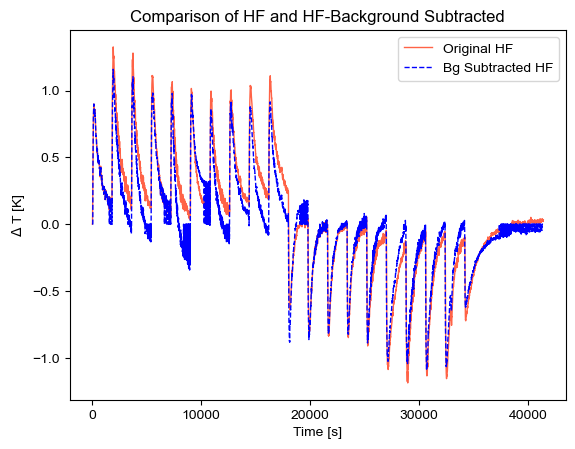

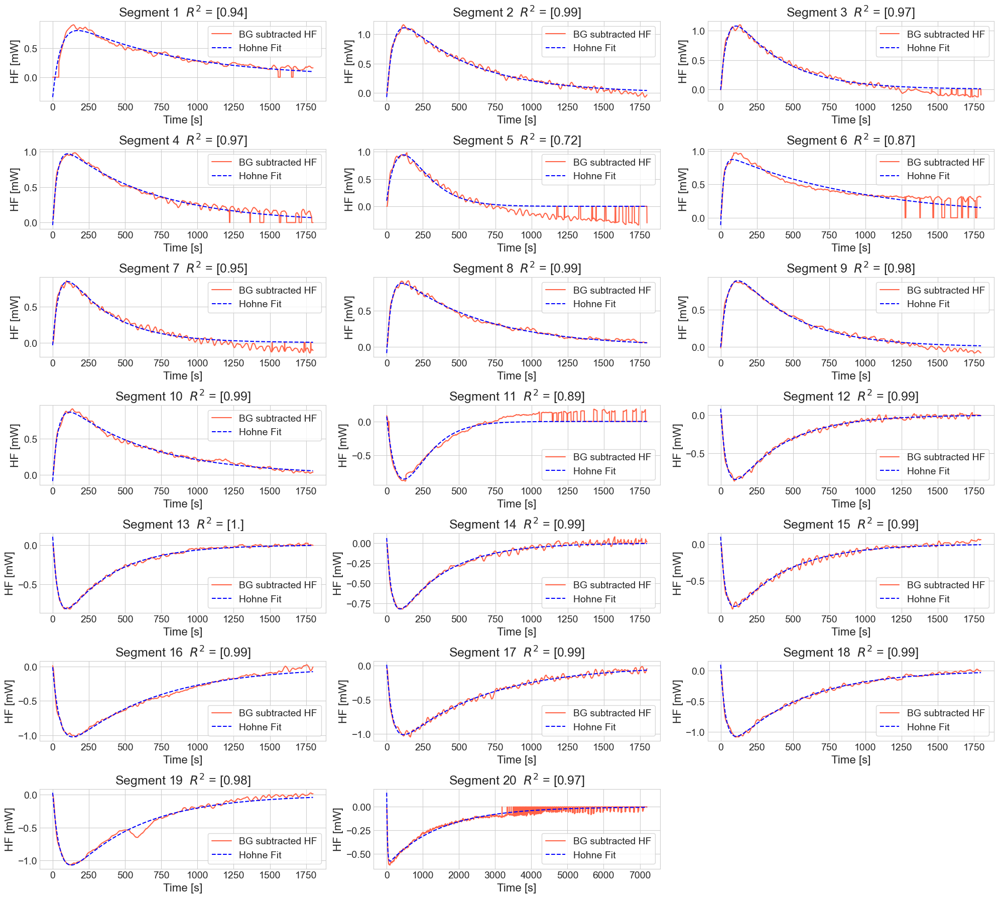

In [87]:
chgc_mass_20mg.hohne_fitting(save=True, p_0 = [-0.1, 0.1, 5,10],max_fev = 5000, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_20mg_hohne_fitting.png')

Fitted Parameters are
[[  -1.27595242    0.95632973   62.59262619  895.16215955]
 [  -1.61188317    1.49209807   49.47239024  460.23618674]
 [  -1.31733485    1.20853745   34.75035949  562.14794229]
 [  -1.39115881    1.3844571    53.03865875  367.07639287]
 [  -1.1620169     1.07773687   36.5395567   608.30003059]
 [  -1.28755913    1.26876321   50.20064083  347.35919272]
 [  -1.07280969    0.96513599   32.91952754  551.24893707]
 [  -1.513873      1.56612696   73.79742021  305.96495397]
 [  -1.09387003    1.03825747   47.24914814  534.93618834]
 [  -0.99808049    0.90208158   35.4548226   826.32256442]
 [  -2.46354696    2.54696354  182.76778951   76.83610758]
 [  -1.04787272    1.13211698  395.45135721   41.91808145]
 [  -1.01507178    1.10645899  444.83934935   37.23304656]
 [  -1.19631596    1.27250729  353.66022938   44.89753728]
 [  -1.04960124    1.17097724  439.42283083   37.97925814]
 [  -1.24506804    1.26223385  589.12801563   58.29343162]
 [  -1.31469159    1.32077529  507

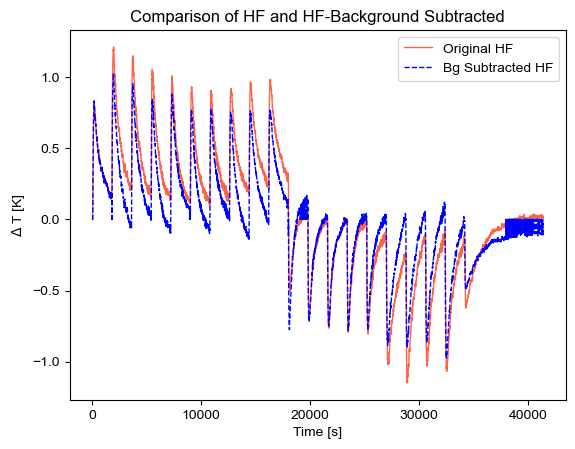

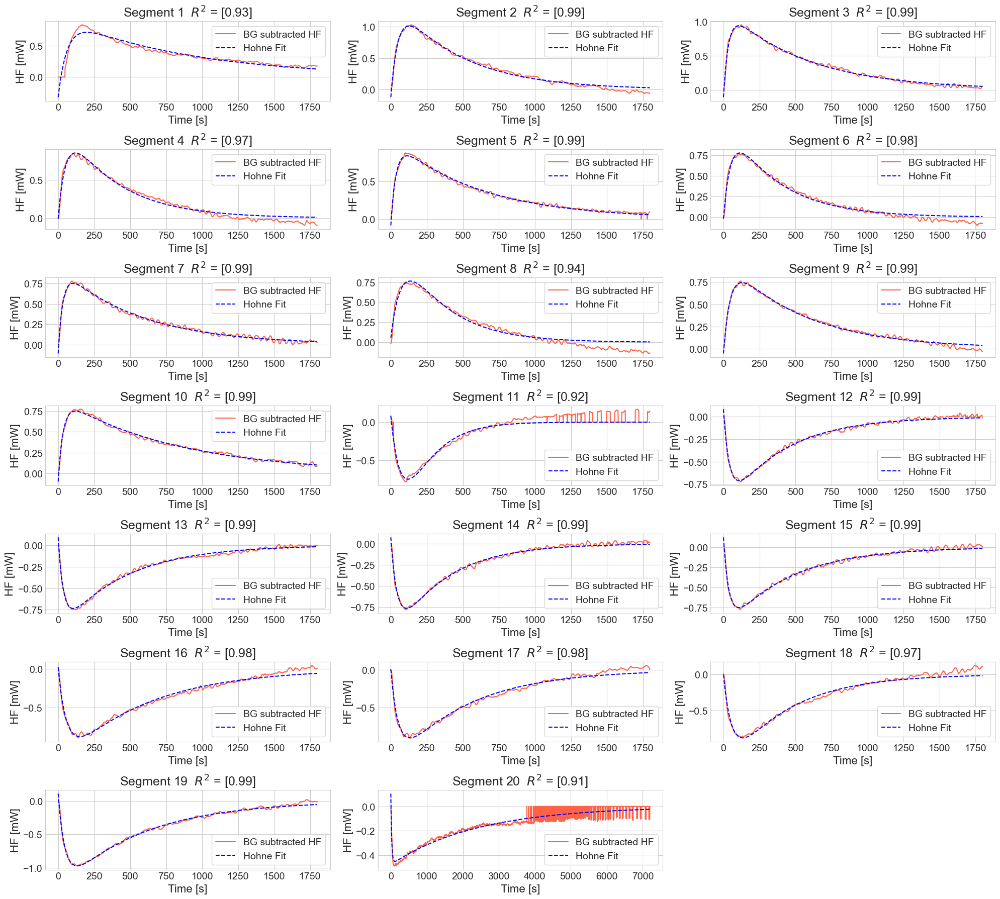

In [88]:
chgc_mass_25mg.hohne_fitting(save=True, p_0 = [-0.1, 0.1, 5,10],max_fev=5000, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_25mg_hohne_fitting.png')

C:\Users\yunti\AppData\Local\Temp\ipykernel_11428\2646618165.py:858: RuntimeWarning: overflow encountered in exp
  return a1_*np.exp(-x/tau1_)+a2_*np.exp(-x/tau2_)
d:\Anaconda\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Fitted Parameters are
[[   0.66072141   -0.66072141 1825.22976224    0.042049  ]
 [   1.46520966   -1.63903319  519.43630376   45.86476789]
 [   1.3479065    -1.4493996   514.01303033   42.73849502]
 [   1.14695445   -1.21957489  723.9666461    37.28468526]
 [   1.3469093    -1.35562615  442.76892911   53.69431393]
 [   1.00437148   -1.10683158  644.50129104   32.91182864]
 [   1.11622222   -1.18832857  441.06669582   43.59112445]
 [   1.07272626   -1.13799653  469.52530296   44.86090663]
 [   1.03035358   -1.11821321  668.7080101    45.19015073]
 [   1.11553448   -1.16934741  534.64088581   53.77169894]
 [  -1.64546718    1.74189267  253.34715541   64.36455322]
 [  -1.21503243    1.29333794  373.34853744   52.93730585]
 [  -1.0318549     1.13044144  517.73975128   38.5674785 ]
 [  -1.17443508    1.26446246  377.78053097   46.84538656]
 [  -1.12217716    1.22087542  447.62977748   42.14108675]
 [  -1.48400494    1.49449721  489.5950771    74.00577653]
 [  -1.37567889    1.38132733  511

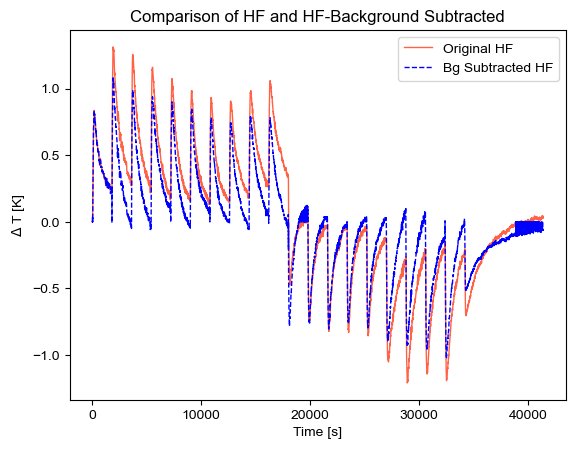

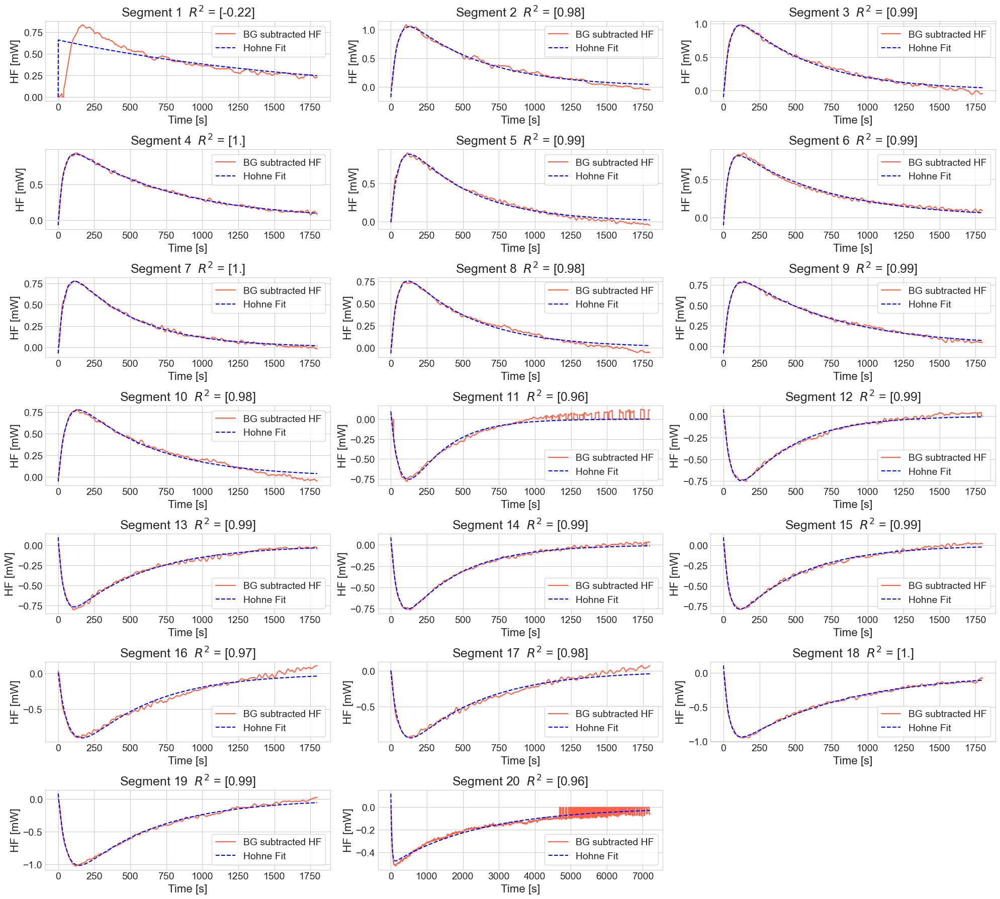

In [89]:
chgc_mass_30mg.hohne_fitting(save=True, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_30mg_hohne_fitting.png')

In [90]:
np.savetxt(notebook_folder+'\YT1_mass_study_method\chgc_mass_10mg_hohne_parameters.csv',np.array(chgc_mass_10mg.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_mass_study_method\chgc_mass_15mg_hohne_parameters.csv',np.array(chgc_mass_15mg.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_mass_study_method\chgc_mass_20mg_hohne_parameters.csv',np.array(chgc_mass_20mg.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_mass_study_method\chgc_mass_25mg_hohne_parameters.csv',np.array(chgc_mass_25mg.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_mass_study_method\chgc_mass_30mg_hohne_parameters.csv',np.array(chgc_mass_30mg.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')

#### Density

Fitted Parameters are
[[ -1.66143723   1.40695511  81.85753052 377.04614238]
 [ -1.87779239   1.69631192  43.16949988 362.66813903]
 [ -1.68322153   1.64632153  43.97399809 275.87609705]
 [ -1.46088104   1.38045049  34.08980586 318.33372415]
 [ -1.50219542   1.44465253  40.66739541 260.26563755]
 [ -1.55896299   1.56082396  47.5723819  197.80176528]
 [ -1.37517773   1.33243593  40.37554219 226.08012173]
 [ -1.11553543   1.052056    33.98175576 389.27143001]
 [ -1.18736496   1.14525891  43.4083947  459.6559718 ]
 [ -1.1762934    1.13610739  42.67241409 462.9219146 ]
 [ -3.43681201   3.43873751 136.01701225  77.65208689]
 [ -1.06320866   1.16183449 297.35590888  34.11796952]
 [ -1.27558086   1.32218005 234.94221328  43.78788857]
 [ -1.20085397   1.27042163 226.24573061  35.7984564 ]
 [ -1.05290181   1.1024669  431.63279861  33.07963737]
 [ -1.26918404   1.23247055 760.12503588  50.75609065]
 [ -1.29454933   1.35313912 384.97063452  35.77036861]
 [ -1.38453884   1.47744492 363.57207909  3

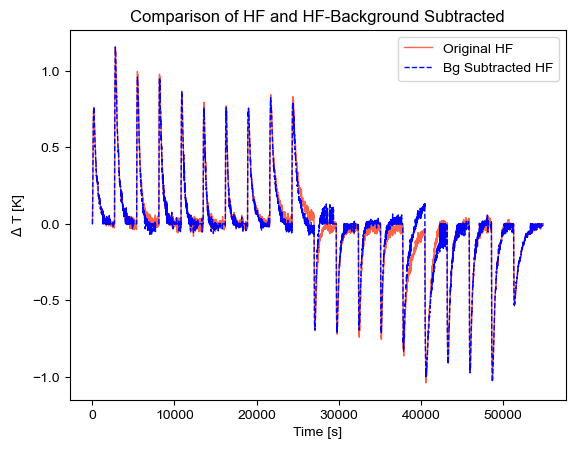

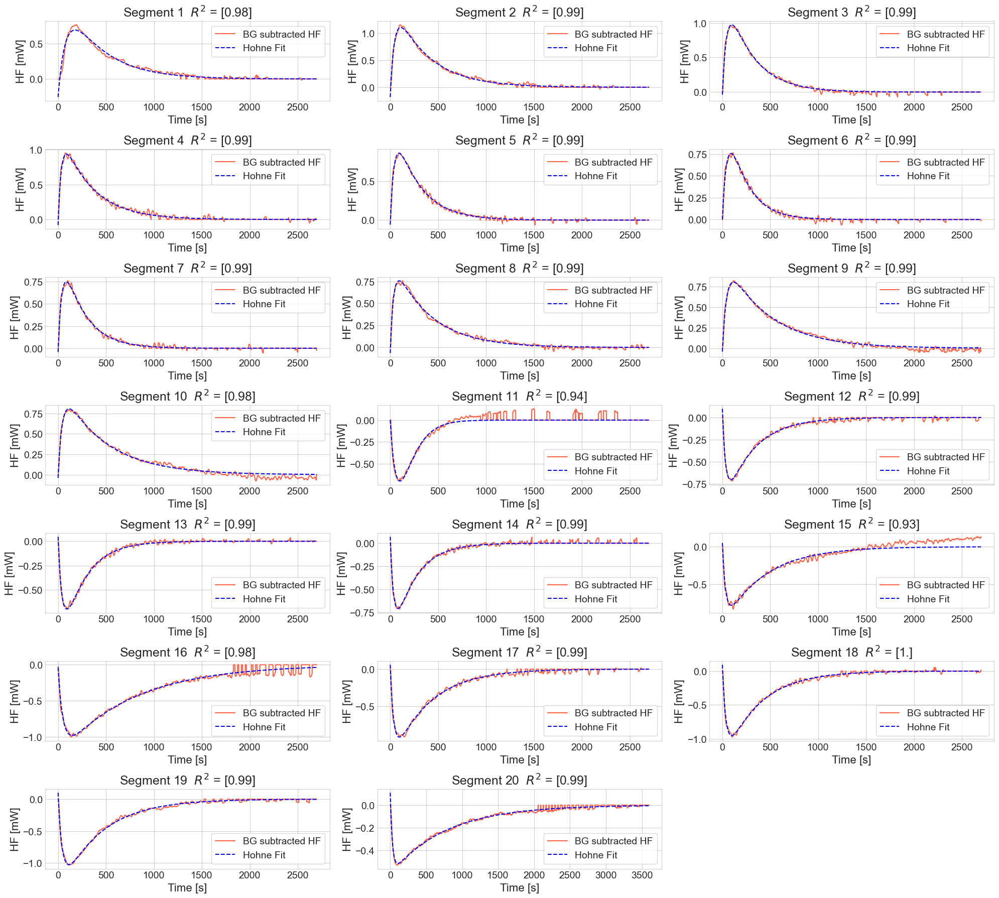

In [102]:
chgc_0T_new.hohne_fitting(save=True, p_0 = [-2,2,20,50], save_path=notebook_folder+'\YT1_density_study_method\chgc_0T_new_hohne_fitting.png')

Fitted Parameters are
[[ -1.33326071   1.07092022  68.65195311 507.9676217 ]
 [ -1.42575866   1.26167715  34.18588903 464.4324971 ]
 [ -1.34720247   1.23077332  35.60484239 359.79433067]
 [ -1.21139868   1.11193838  29.89068854 401.09426192]
 [ -1.2118183    1.14565205  37.01749535 341.55604905]
 [ -1.05033335   1.02421448  32.65333246 329.98857656]
 [ -1.06420339   0.9928518   34.96016869 307.56802983]
 [ -0.93895622   0.85836073  28.88562638 525.3992053 ]
 [ -1.01118352   0.97045112  41.51380781 523.57806664]
 [ -1.01674235   0.93365959  34.36403566 614.08843451]
 [ -2.00915316   2.04488525 174.67513652  65.6292312 ]
 [ -1.09409606   1.13868563 283.67743895  43.63188233]
 [ -1.05558044   1.10801446 285.88517608  39.3495226 ]
 [ -0.99105312   1.07014605 280.89882576  32.57830944]
 [ -0.92056862   0.99445961 463.13235255  30.94299127]
 [ -1.10745693   1.12200005 762.15694331  46.4322557 ]
 [ -1.13813145   1.17738488 391.0183342   41.71897907]
 [ -1.18211625   1.27206851 391.67601809  3

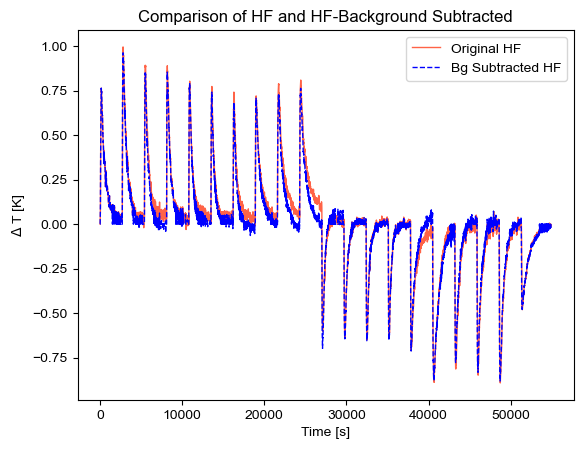

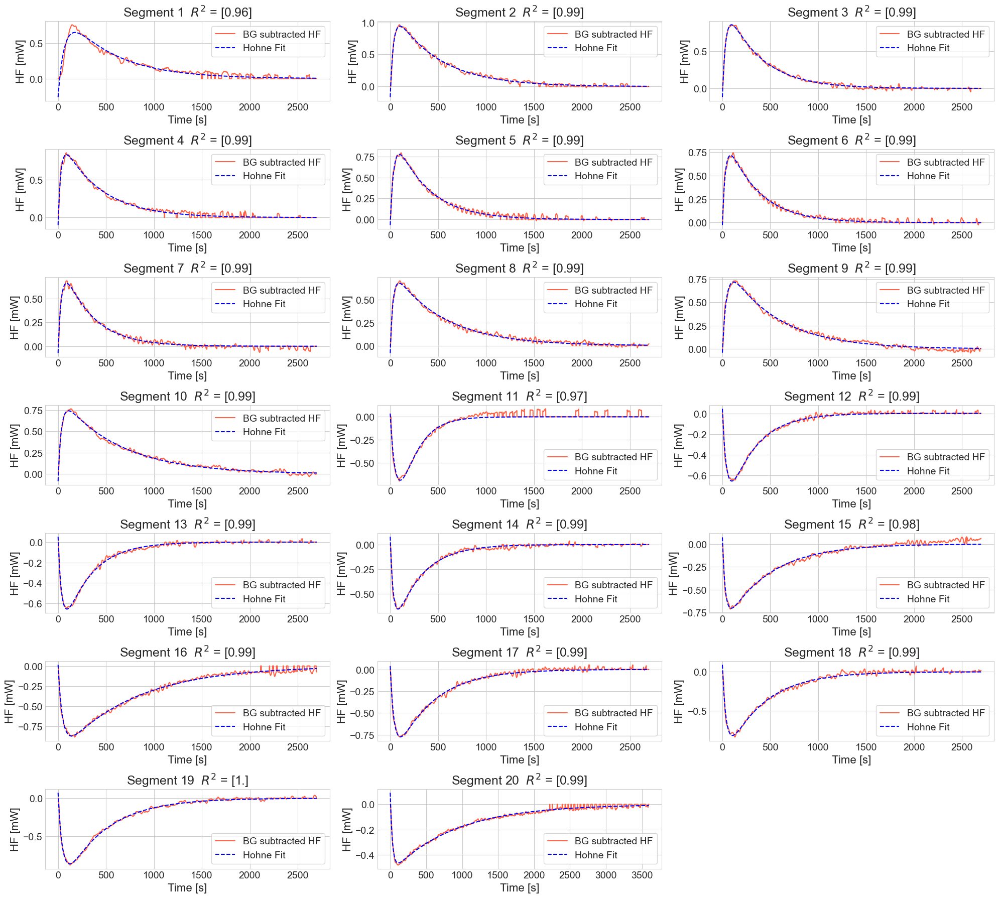

In [103]:
chgc_0point5T_new.hohne_fitting(save=True, p_0 = [-2,2,20,50], save_path=notebook_folder+'\YT1_density_study_method\chgc_0point5T_new_hohne_fitting.png')

Fitted Parameters are
[[ -1.07280822   0.88406066  68.8488845  567.88554209]
 [ -1.40515783   1.28038065  39.29702851 462.62469275]
 [ -1.2606002    1.20688929  37.08533369 389.99608888]
 [ -1.20968824   1.15239465  33.94665139 357.44887202]
 [ -1.257818     1.2214401   45.37121264 291.87873405]
 [ -1.0379558    0.96984568  29.66763914 371.34837832]
 [ -1.04740928   0.95922725  30.4222106  351.12177664]
 [ -0.95182262   0.90624885  32.20598791 472.77541167]
 [ -0.9259879    0.84881606  29.64043684 649.4908571 ]
 [ -1.01609963   0.99705648  42.94967334 425.3772233 ]
 [ -2.86181398   2.84897183 148.95610562  78.47493017]
 [ -1.0490035    1.10495337 284.11241451  39.95171551]
 [ -1.03023872   1.09077805 287.52539689  35.95346551]
 [ -0.99266184   1.05173614 282.61387189  31.98965067]
 [ -0.83143611   0.94380615 576.77793657  24.57203236]
 [ -1.15657078   1.10806435 592.27197955  57.34490422]
 [ -1.07857189   1.15852668 513.32012377  32.7428612 ]
 [ -1.12221822   1.2079128  473.80171111  3

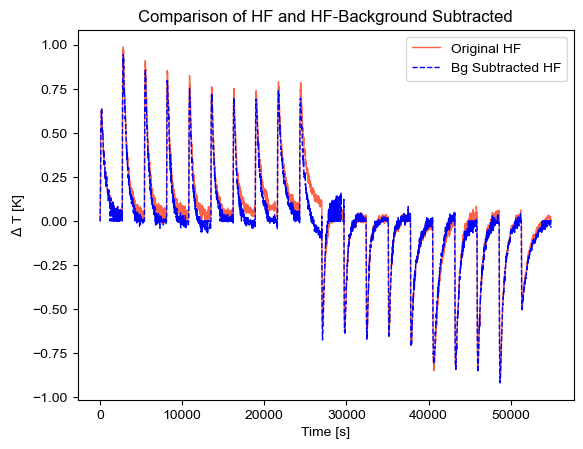

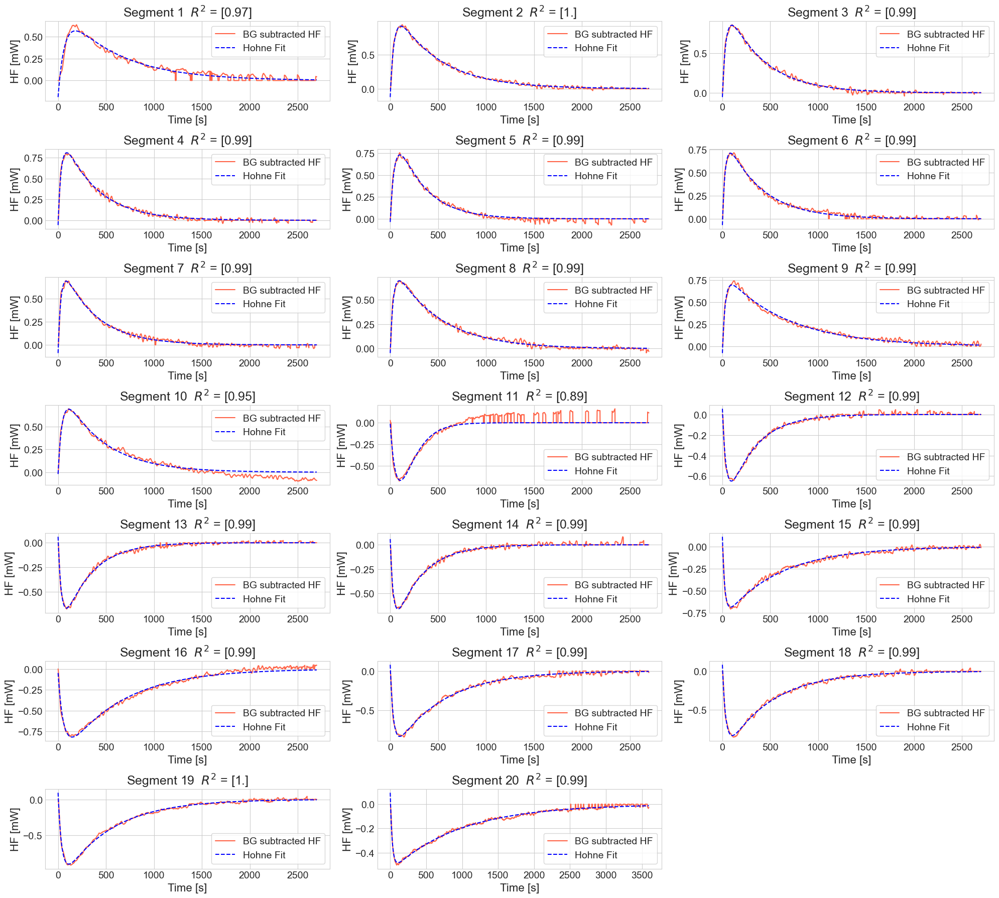

In [104]:
chgc_1T_new.hohne_fitting(save=True, p_0 = [-2,2,20,50], save_path=notebook_folder+'\YT1_density_study_method\chgc_1T_new_hohne_fitting.png')

Fitted Parameters are
[[ -1.50379884   1.19818453  67.34276111 492.72538363]
 [ -1.67640037   1.5831333   47.83162611 321.56241289]
 [ -1.31829916   1.23454755  35.29172375 375.67768051]
 [ -1.21025073   1.16787436  36.86259355 339.32287978]
 [ -1.1684523    1.08739899  34.48657722 358.64814087]
 [ -1.14820422   1.09539401  35.33971573 304.58599446]
 [ -1.08410356   1.02338726  35.21167554 320.33017945]
 [ -1.17920743   1.1386465   47.06745283 314.6400701 ]
 [ -0.9364322    0.85120523  28.9098102  619.95602894]
 [ -0.96430983   0.87437224  28.94340116 589.93560144]
 [ -1.53890042   1.55839688 201.39191919  55.05135773]
 [ -1.10182359   1.15997389 279.9079658   43.75578635]
 [ -1.11935034   1.17946631 275.9358039   37.43930576]
 [ -0.88846163   1.00007775 359.91427173  26.21124337]
 [ -0.91135878   0.99085431 426.22318922  29.5096725 ]
 [ -1.09661072   1.09553615 761.827307    44.57024995]
 [ -1.17574782   1.23342859 403.67032408  40.7063133 ]
 [ -1.18225655   1.26300013 440.02646541  3

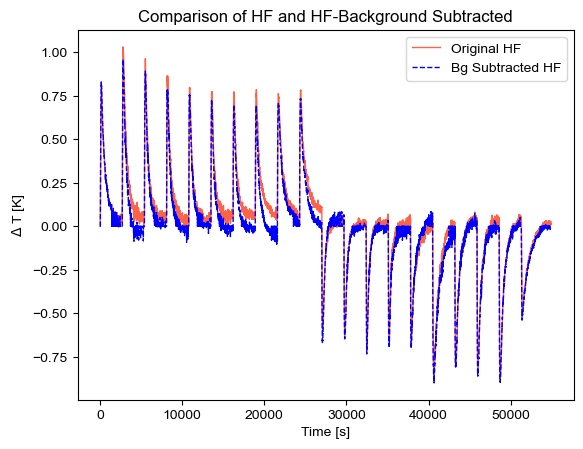

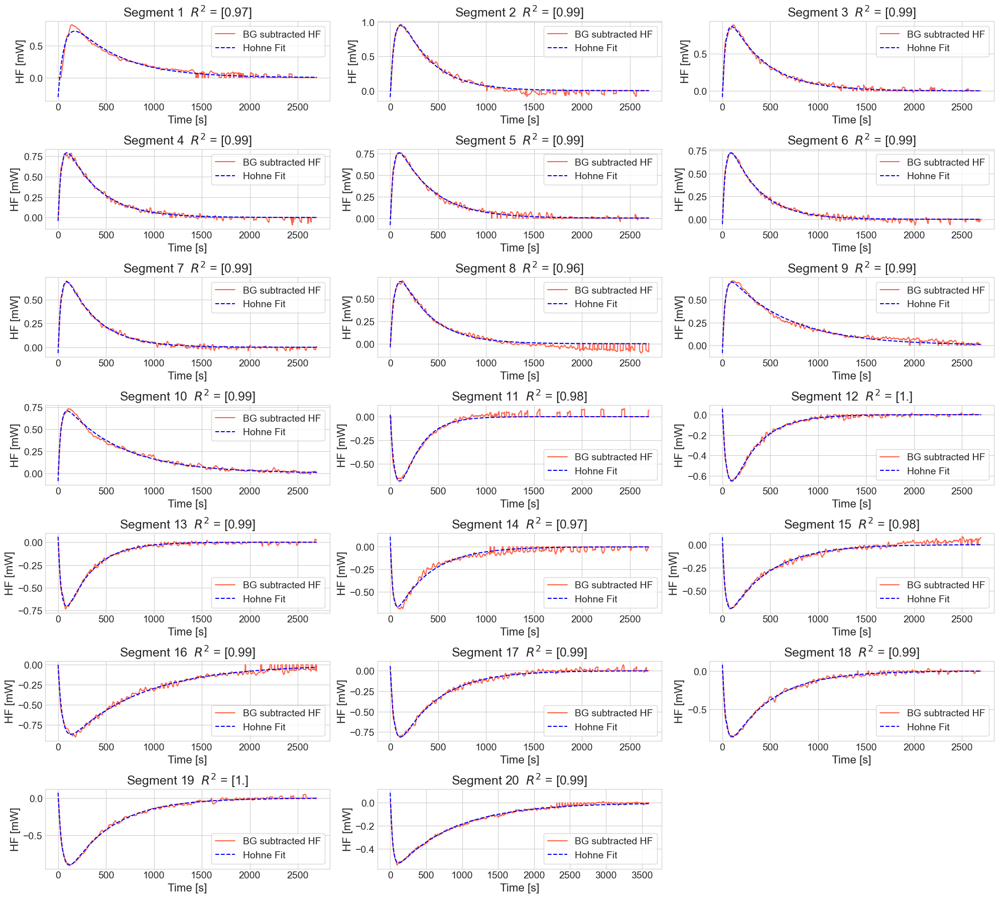

In [105]:
chgc_1point5T_new.hohne_fitting(save=True, p_0 = [-2,2,20,50], save_path=notebook_folder+'\YT1_density_study_method\chgc_1point5T_new_hohne_fitting.png')

Fitted Parameters are
[[  -1.06576402    0.85491751   67.23959274  563.93610142]
 [  -1.4128391     1.2727641    38.80699151  417.39545165]
 [  -1.26325283    1.24091826   44.54040465  339.86730876]
 [  -1.16252978    1.07618876   29.79184394  399.92752527]
 [  -1.16848073    1.11625901   38.60866293  312.43565593]
 [  -1.05996456    0.98963516   31.40148029  324.99222966]
 [  -1.00072158    0.95062779   34.71418556  330.8297864 ]
 [  -0.87166474    0.8322987    29.62847101  501.94087359]
 [  -0.96126142    0.90963777   36.42563142  456.60074491]
 [  -1.07362945    1.02794818   43.73291681  357.23084374]
 [ 146.0980777  -146.09441644  104.08285125  105.39198348]
 [   1.11853475   -1.05927756   44.2530161   292.06070069]
 [   1.02259439   -0.95818309   33.38016734  316.0160941 ]
 [   1.02157835   -0.96543292   33.49985075  279.45258234]
 [  -0.8425132     0.93633354  448.18825774   28.07269584]
 [  -1.03523368    1.04360693  632.43549592   45.80360551]
 [  -1.04874628    1.10692877  502

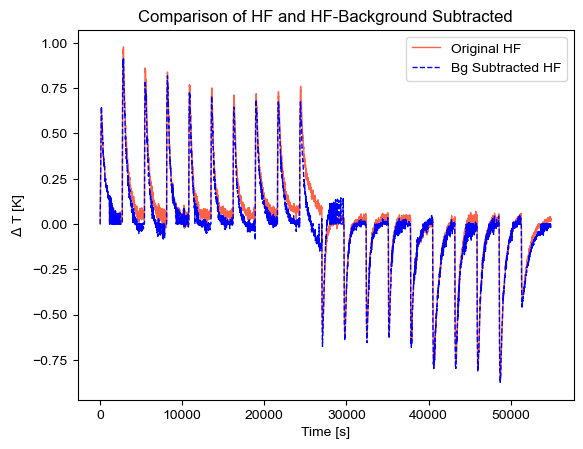

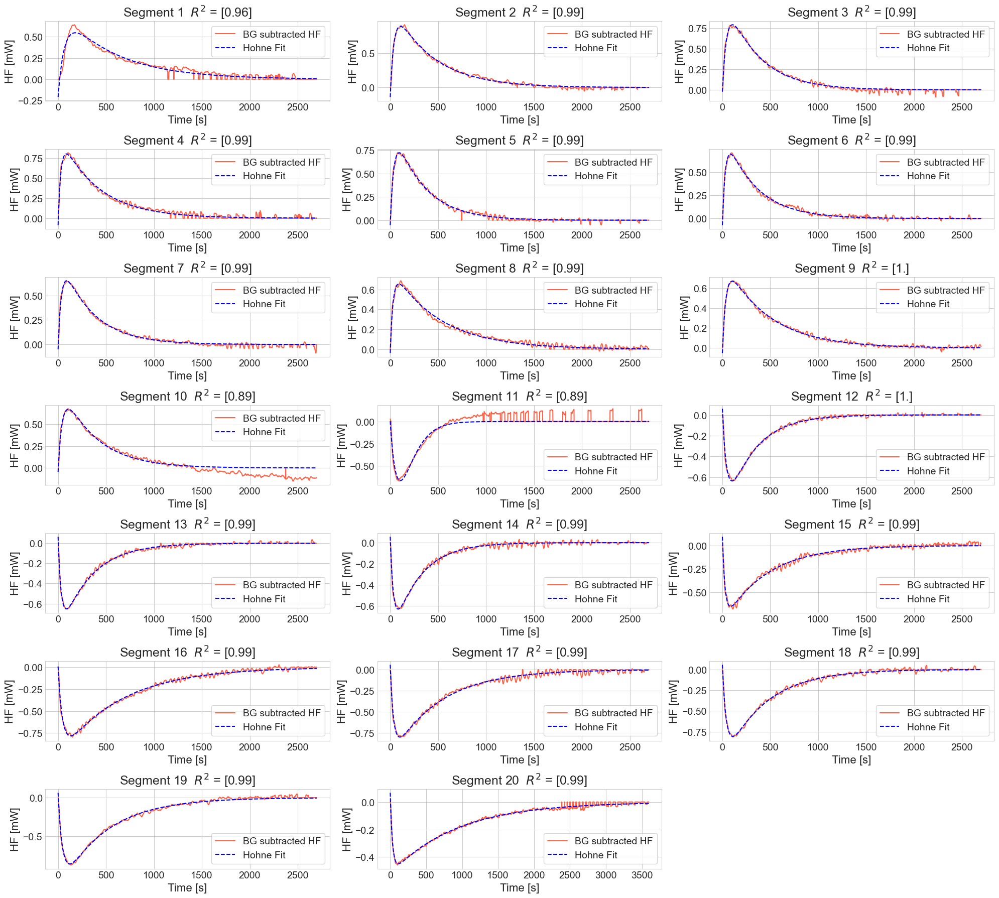

In [109]:
chgc_2T_new.hohne_fitting(save=True, p_0 = [-1,1,50,220], max_fev=5000, save_path=notebook_folder+'\YT1_density_study_method\chgc_2T_new_hohne_fitting.png')

Fitted Parameters are
[[ -1.34779408   1.09953938  71.41797266 482.13980078]
 [ -1.44671448   1.26138796  35.83947831 540.66731998]
 [ -1.36200352   1.28632875  41.2579895  373.04705697]
 [ -1.25538557   1.19780628  37.37315424 371.84268404]
 [ -1.16982091   1.10304532  35.17331164 368.29442924]
 [ -1.15261461   1.12738384  38.08781223 290.42979681]
 [ -0.9768411    0.89236912  26.77767583 468.89533245]
 [ -0.95279448   0.87171309  28.83450124 496.75309406]
 [ -0.97933049   0.88751254  32.05931641 521.28899558]
 [ -0.93031474   0.84487151  28.45620328 630.08314665]
 [  1.25011     -1.18915643  43.20408577 273.65511896]
 [  1.20244417  -1.14265257  45.74134899 273.75387292]
 [  1.14444263  -1.08870949  37.66580847 292.33228668]
 [  0.99209187  -0.90601888  27.56514587 347.96363912]
 [ -0.89644426   1.00502324 451.38350695  27.16069898]
 [ -1.10817958   1.11581639 699.64929166  44.21684803]
 [ -1.1581874    1.18140633 469.01224679  40.41434333]
 [ -1.10506758   1.18450817 529.44058191  3

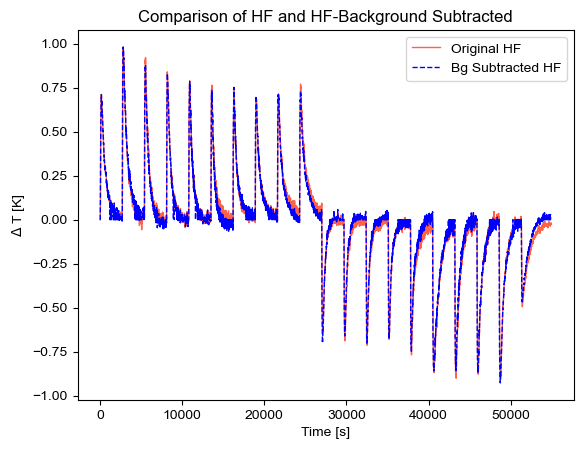

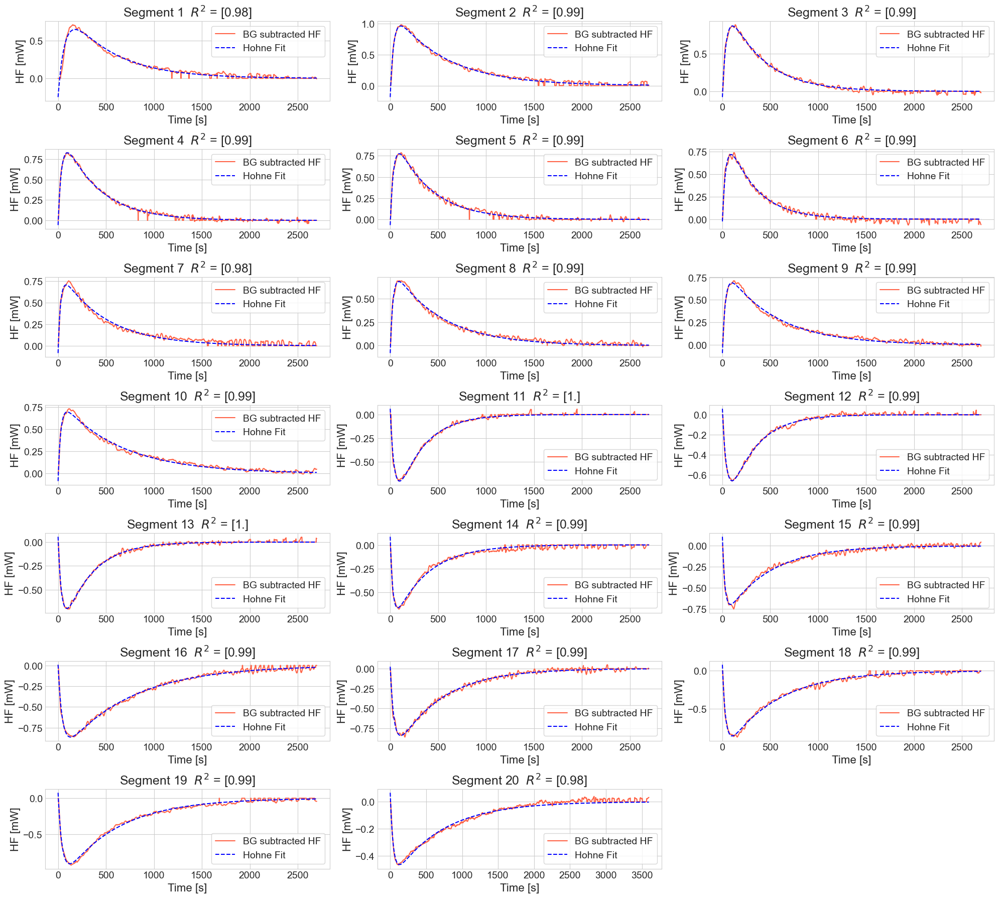

In [111]:
chgc_2point5T_new.hohne_fitting(save=True, p_0 = [-1,1,50,220], save_path=notebook_folder+'\YT1_density_study_method\chgc_2point5T_new_hohne_fitting.png')

Fitted Parameters are
[[ -1.25878242   1.00237252  64.6293958  554.49507581]
 [ -1.42549959   1.2671566   36.10531211 482.60142766]
 [ -1.31456656   1.24583691  37.8328119  397.09438773]
 [ -1.27308353   1.21069099  37.32334322 339.23826993]
 [ -1.19834547   1.13009566  34.70887759 339.79288275]
 [ -1.14297193   1.07114325  32.4013899  324.67481079]
 [ -1.0765162    0.99261141  28.6713374  330.49531435]
 [ -1.10153177   1.03567119  35.67676448 301.16987498]
 [ -0.94942762   0.88710541  30.38544744 430.75817886]
 [ -0.93312839   0.84815038  29.27470738 496.37358538]
 [  1.84630696  -1.8100877   59.07831933 175.66560179]
 [  1.13922184  -1.10908929  40.97524497 280.20409748]
 [  1.11059993  -1.02881115  32.8905879  284.87140454]
 [  1.06359881  -1.00587248  31.17582512 267.30244815]
 [  0.99442416  -0.87922341  23.90597799 415.93410645]
 [  1.09654893  -1.06403939  40.16490754 594.12553113]
 [  1.18521377  -1.13284013  35.52823107 459.49297221]
 [  1.26378053  -1.23513226  41.86237591 41

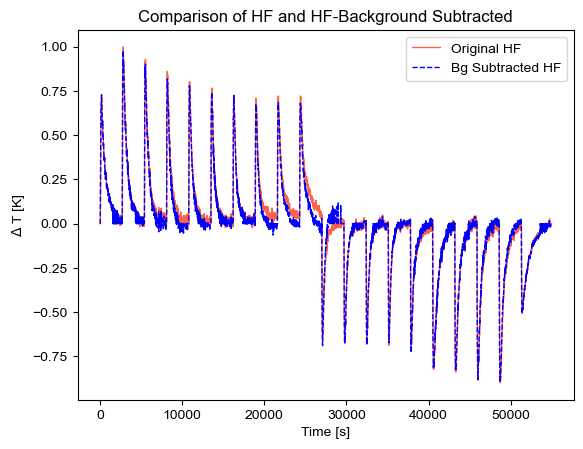

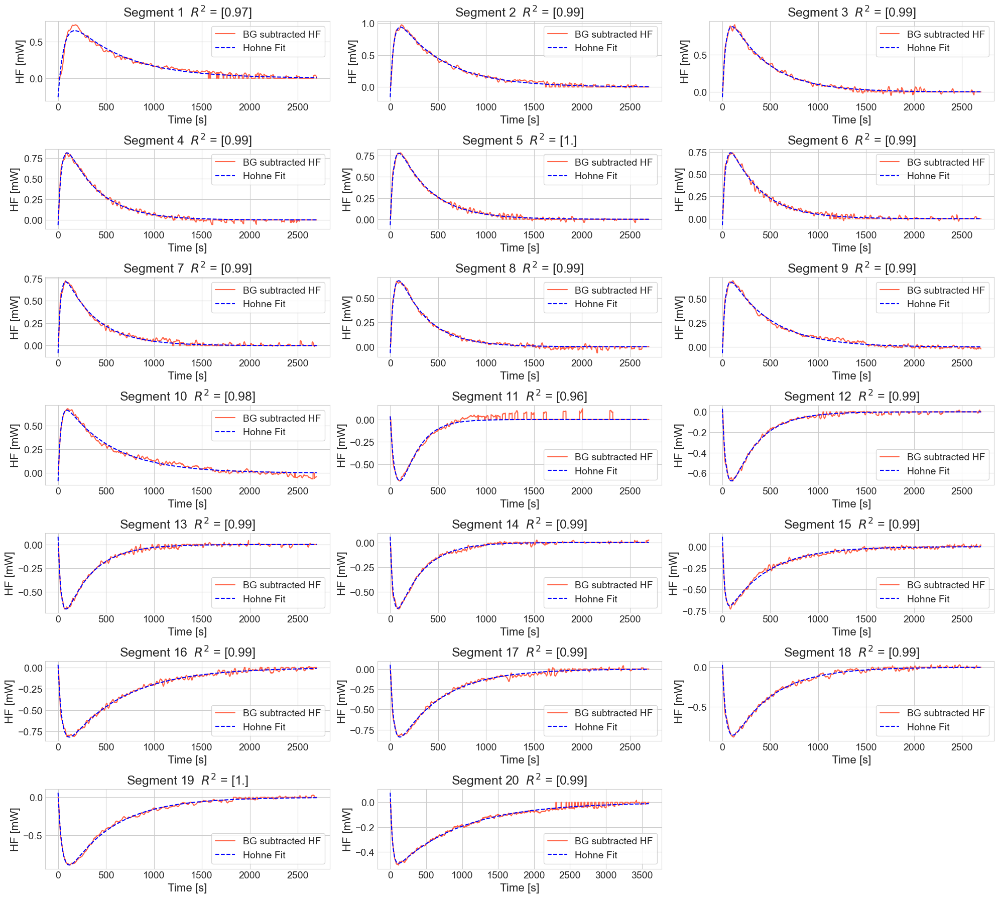

In [114]:
chgc_3T_new.hohne_fitting(save=True, p_0 = [-1,1,50,400], max_fev=5000, save_path=notebook_folder+'\YT1_density_study_method\chgc_3T_new_hohne_fitting.png')

In [115]:
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_0T_new_hohne_parameters.csv',np.array(chgc_0T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_0point5T_new_hohne_parameters.csv',np.array(chgc_0point5T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_1T_new_hohne_parameters.csv',np.array(chgc_1T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_1point5T_new_hohne_parameters.csv',np.array(chgc_1point5T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_2T_new_hohne_parameters.csv',np.array(chgc_2T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_2point5TT_new_hohne_parameters.csv',np.array(chgc_2point5T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')
np.savetxt(notebook_folder+'\YT1_density_study_method\chgc_3T_new_hohne_parameters.csv',np.array(chgc_3T_new.hohne_fitted_params) , delimiter=',', header='a1,a2,tau1,tau2',  fmt='%.2f', comments='')

#### Temperature

Fitted Parameters are
[[  -0.72579228    0.56559154   45.44204253 1130.34559111]
 [  -0.80489309    0.69144144   30.71108344 1006.29126286]
 [  -0.74040405    0.66349153   28.39672877  819.4127514 ]
 [  -0.70622788    0.65669317   28.44357895  738.34767373]
 [  -0.66957048    0.60148702   27.2912478   762.18518274]
 [  -0.68310452    0.66512644   37.81557704  514.63775053]
 [  -0.61673587    0.58681249   32.25025235  489.0301051 ]
 [  -0.5993771     0.53081515   29.03762494  742.82822555]
 [  -0.60024302    0.57016288   32.75442975  956.90241466]
 [  -0.61446665    0.55425087   31.98579921 1234.65603384]
 [   0.79980402   -0.78530974   55.1788282   358.58951287]
 [   0.62577133   -0.57121849   29.14892225  571.69844081]
 [   0.63319135   -0.59117487   30.98539578  593.00100957]
 [   0.65966043   -0.60370029   30.50211795  463.56666473]
 [   0.56104609   -0.49832607   23.25467522 1119.15930898]
 [   0.57510771   -0.62484518   53.0191993  1358.65083862]
 [   0.61066128   -0.55543089   24

C:\Users\yunti\AppData\Local\Temp/ipykernel_31504/1170153915.py:918: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


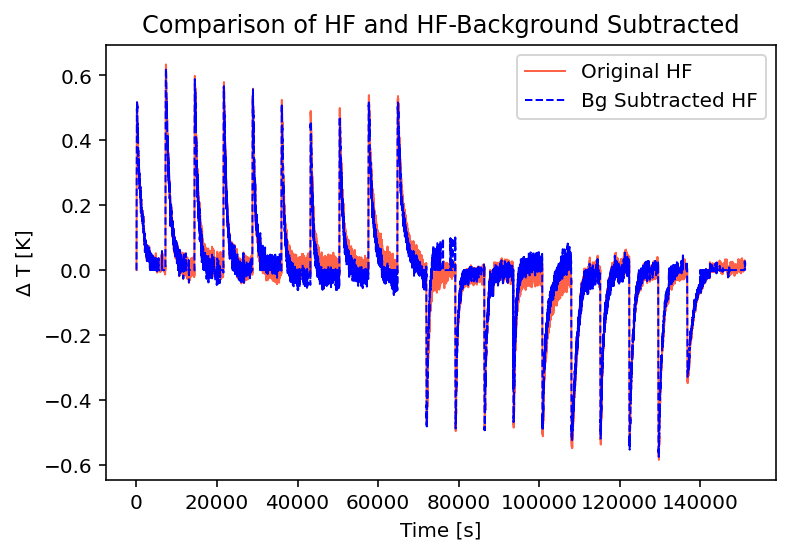

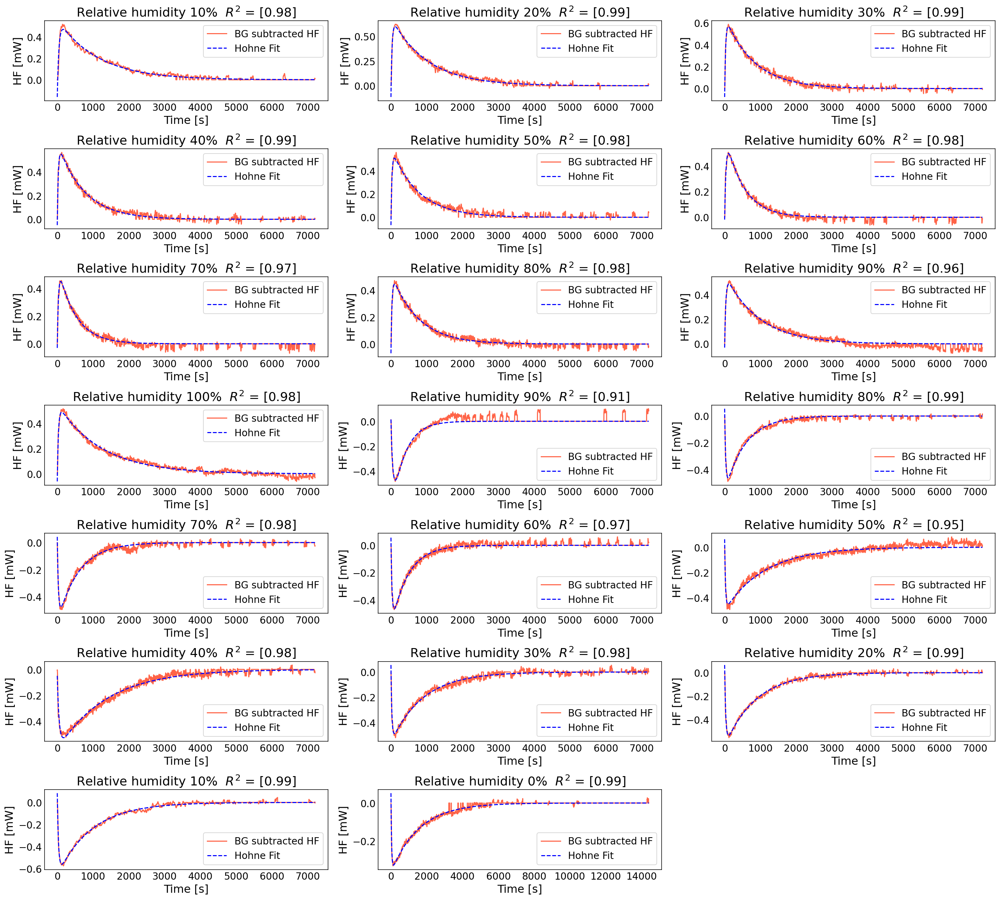

In [101]:
YT1_16C.hohne_fitting(save=True, p_0 = [0,0,40,500], max_fev=1000, save_path=notebook_folder+'\YT1_temperature_study_16C_method\chgc_16C_hohne_fitting.png')

Fitted Parameters are
[[  -1.07250188    0.86219122   61.18837552 1006.30581708]
 [  -1.05375171    0.98780425   41.62501554  871.41116558]
 [  -0.9920369     0.98674345   46.21888144  668.63703809]
 [  -0.94561456    0.91911204   47.72583645  668.14466856]
 [  -0.93854171    0.9301356    51.38643717  529.96283706]
 [  -0.91925347    0.91674033   52.10312508  440.65036569]
 [  -0.86869817    0.83316416   50.16679321  523.44679611]
 [  -0.81817614    0.77376228   47.35745316  928.97495752]
 [  -0.83596843    0.81455536   60.38637901  933.00697786]
 [  -0.44191706    0.34520746   14.91528131 2058.00315007]
 [   2.27244793   -2.20500229  137.94062858  220.08826756]
 [   1.00005097   -0.98392098   66.85325214  437.32153862]
 [   0.86754764   -0.86012242   53.28477346  469.38223888]
 [   0.81274126   -0.75249768   40.15447318  606.44854454]
 [   0.73206531   -0.63304203   25.77655614 1016.71714049]
 [   0.80479813   -0.90057495   79.84035073 1381.79393646]
 [   0.87697938   -0.83716445   39

C:\Users\yunti\AppData\Local\Temp/ipykernel_31504/1170153915.py:918: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


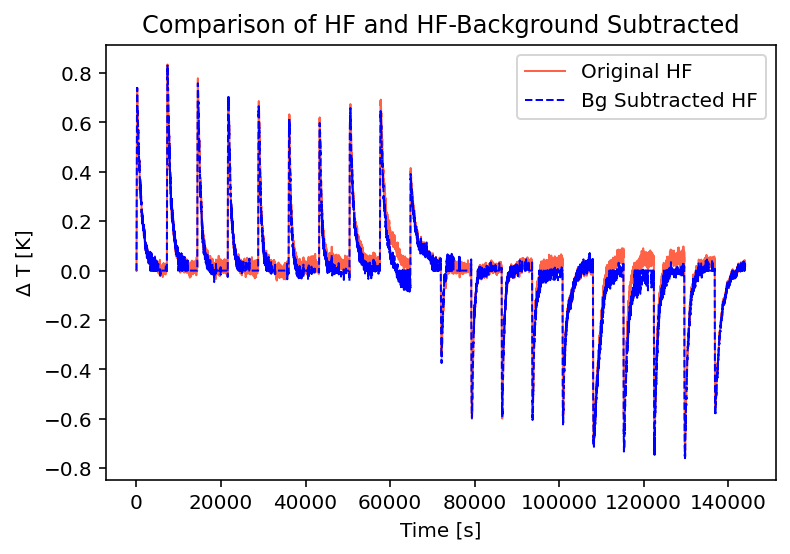

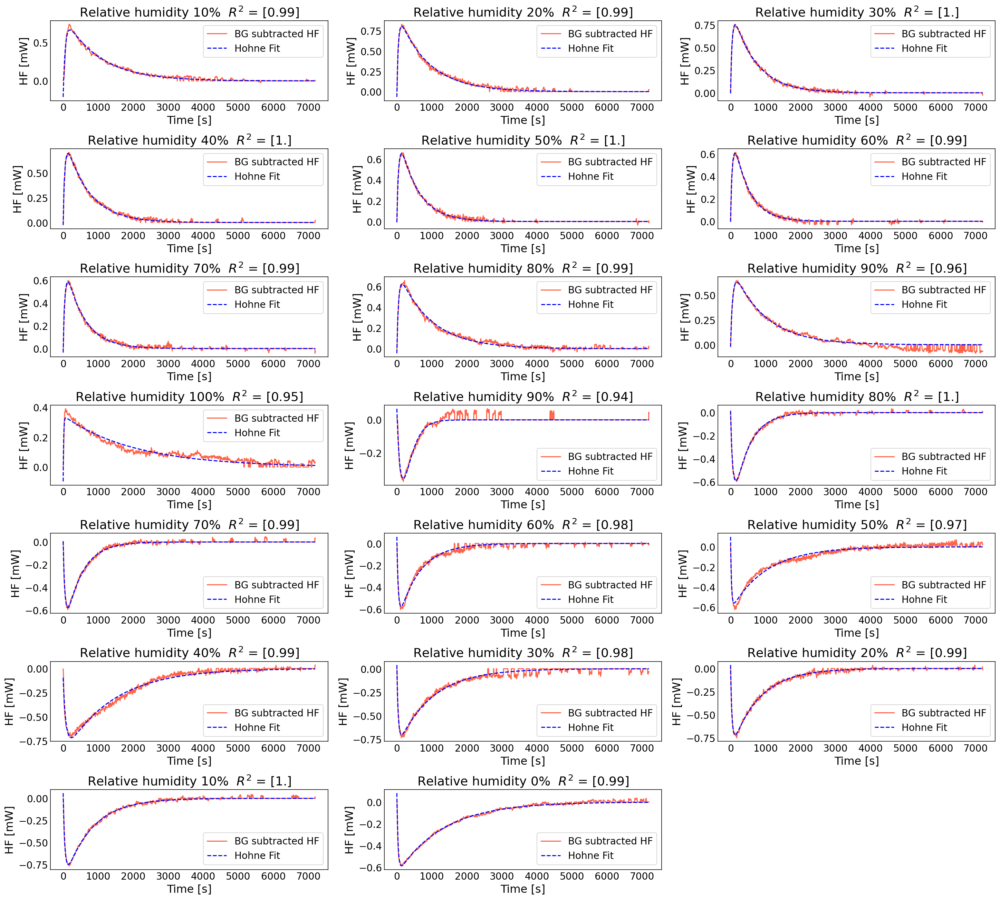

In [102]:
YT1_20C.hohne_fitting(save=True, p_0 = [0,0,50,700], max_fev=5000, save_path=notebook_folder+'\YT1_temperature_study_20C_method_2\chgc_20C_hohne_fitting.png')

C:\Users\yunti\AppData\Local\Temp/ipykernel_31504/1170153915.py:857: RuntimeWarning: overflow encountered in exp
  return a1_*np.exp(-x/tau1_)+a2_*np.exp(-x/tau2_)
C:\Users\yunti\AppData\Local\Temp/ipykernel_31504/1170153915.py:857: RuntimeWarning: overflow encountered in exp
  return a1_*np.exp(-x/tau1_)+a2_*np.exp(-x/tau2_)


Fitted Parameters are
[[  -1.30640979    1.04246306   56.92162551  973.53931111]
 [  -1.20518826    1.13194362   42.169771    725.42479059]
 [  -1.08049851    1.02482856   38.15237927  646.20962088]
 [  -1.04913134    1.01363682   42.74524972  559.58611885]
 [  -0.98290765    0.95590525   38.82237363  566.7452854 ]
 [  -0.95156226    0.95149321   40.04827774  446.03750311]
 [  -0.90367139    0.89049732   37.95433805  541.61017288]
 [  -0.83974722    0.76569051   31.62236664  944.69254172]
 [  -0.87103842    0.81236642   39.16096244 1049.28233388]
 [  -0.81775377    0.71265735   28.1503453  1571.06378423]
 [   0.99406877   -0.96452372   49.78801599  477.44434671]
 [   0.92449425   -0.86242939   41.95586331  495.83212859]
 [   0.92759703   -0.86617242   39.88550145  500.48133413]
 [   0.88185797   -0.8000733    31.59285136  547.40790027]
 [   0.75374704   -0.64150697   23.6230511  1281.43012813]
 [   0.9177616    -0.91530554   45.74391215 1306.34851939]
 [   0.99437364   -0.91531017   34

C:\Users\yunti\AppData\Local\Temp/ipykernel_31504/1170153915.py:918: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


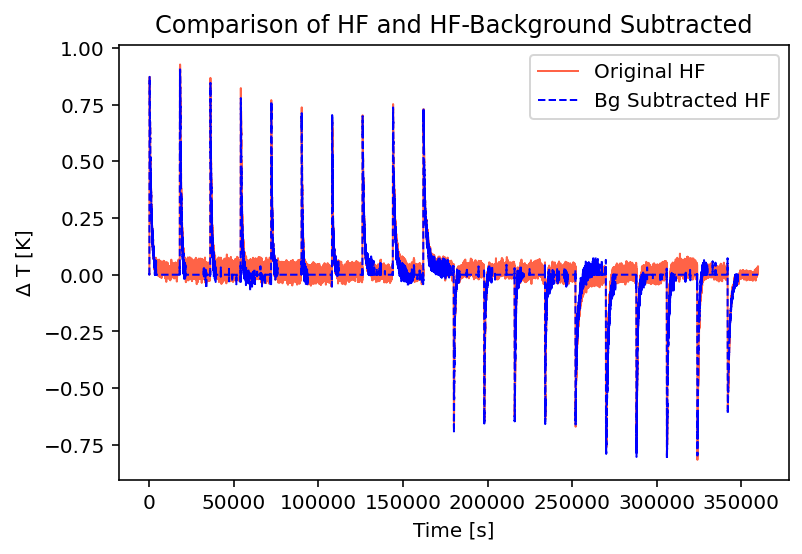

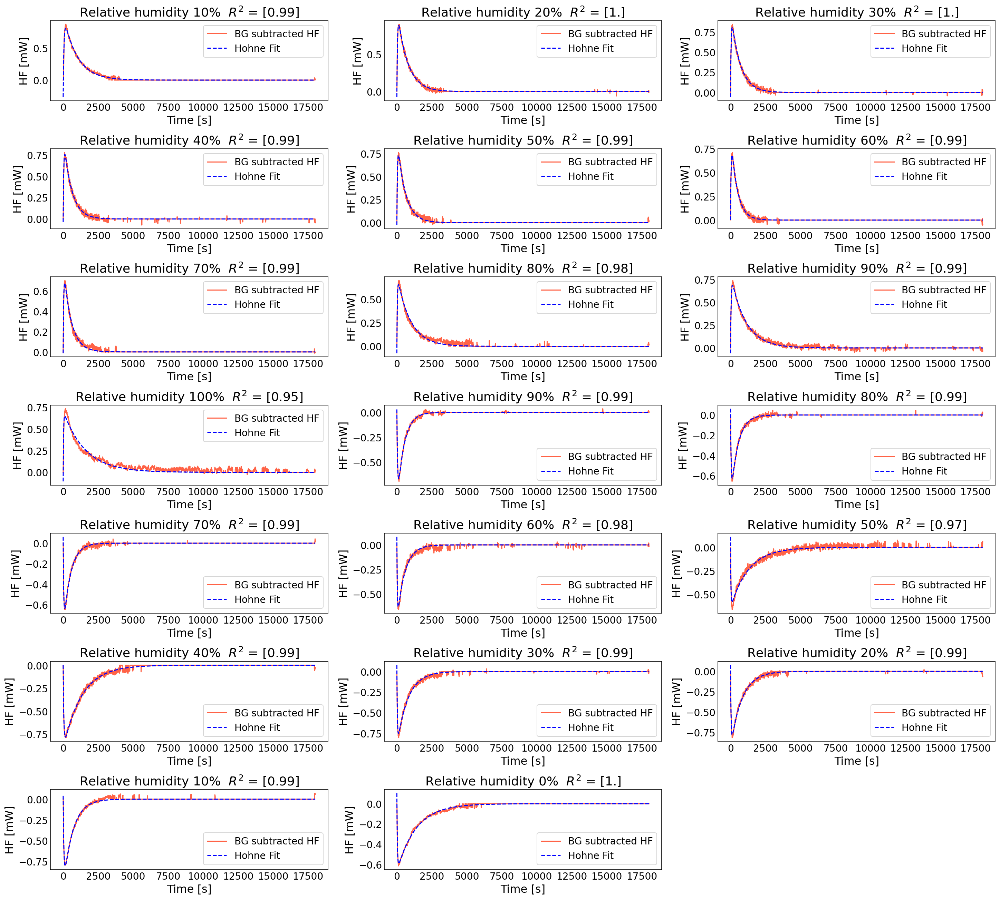

In [104]:
YT1_22C.hohne_fitting(save=True, p_0 = [1,-1,50,700], max_fev=1000, save_path=notebook_folder+'\YT1_temperature_study_22C_5h_method\chgc_22C_hohne_fitting.png')

In [ ]:
YT1_24C.hohne_fitting(save=True, p_0 = [-1,1,50,700], max_fev=5000, save_path=notebook_folder+'\YT1_temperature_study_24C_method\chgc_24C_hohne_fitting.png')

In [ ]:
YT1_26C.hohne_fitting(save=True, p_0 = [-1,1,50,700], max_fev=5000, save_path=notebook_folder+'\YT1_temperature_study_26C_method\chgc_26C_hohne_fitting.png')

### YT1_density_study_method

In [50]:
chgc_0T_new = chgc()
chgc_0point5T_new = chgc()
chgc_1T_new = chgc()
chgc_1point5T_new = chgc()
chgc_2T_new = chgc()
chgc_2point5T_new = chgc()
chgc_3T_new = chgc()

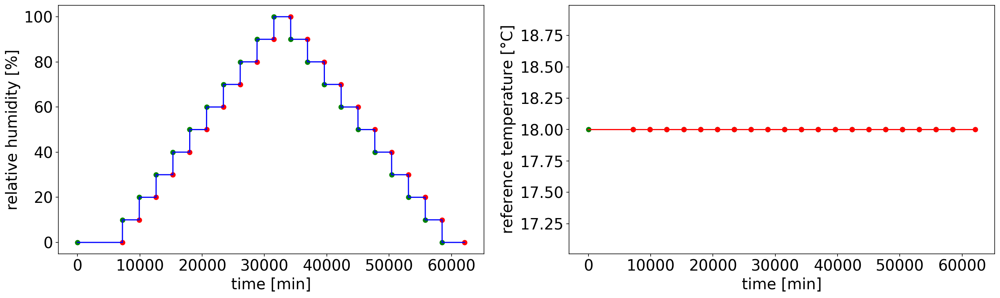

In [51]:
chgc_0T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_0T_new.parse_method()
chgc_0T_new.plot_method()

chgc_0point5T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_0point5T_new.parse_method()
#chgc_0point5T_new.plot_method()

chgc_1T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_1T_new.parse_method()
#chgc_1T_new.plot_method()

chgc_1point5T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_1point5T_new.parse_method()
#chgc_1point5T_new.plot_method()

chgc_2T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_2T_new.parse_method()
#chgc_2T_new.plot_method()

chgc_2point5T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_2point5T_new.parse_method()
#chgc_2point5T_new.plot_method()

chgc_3T_new.import_method('YT1_density_study_method\YT1_density_study_method.txt')
chgc_3T_new.parse_method()
#chgc_3T_new.plot_method()

In [52]:
chgc_0T_new.import_csv('YT1_density_study_method\YT1_0T_new.txt', preprocess=True)
chgc_0point5T_new.import_csv('YT1_density_study_method\YT1_0point5T_new.txt', preprocess=True)
chgc_1T_new.import_csv('YT1_density_study_method\YT1_1T_new.txt', preprocess=True)
chgc_1point5T_new.import_csv('YT1_density_study_method\YT1_1point5T_new.txt', preprocess=True)
chgc_2T_new.import_csv('YT1_density_study_method\YT1_2T_new.txt', preprocess=True)
chgc_2point5T_new.import_csv('YT1_density_study_method\YT1_2point5T_new.txt', preprocess=True)
chgc_3T_new.import_csv('YT1_density_study_method\YT1_3T_new.txt', preprocess=True)

In [53]:
# chgc_0T_new.exclude_segments(segs=[1])
# chgc_0point5T_new.exclude_segments(segs=[1])
# chgc_1T_new.exclude_segments(segs=[1])
# chgc_1point5T_new.exclude_segments(segs=[1])
# chgc_2T_new.exclude_segments(segs=[1])
# chgc_2point5T_new.exclude_segments(segs=[1])
# chgc_3T_new.exclude_segments(segs=[1])

chgc_0T_new.data_gradient(sm=1*10**-3)
chgc_0point5T_new.data_gradient(sm=1*10**-3)
chgc_1T_new.data_gradient(sm=1*10**-3)
chgc_1point5T_new.data_gradient(sm=1*10**-3)
chgc_2T_new.data_gradient(sm=1*10**-3)
chgc_2point5T_new.data_gradient(sm=1*10**-3)
chgc_3T_new.data_gradient(sm=1*10**-3)

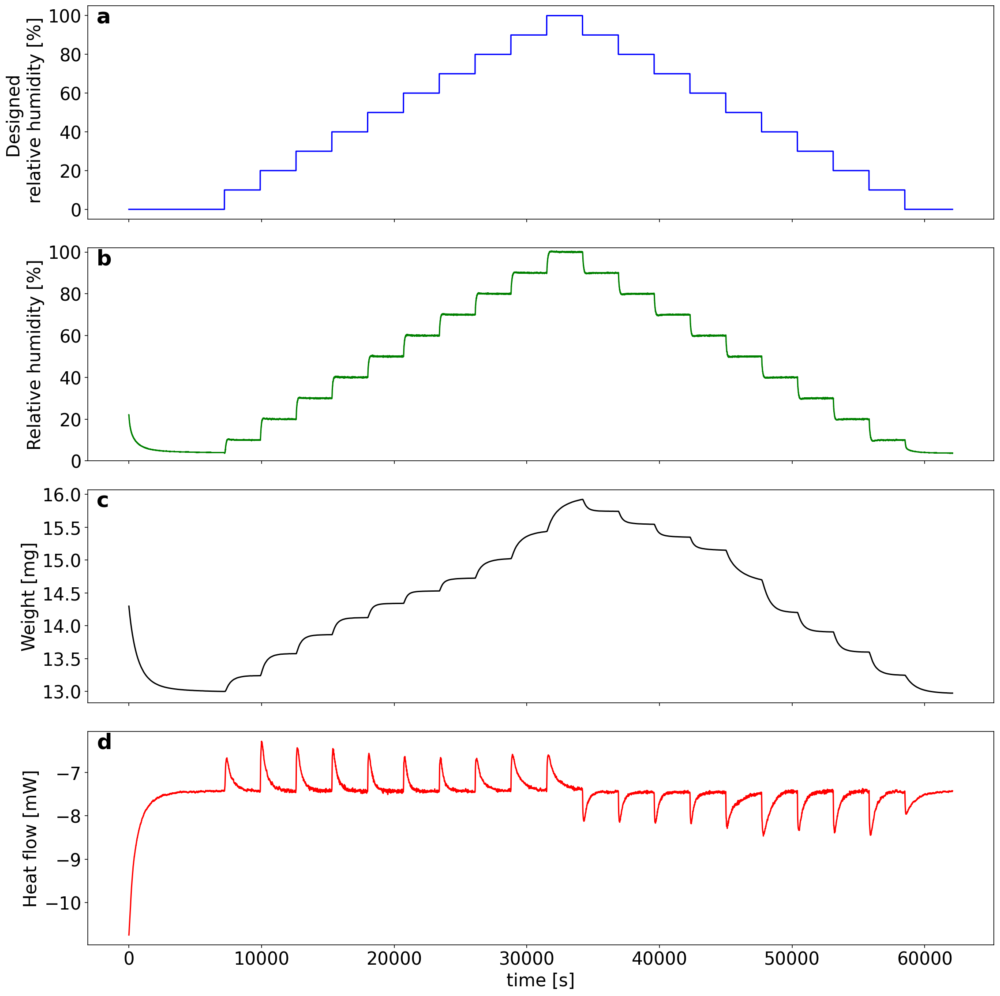

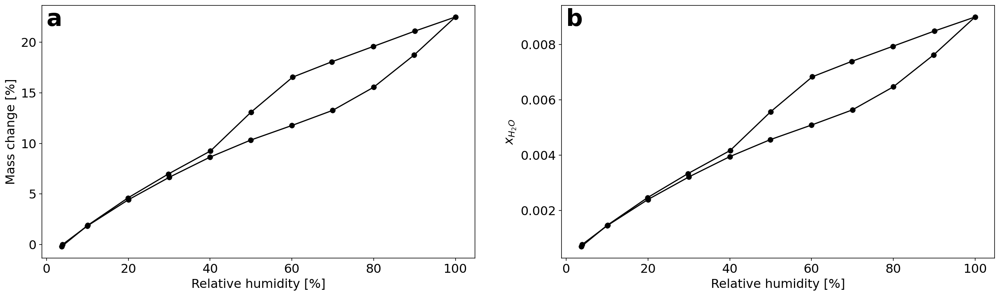

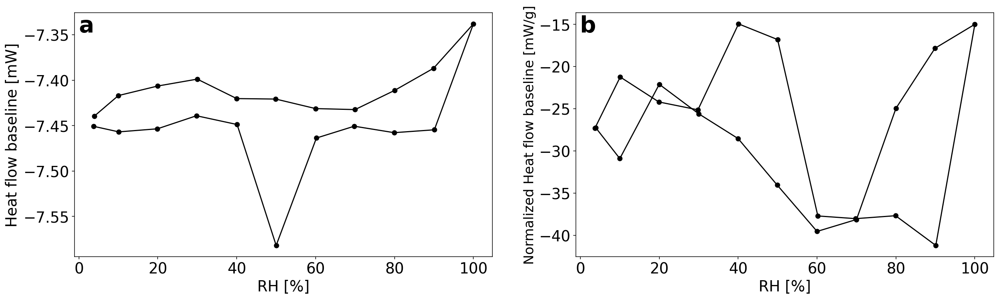

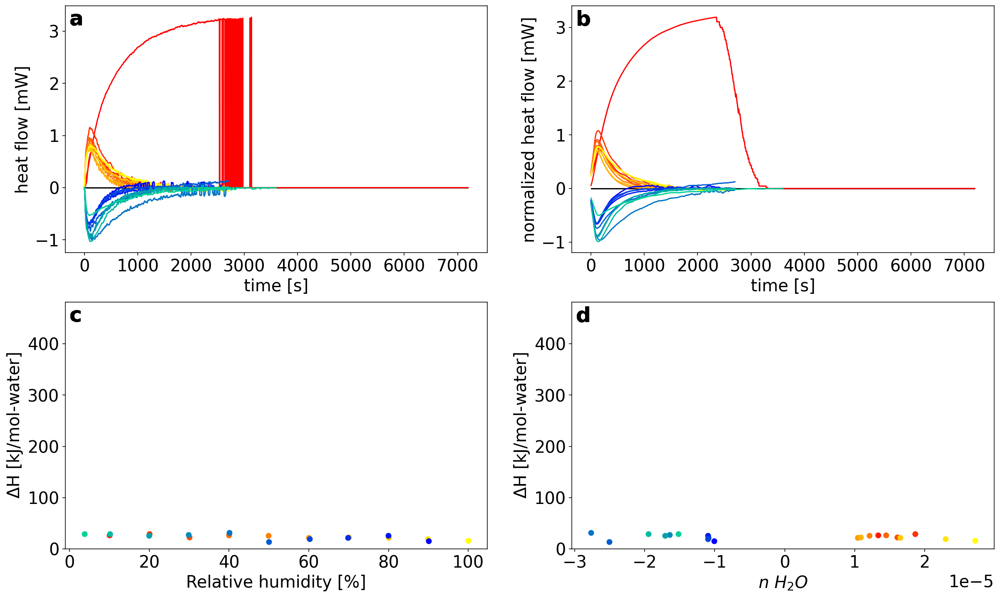

In [54]:
chgc_0T_new.chgc_data(plot=True)
chgc_0T_new.chgc_grad_data(plot=False)
chgc_0T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_0T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

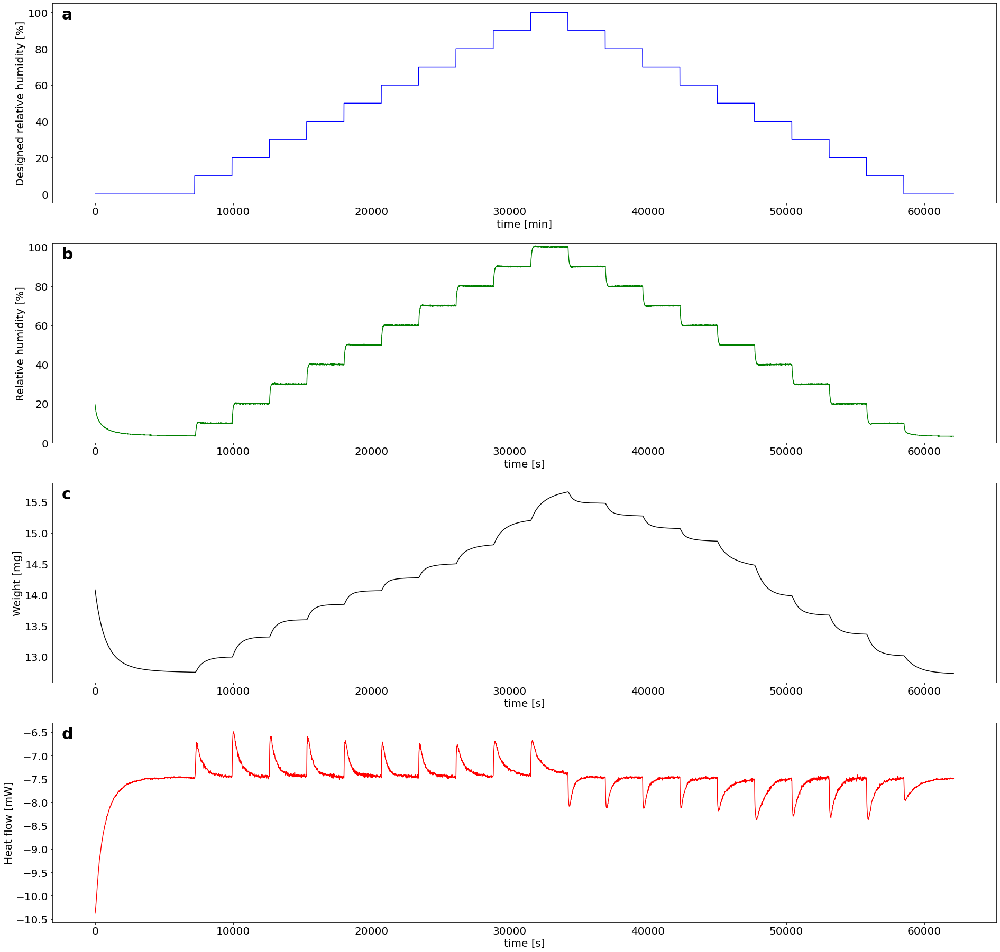

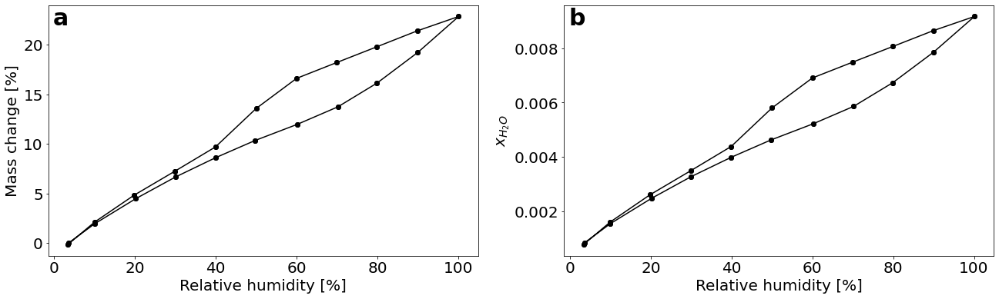

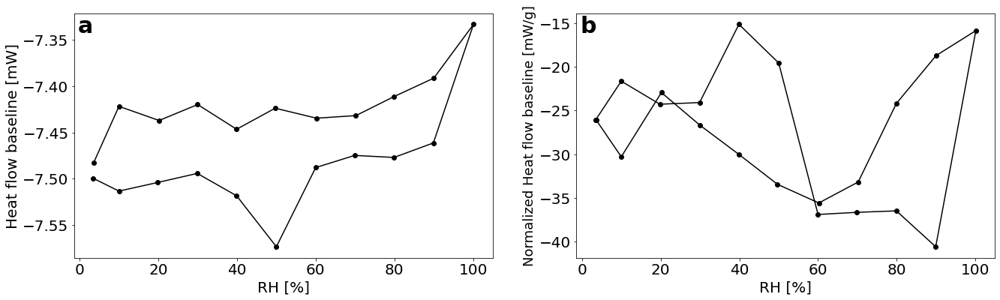

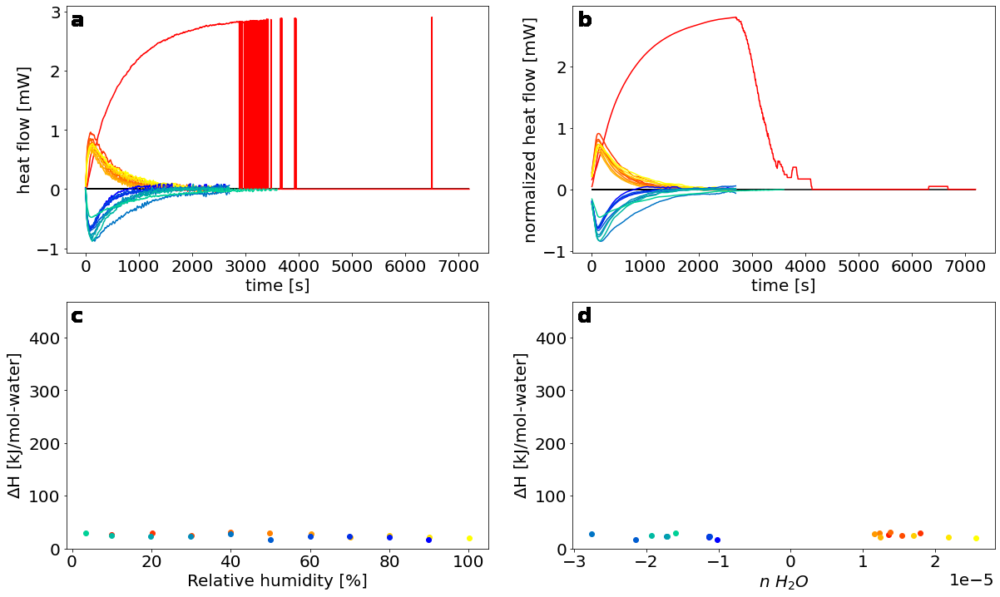

In [9]:
chgc_0point5T_new.chgc_data(plot=True)
chgc_0point5T_new.chgc_grad_data(plot=False)
chgc_0point5T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_0point5T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

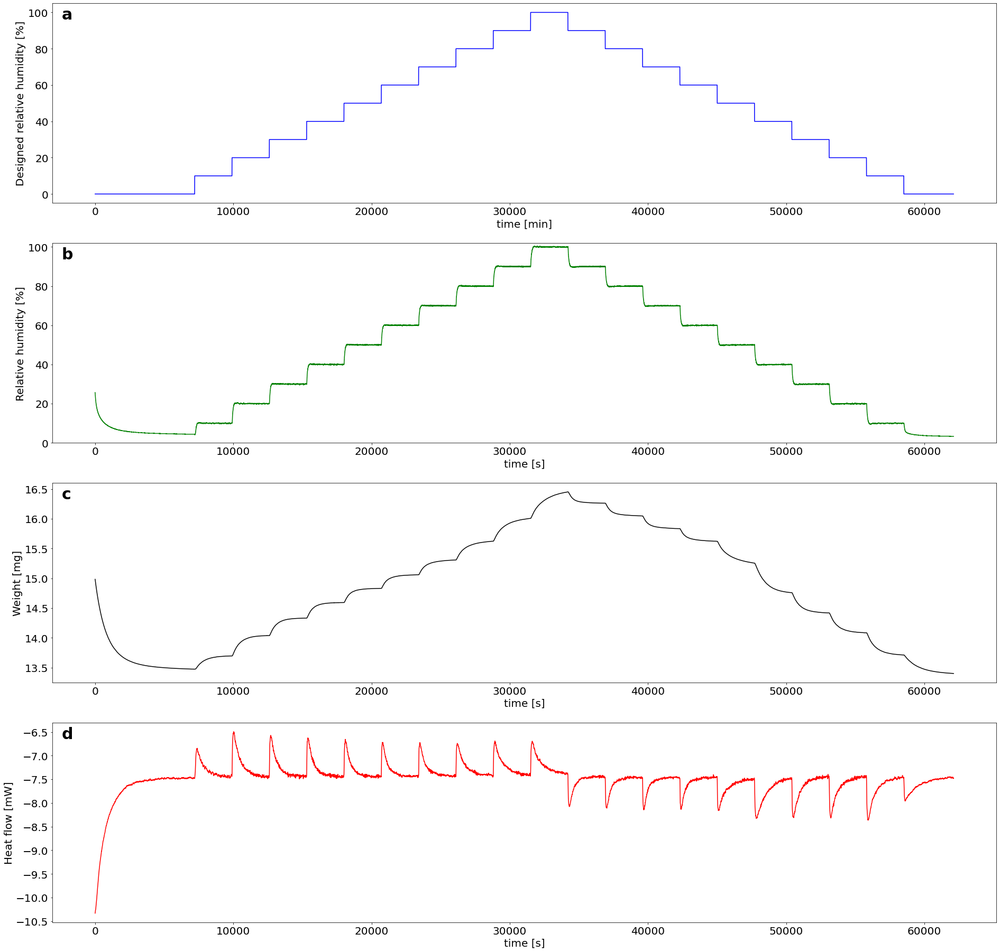

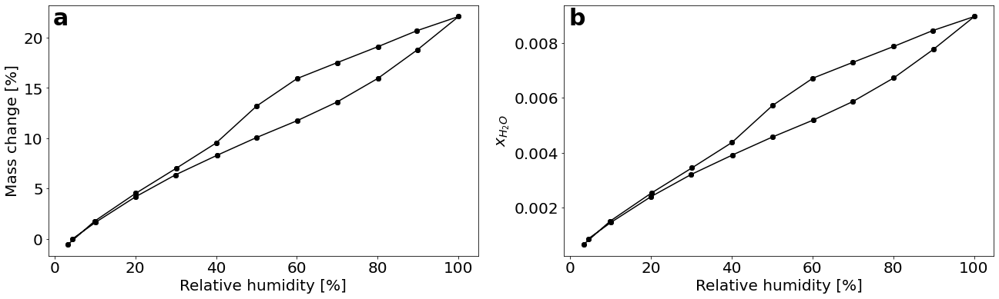

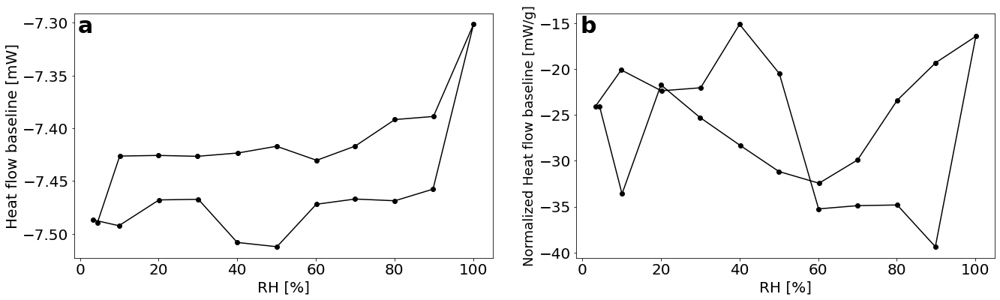

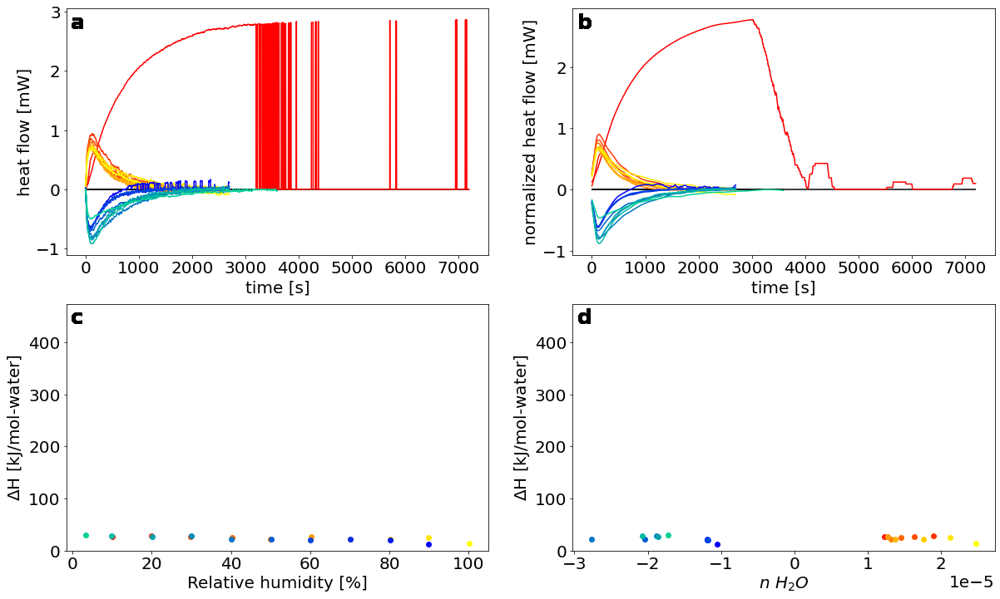

In [10]:
chgc_1T_new.chgc_data(plot=True)
chgc_1T_new.chgc_grad_data(plot=False)
chgc_1T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_1T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

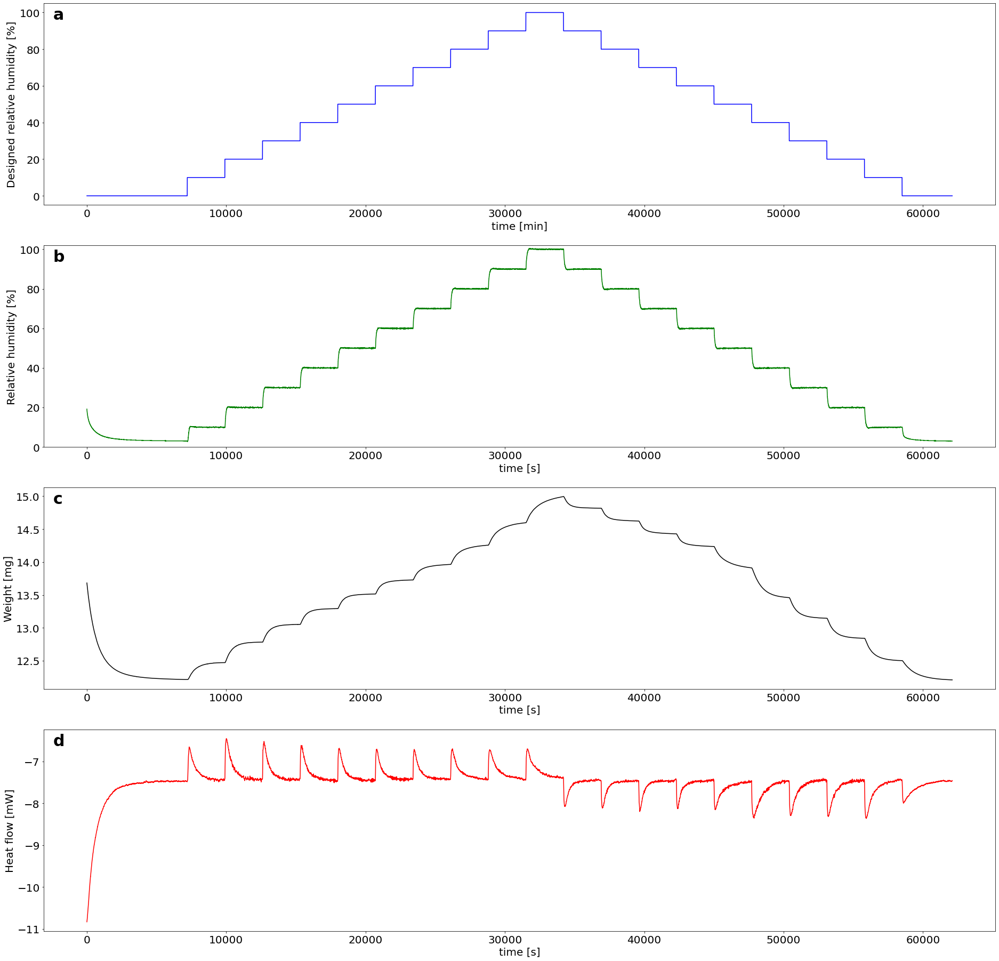

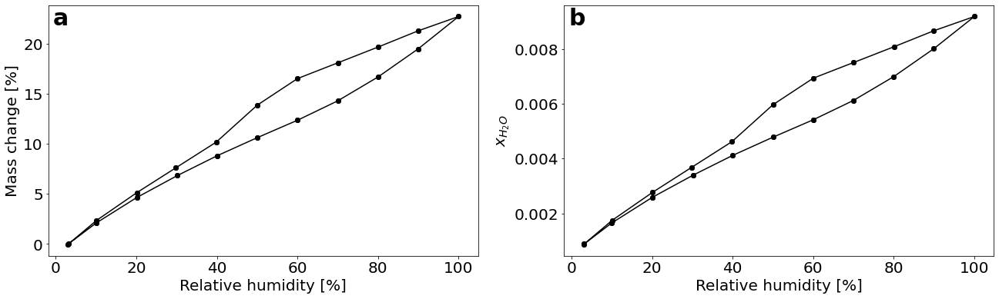

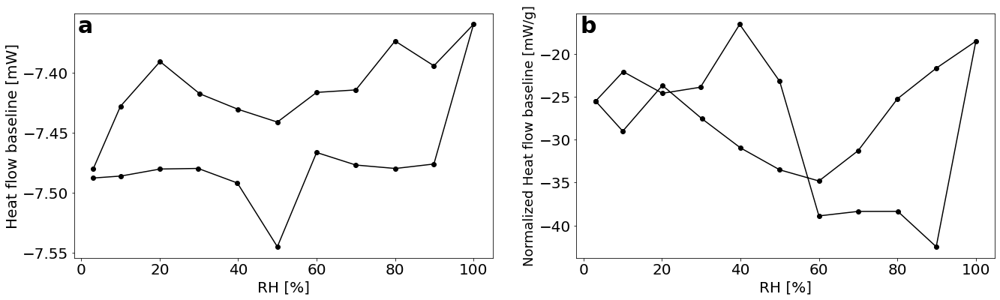

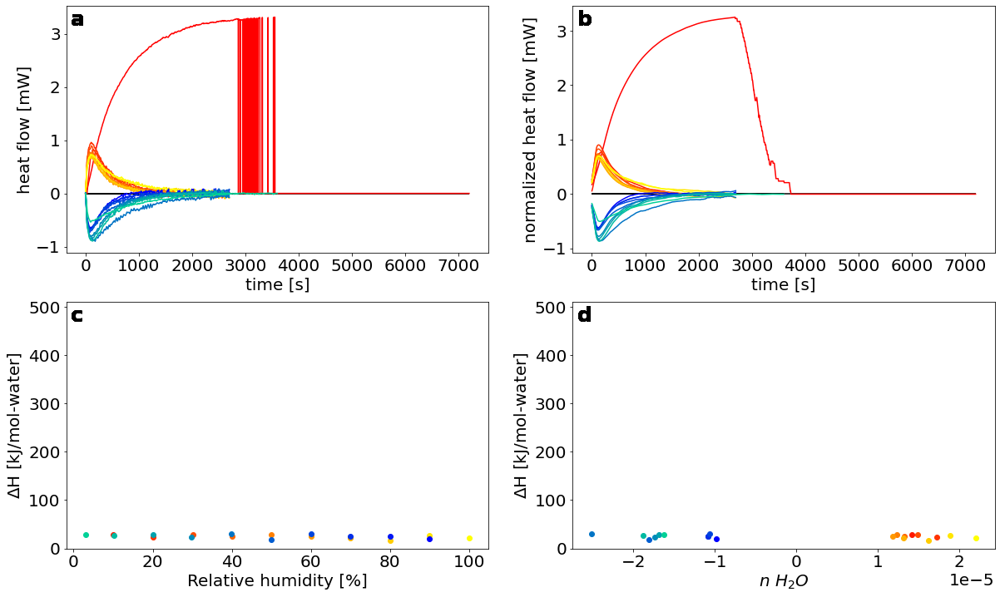

In [11]:
chgc_1point5T_new.chgc_data(plot=True)
chgc_1point5T_new.chgc_grad_data(plot=False)
chgc_1point5T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_1point5T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

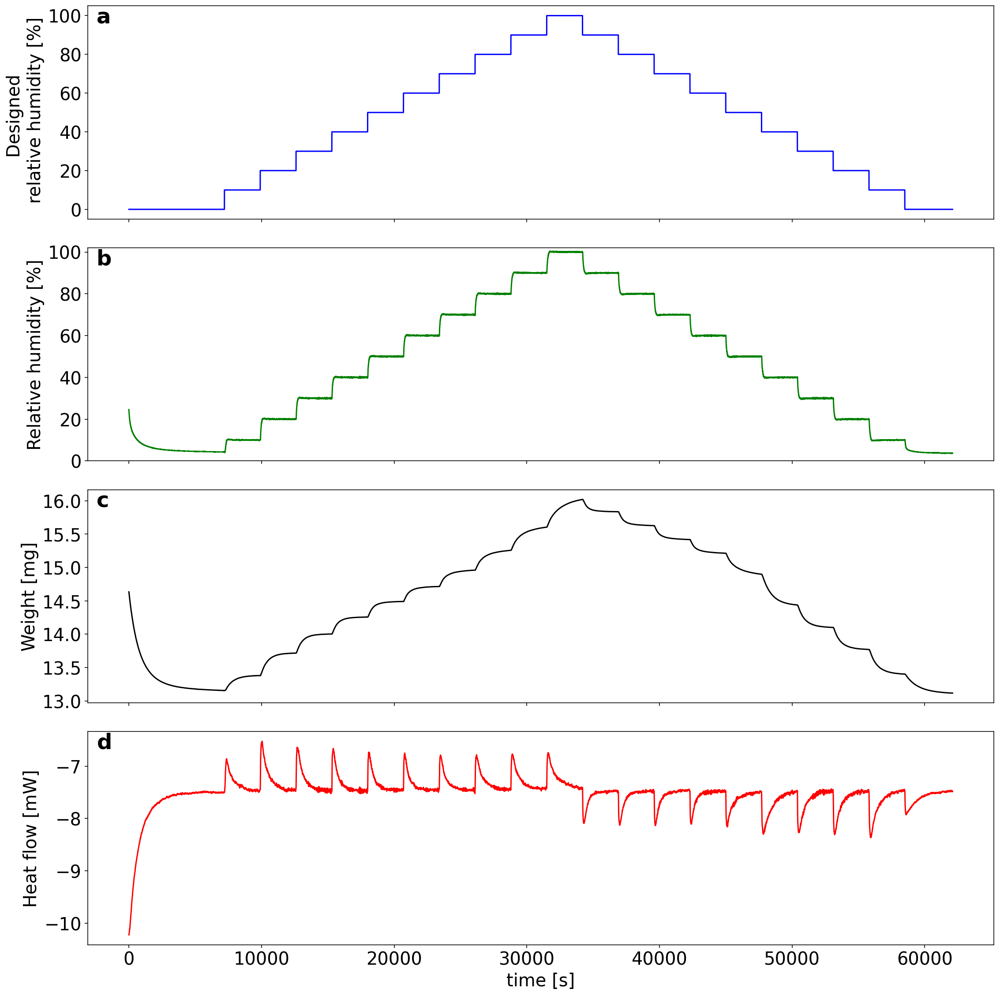

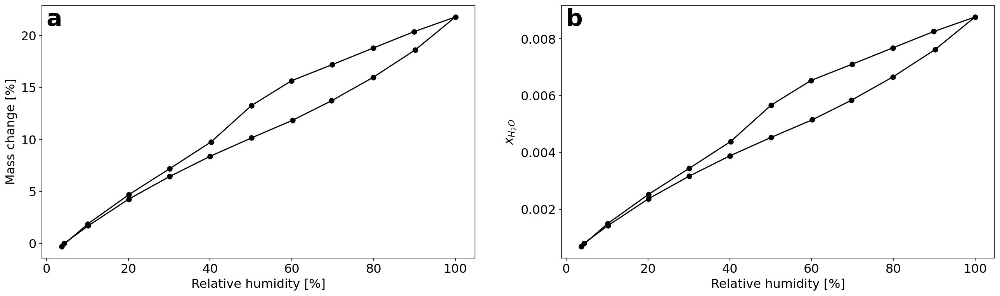

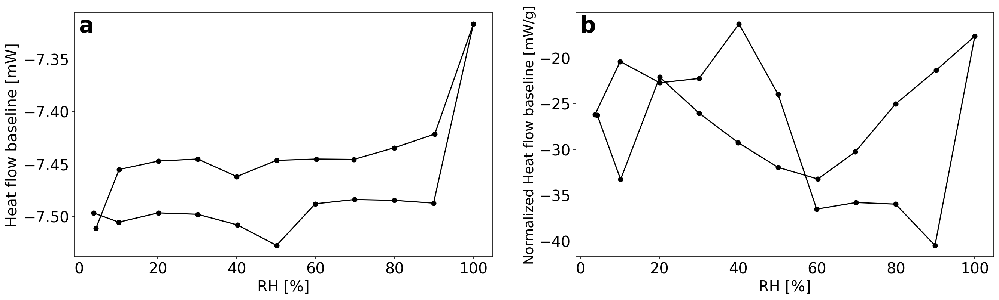

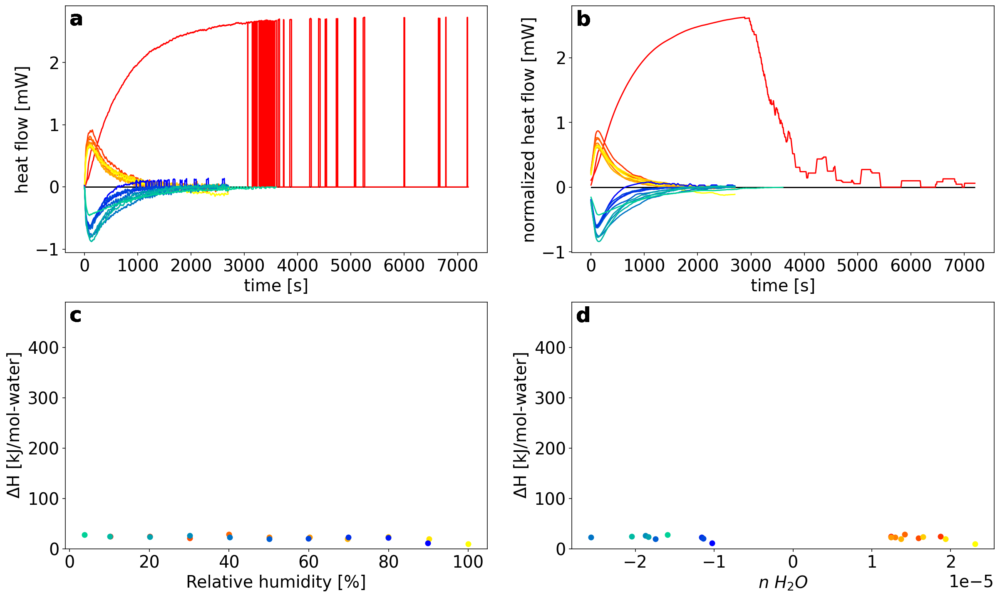

In [55]:
chgc_2T_new.chgc_data(plot=True)
chgc_2T_new.chgc_grad_data(plot=False)
chgc_2T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_2T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

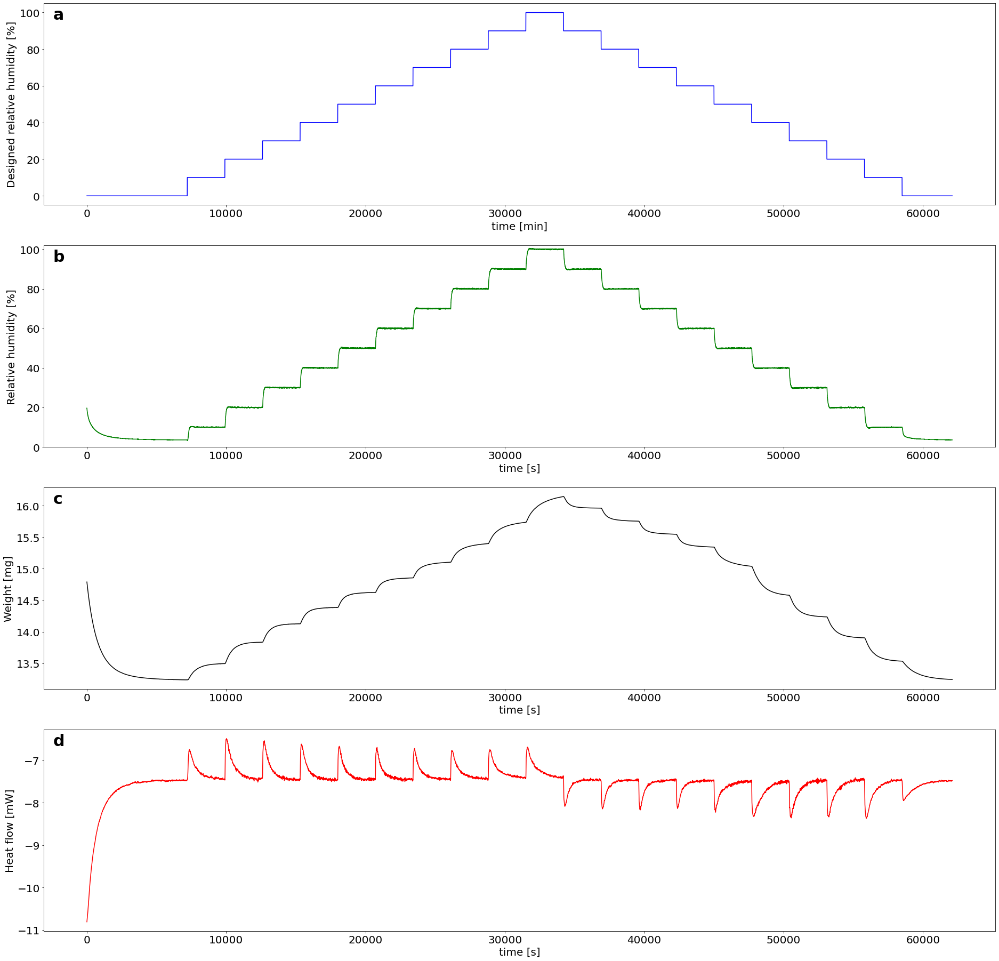

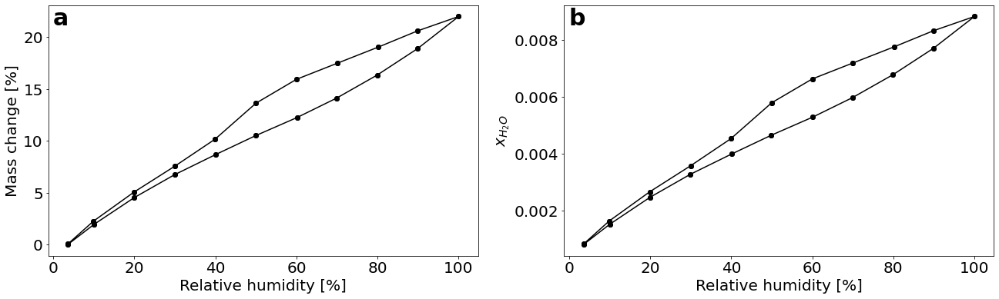

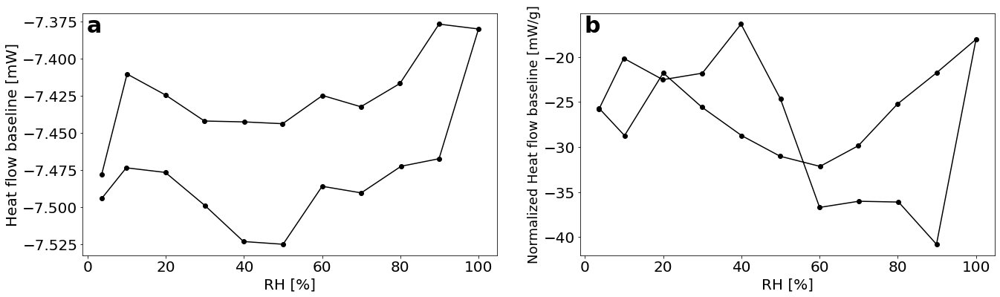

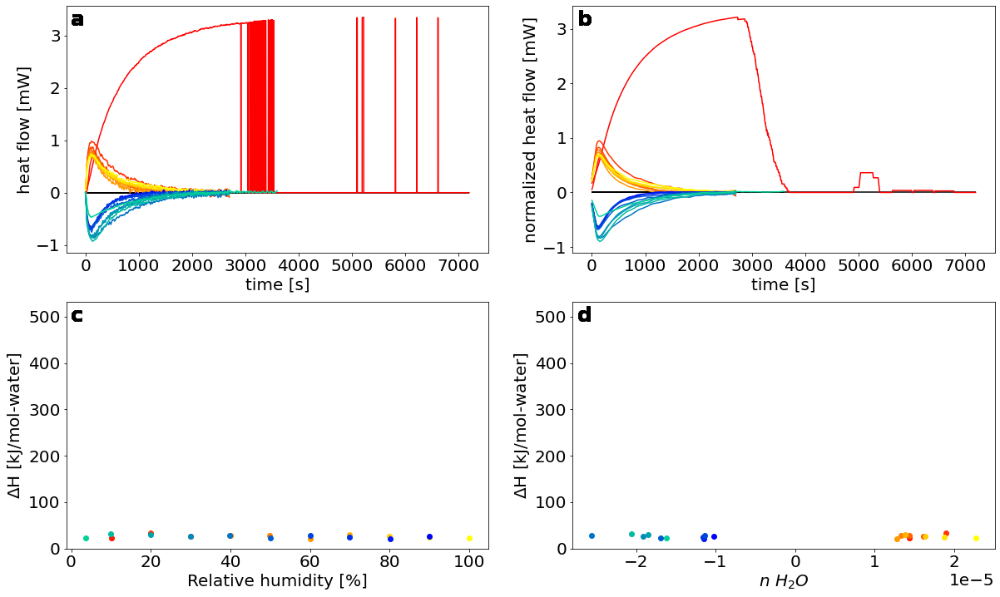

In [13]:
chgc_2point5T_new.chgc_data(plot=True)
chgc_2point5T_new.chgc_grad_data(plot=False)
chgc_2point5T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_2point5T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

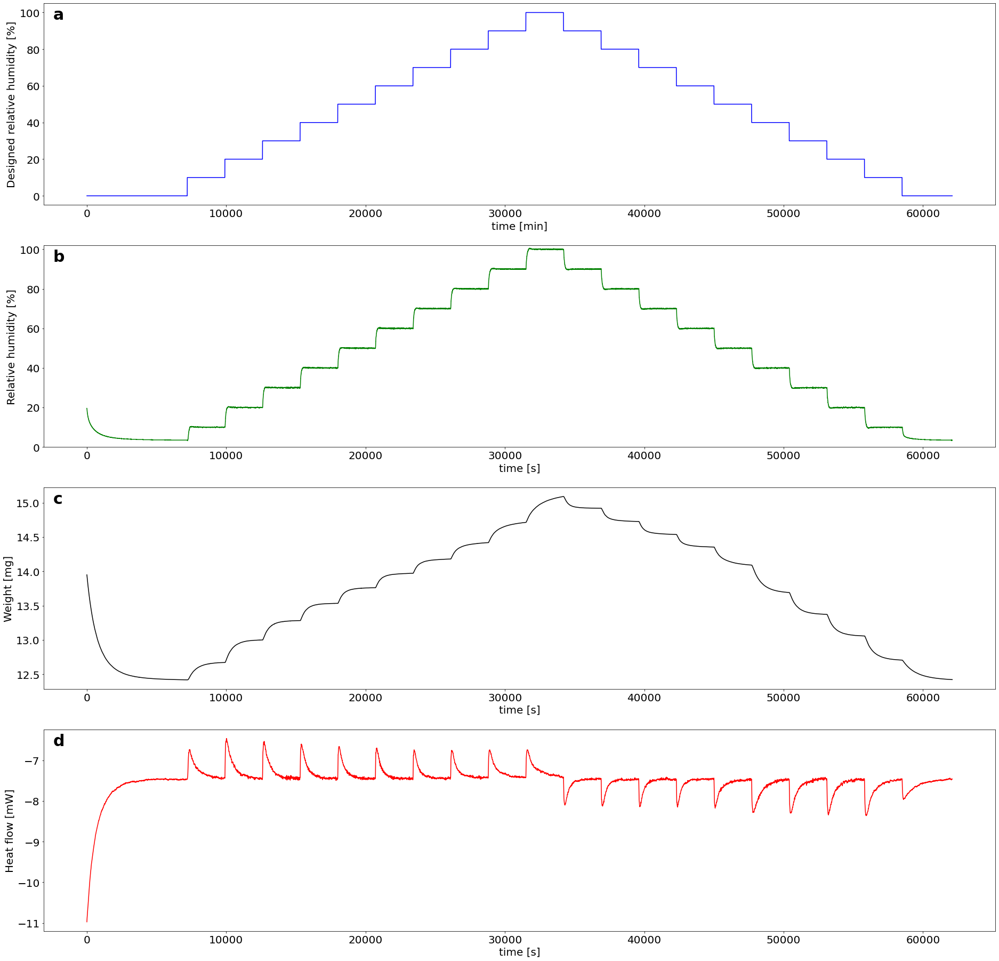

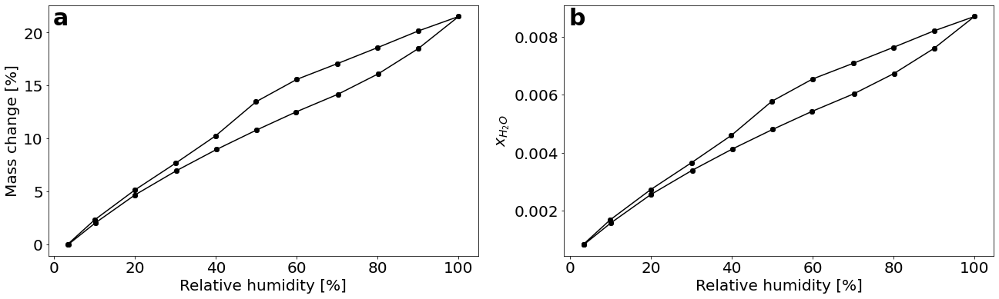

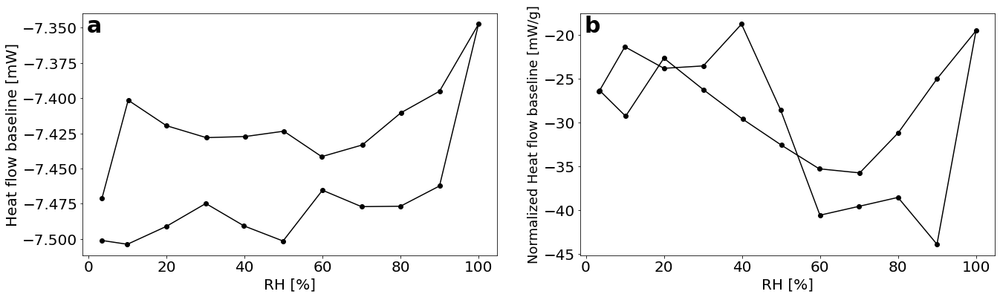

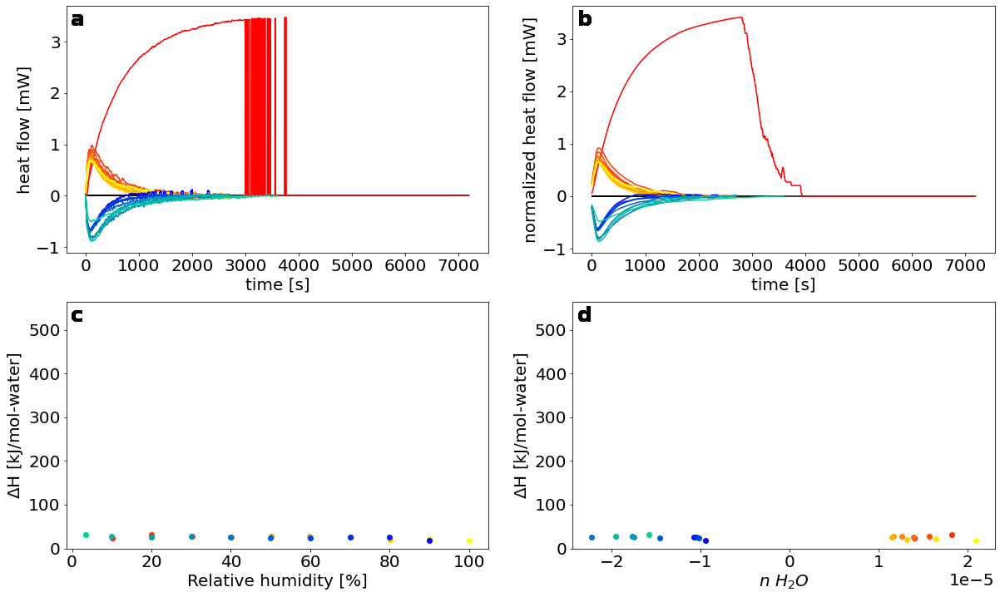

In [14]:
chgc_3T_new.chgc_data(plot=True)
chgc_3T_new.chgc_grad_data(plot=False)
chgc_3T_new.hydration_quant(fsize=100, hfextrema=1)
chgc_3T_new.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

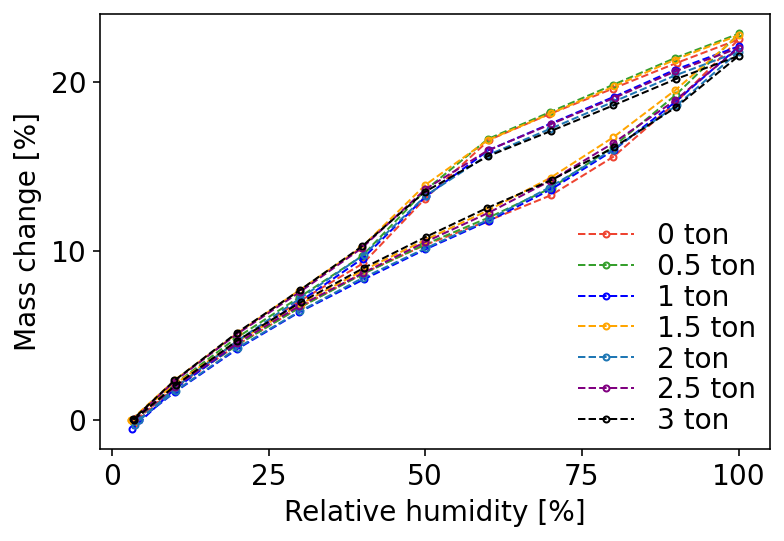

In [107]:
plt.figure(figsize=(6, 4))
plt.plot(chgc_0T_new.data['RH'][chgc_0T_new.end_segs], 100 * chgc_0T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='0 ton', markerfacecolor='none', markeredgewidth=1, linewidth='1',color='#EE4431')
plt.plot(chgc_0point5T_new.data['RH'][chgc_0point5T_new.end_segs], 100 * chgc_0point5T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='0.5 ton', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='#369F2D')
plt.plot(chgc_1T_new.data['RH'][chgc_1T_new.end_segs], 100 * chgc_1T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='1 ton', markerfacecolor='none', markeredgewidth=1,linewidth='1', color='blue')
plt.plot(chgc_1point5T_new.data['RH'][chgc_1point5T_new.end_segs], 100 * chgc_1point5T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='1.5 ton', markerfacecolor='none', linewidth='1',markeredgewidth=1, color='orange')
plt.plot(chgc_2T_new.data['RH'][chgc_2T_new.end_segs], 100 * chgc_2T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='2 ton', markerfacecolor='none', linewidth='1',markeredgewidth=1)
plt.plot(chgc_2point5T_new.data['RH'][chgc_2point5T_new.end_segs], 100 * chgc_2point5T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='2.5 ton',  markeredgewidth=1, linewidth='1', color='purple', markerfacecolor='none')#, color=color_map(5/10))
plt.plot(chgc_3T_new.data['RH'][chgc_3T_new.end_segs], 100 * chgc_3T_new.mass_frac, marker='o', markersize=3, linestyle='--', label='3 ton',  markeredgewidth=1, linewidth='1', color='BLACK', markerfacecolor='none')#, color=color_map(5/10))
plt.xlabel('Relative humidity [%]', fontsize=14)
plt.ylabel('Mass change [%]', fontsize=14)
plt.legend(fontsize=14, loc='lower right', borderaxespad=0.1, ncol=1, labelspacing=0.1, columnspacing=0.5,frameon=False)#, labelspacing=0.1, columnspacing=0.5, handletextpad=0.1, handlelength=1.5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()


### YT1_mass_study_method

In [56]:
chgc_mass_10mg = chgc()
chgc_mass_15mg = chgc()
chgc_mass_20mg = chgc()
chgc_mass_25mg = chgc()
chgc_mass_30mg = chgc()

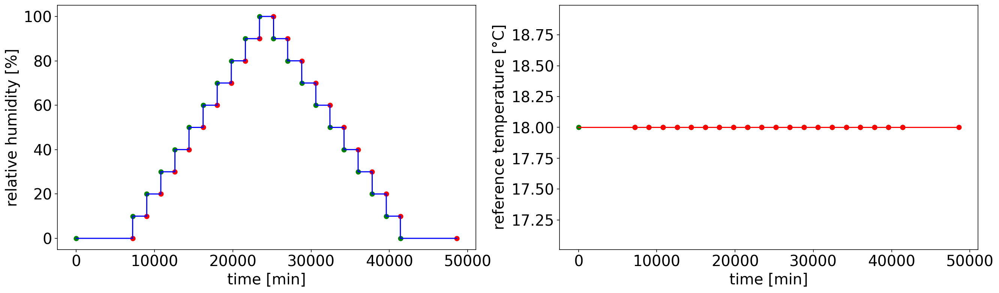

In [57]:
chgc_mass_10mg.import_method('YT1_mass_study_method\YT1_mass_study_method.txt')
chgc_mass_10mg.parse_method()
chgc_mass_10mg.plot_method()

chgc_mass_15mg.import_method('YT1_mass_study_method\YT1_mass_study_method.txt')
chgc_mass_15mg.parse_method()
#chgc_mass_15mg.plot_method()

chgc_mass_20mg.import_method('YT1_mass_study_method\YT1_mass_study_method.txt')
chgc_mass_20mg.parse_method()
#chgc_mass_20mg.plot_method()

chgc_mass_25mg.import_method('YT1_mass_study_method\YT1_mass_study_method.txt')
chgc_mass_25mg.parse_method()
#chgc_mass_25mg.plot_method()

chgc_mass_30mg.import_method('YT1_mass_study_method\YT1_mass_study_method.txt')
chgc_mass_30mg.parse_method()
#chgc_mass_30mg.plot_method()

In [58]:
chgc_mass_10mg.import_csv('YT1_mass_study_method\YT1_10mg.txt', preprocess=True)
chgc_mass_15mg.import_csv('YT1_mass_study_method\YT1_15mg.txt', preprocess=True)
chgc_mass_20mg.import_csv('YT1_mass_study_method\YT1_20mg.txt', preprocess=True)
chgc_mass_25mg.import_csv('YT1_mass_study_method\YT1_25mg.txt', preprocess=True)
chgc_mass_30mg.import_csv('YT1_mass_study_method\YT1_30mg.txt', preprocess=True)

In [59]:
# chgc_mass_10mg.exclude_segments(segs=[1])
# chgc_mass_15mg.exclude_segments(segs=[1])
# chgc_mass_20mg.exclude_segments(segs=[1])
# chgc_mass_25mg.exclude_segments(segs=[1])
# chgc_mass_30mg.exclude_segments(segs=[1])

chgc_mass_10mg.data_gradient(sm=1*10**-3)
chgc_mass_15mg.data_gradient(sm=1*10**-3)
chgc_mass_20mg.data_gradient(sm=1*10**-3)
chgc_mass_25mg.data_gradient(sm=1*10**-3)
chgc_mass_30mg.data_gradient(sm=1*10**-3)

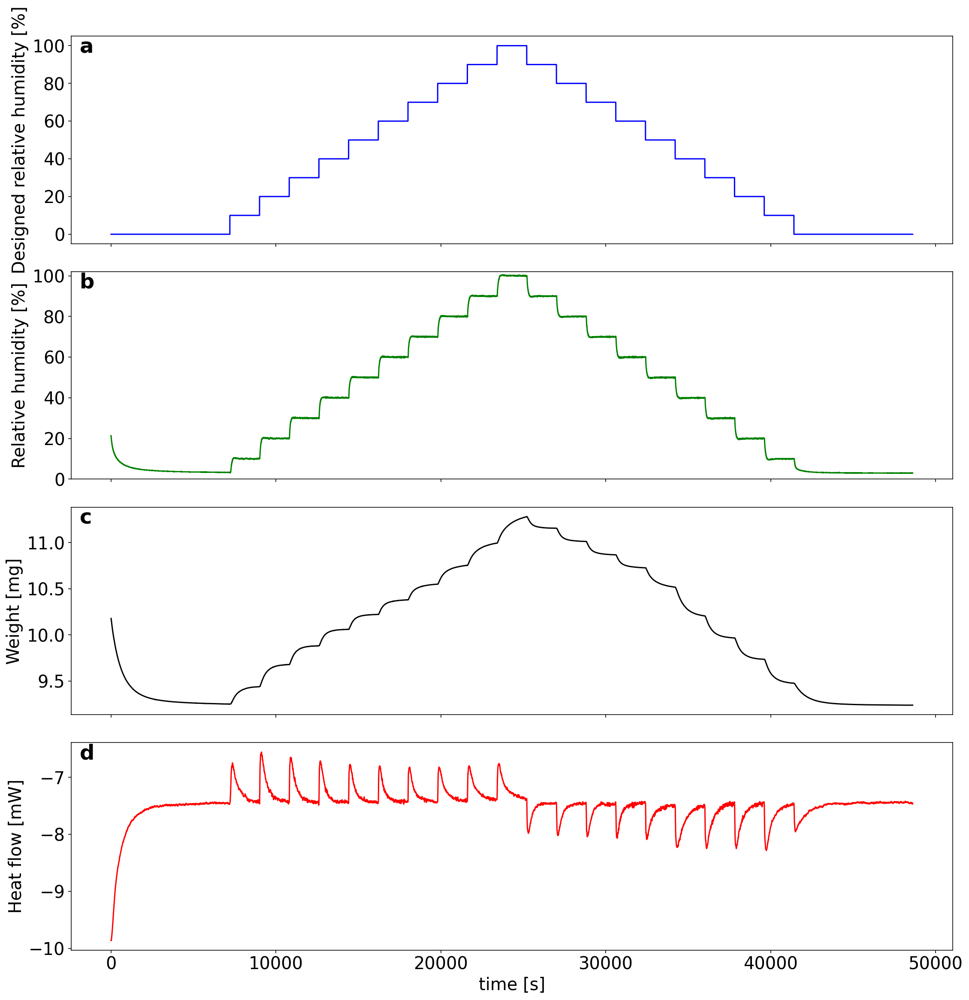

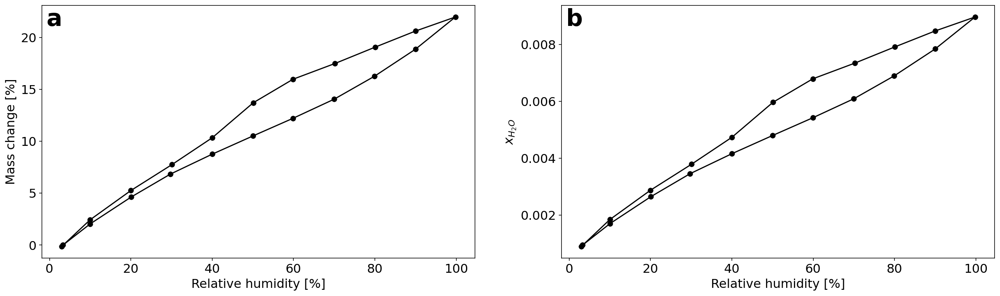

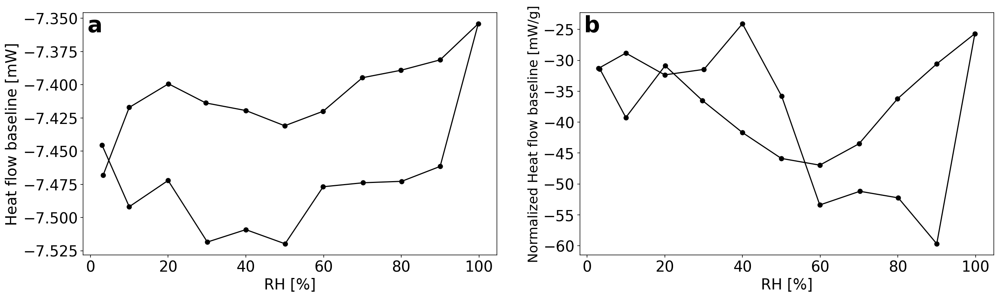

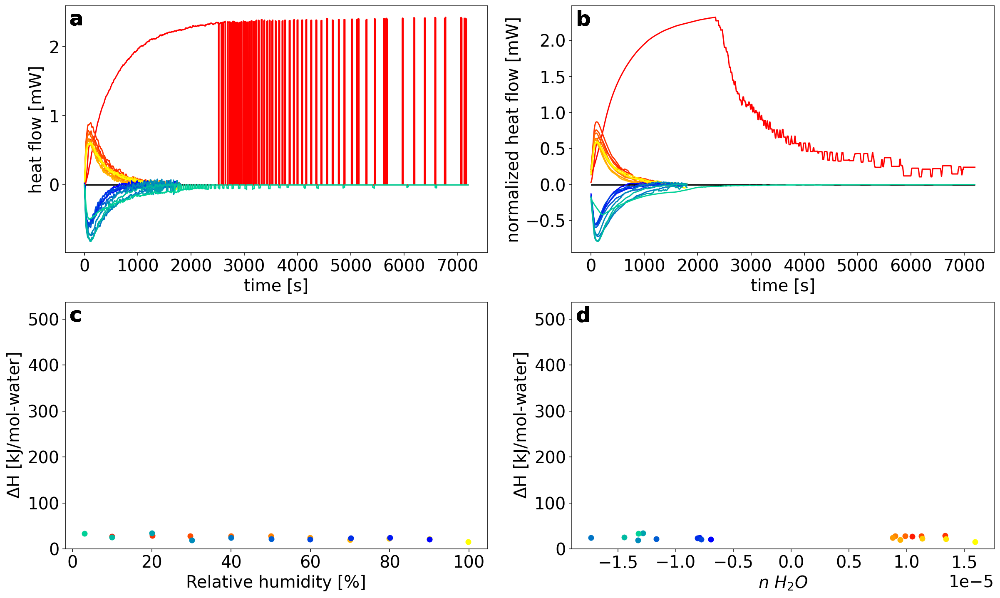

In [13]:
chgc_mass_10mg.chgc_data(plot=True) #, save=True, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_10mg_chgc_data.png')
chgc_mass_10mg.chgc_grad_data(plot=False) 
chgc_mass_10mg.hydration_quant(fsize=100, hfextrema=1) #, save=True, save_path=notebook_folder+'\YT1_mass_study_method\chgc_mass_10mg_hydration_quant.png')
chgc_mass_10mg.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

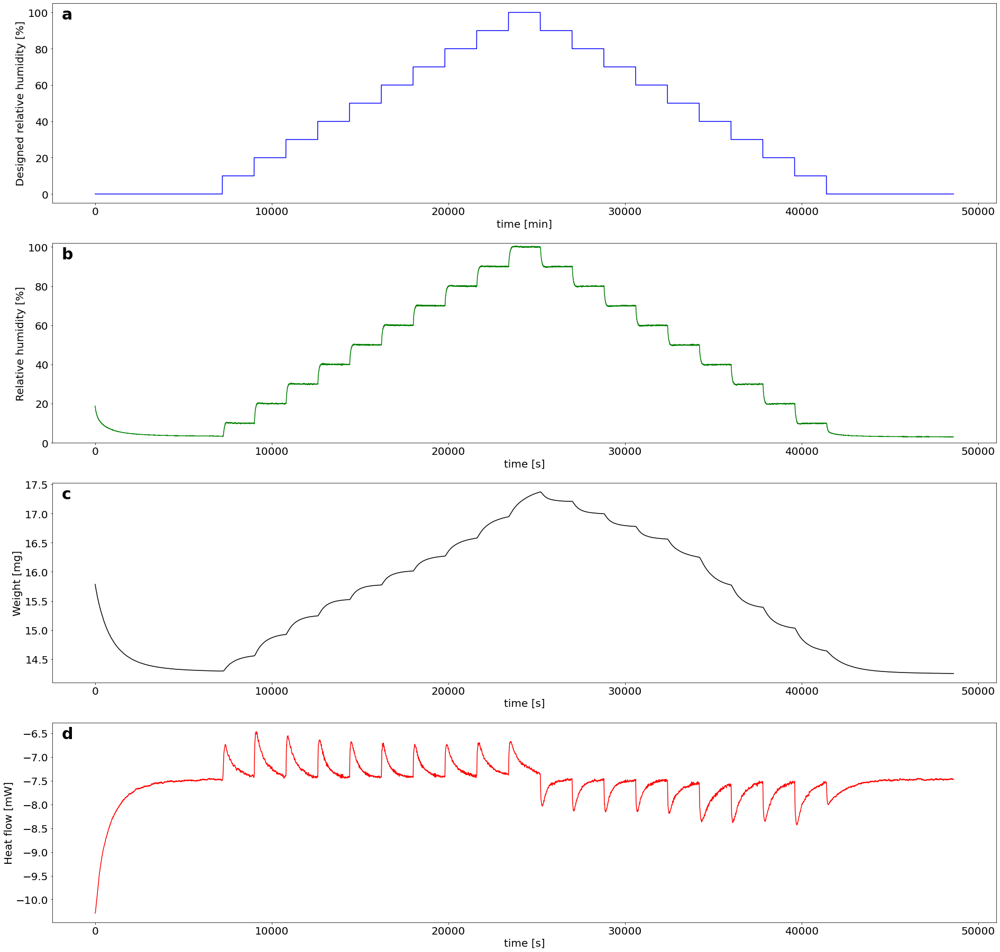

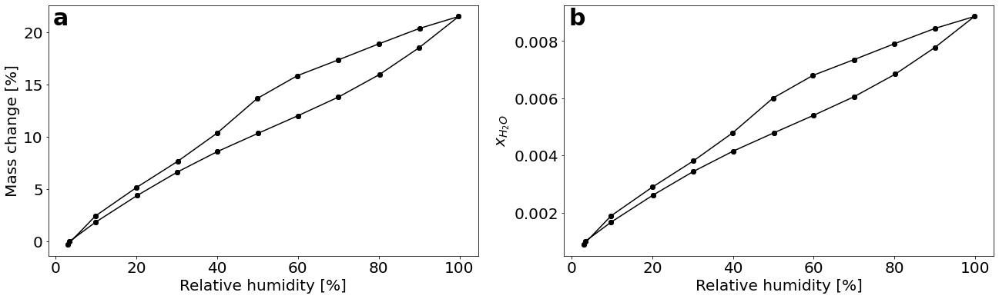

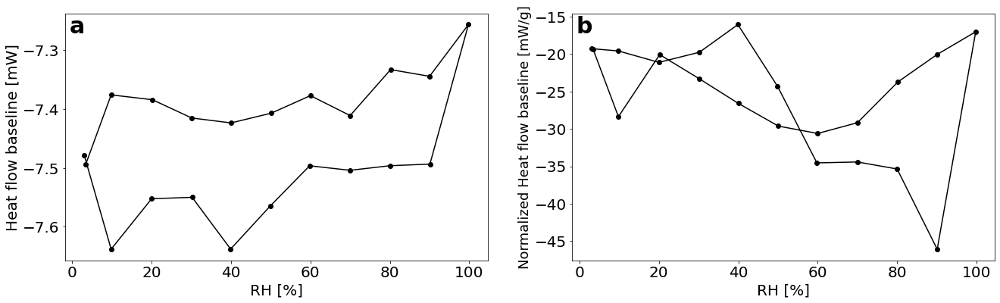

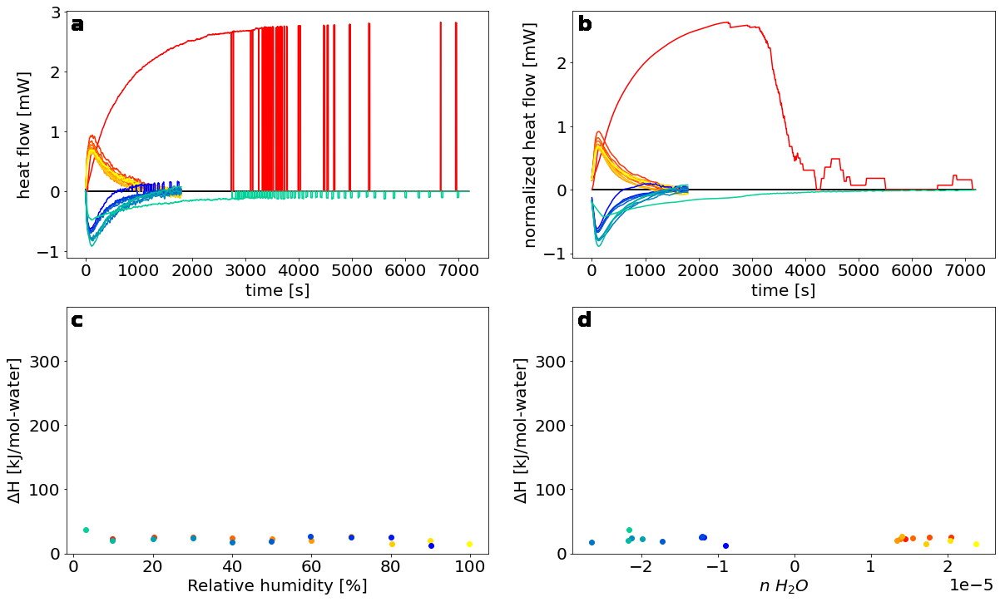

In [59]:
chgc_mass_15mg.chgc_data(plot=True)
chgc_mass_15mg.chgc_grad_data(plot=False)
chgc_mass_15mg.hydration_quant(fsize=100, hfextrema=1)
chgc_mass_15mg.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

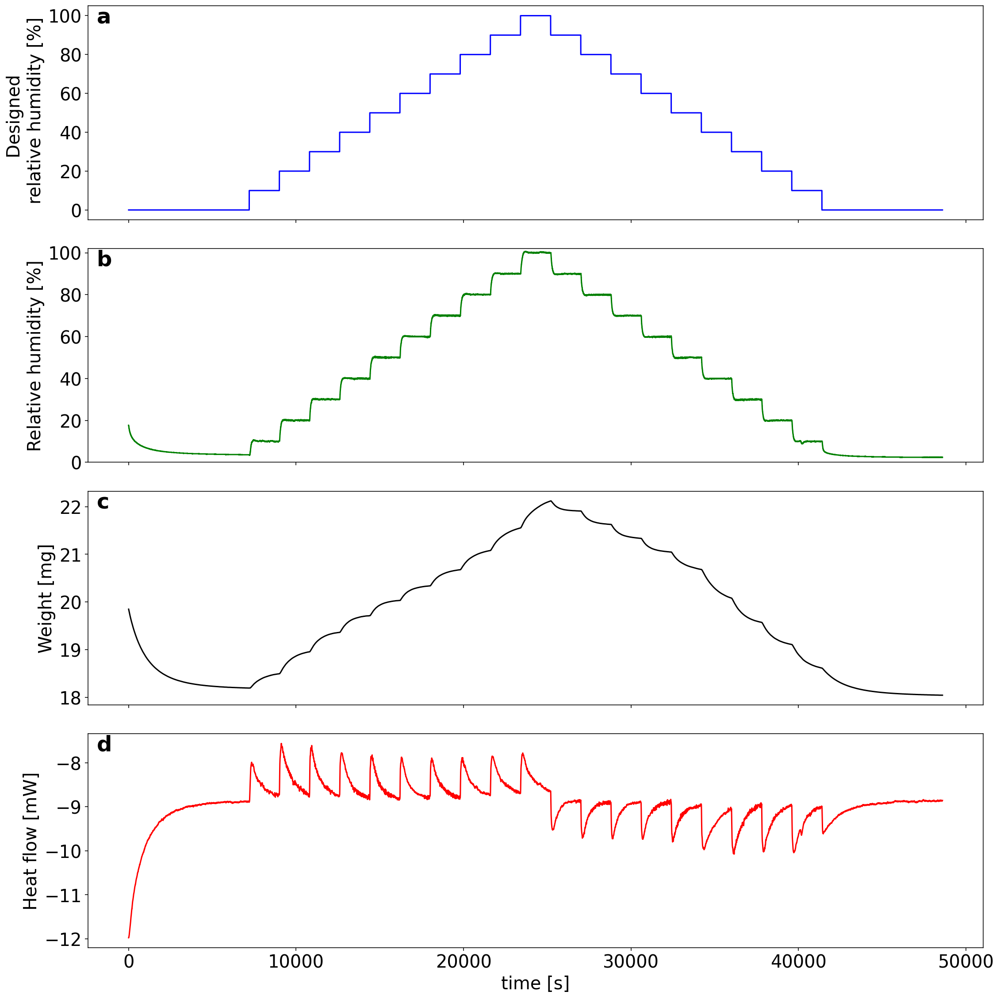

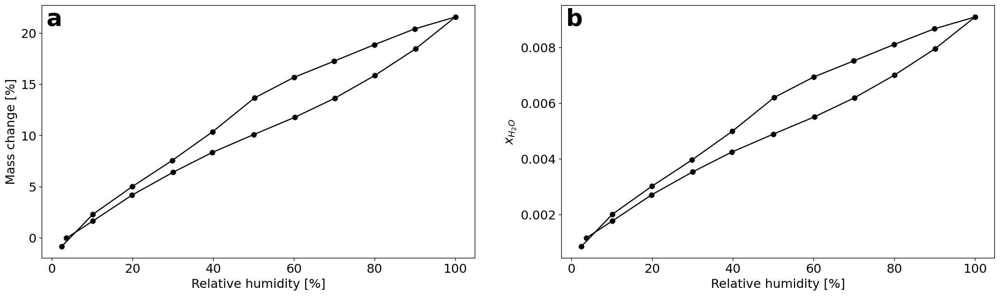

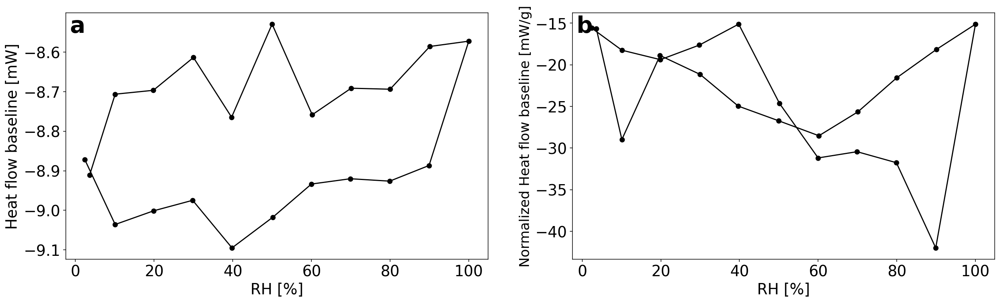

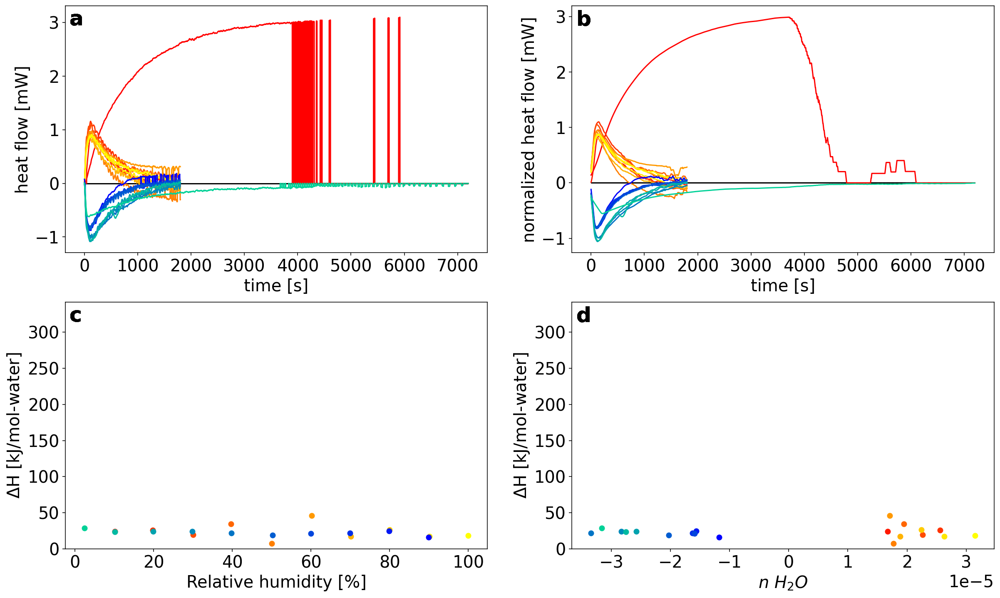

In [60]:
chgc_mass_20mg.chgc_data(plot=True)
chgc_mass_20mg.chgc_grad_data(plot=False)
chgc_mass_20mg.hydration_quant(fsize=100, hfextrema=1)
chgc_mass_20mg.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

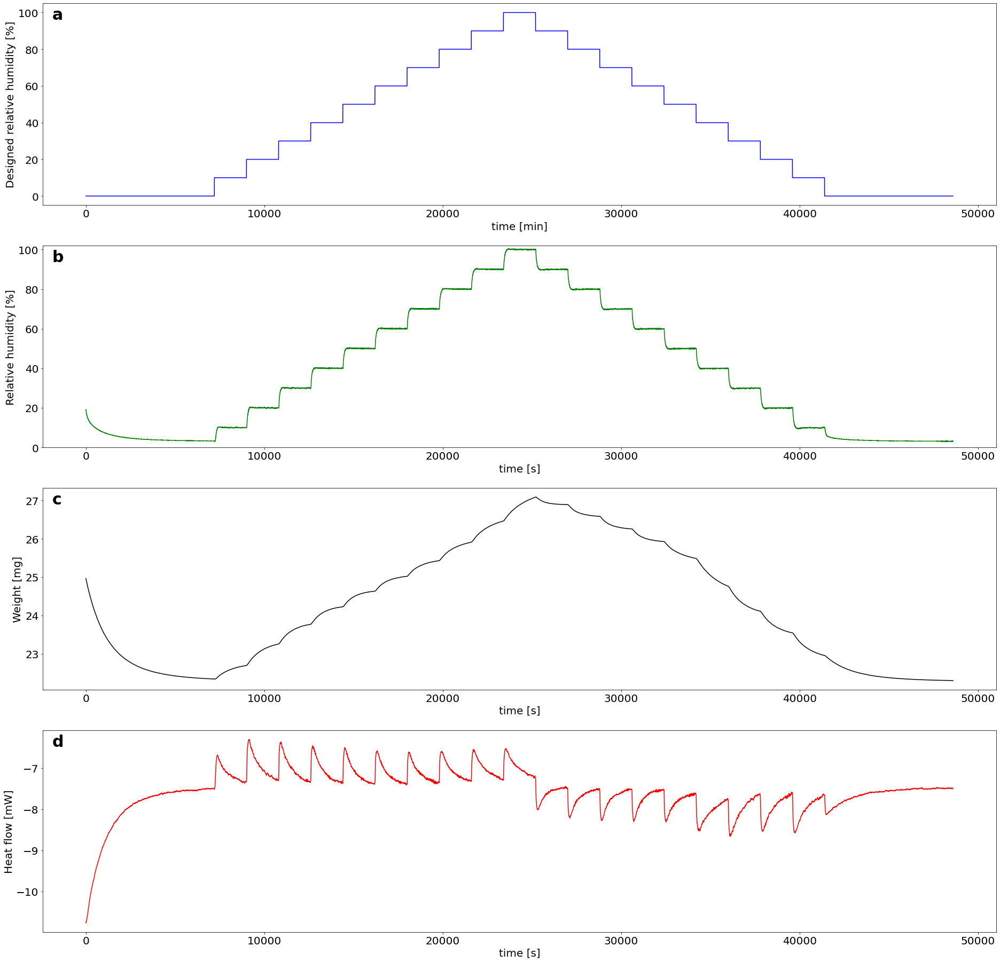

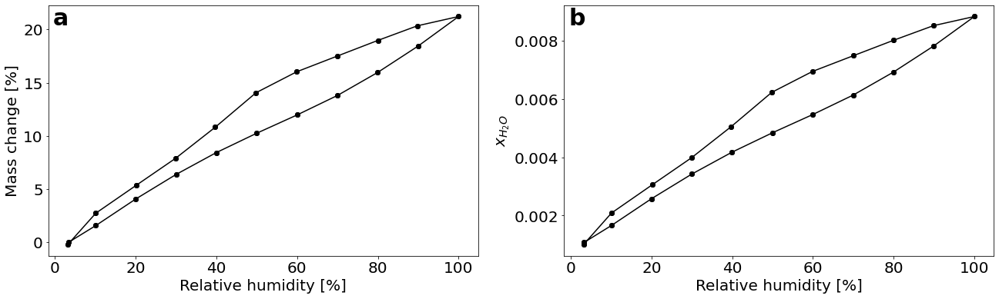

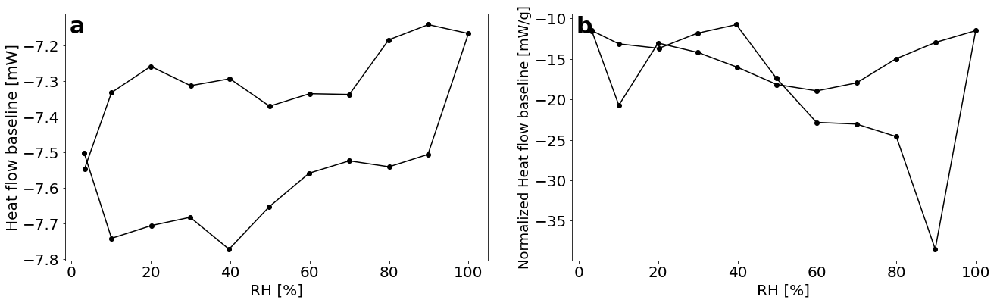

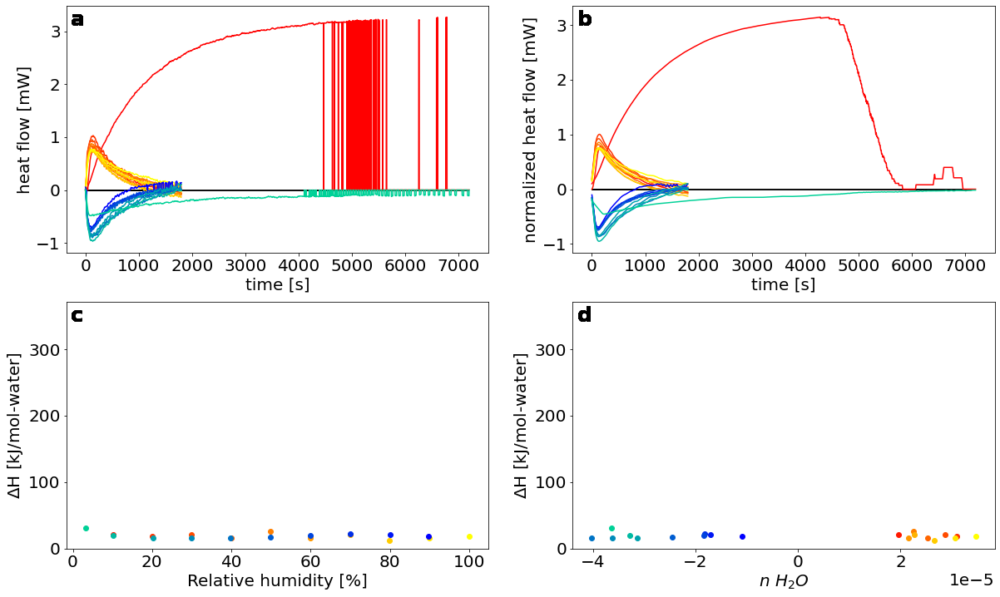

In [61]:
chgc_mass_25mg.chgc_data(plot=True)
chgc_mass_25mg.chgc_grad_data(plot=False)
chgc_mass_25mg.hydration_quant(fsize=100, hfextrema=1)
chgc_mass_25mg.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

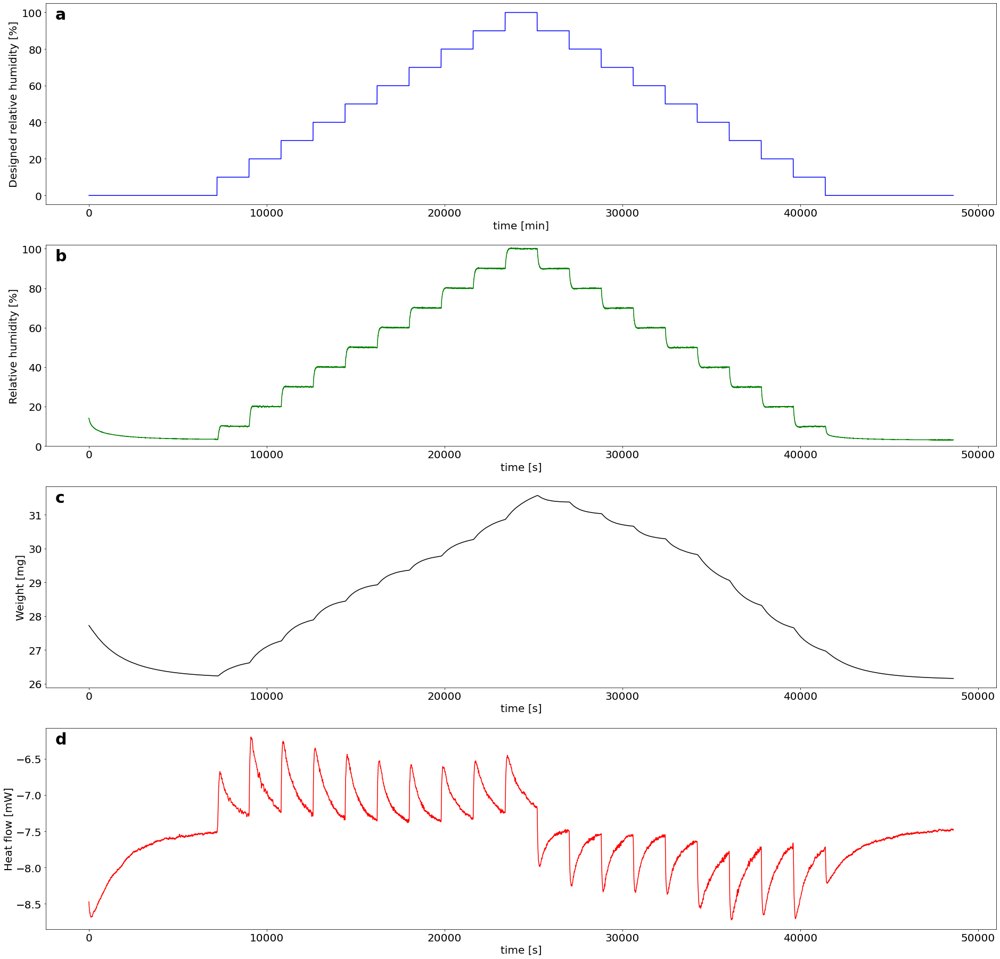

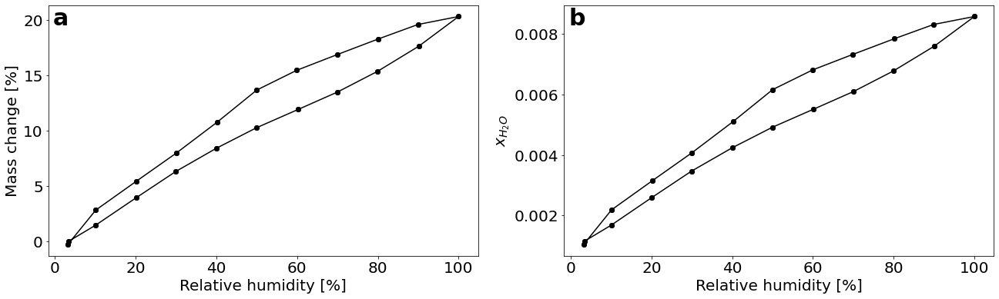

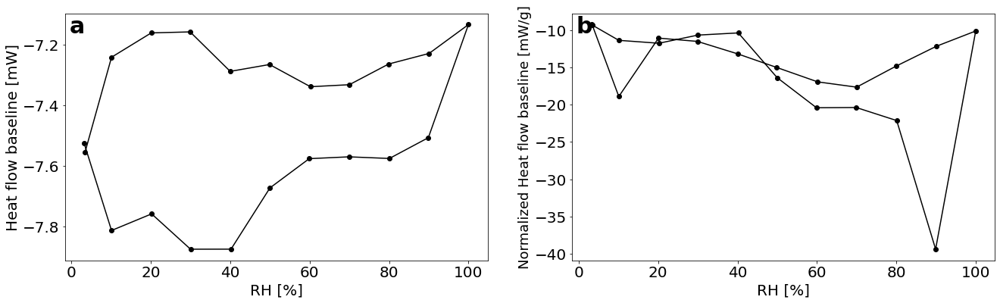

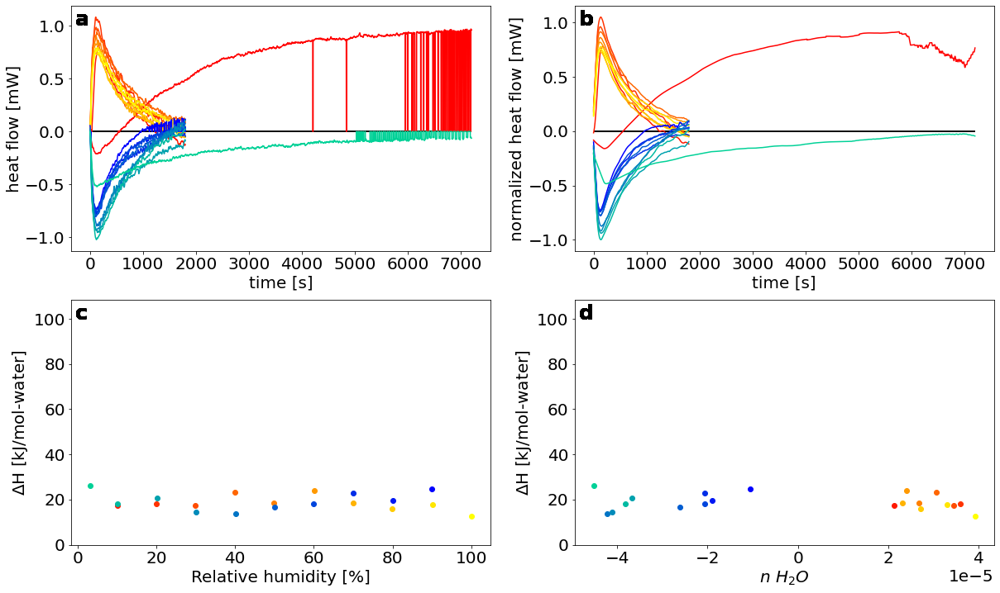

In [62]:
chgc_mass_30mg.chgc_data(plot=True)
chgc_mass_30mg.chgc_grad_data(plot=False)
chgc_mass_30mg.hydration_quant(fsize=100, hfextrema=1)
chgc_mass_30mg.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

#### hysteresis plot

(array([-10.,   0.,  10.,  20.,  30.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

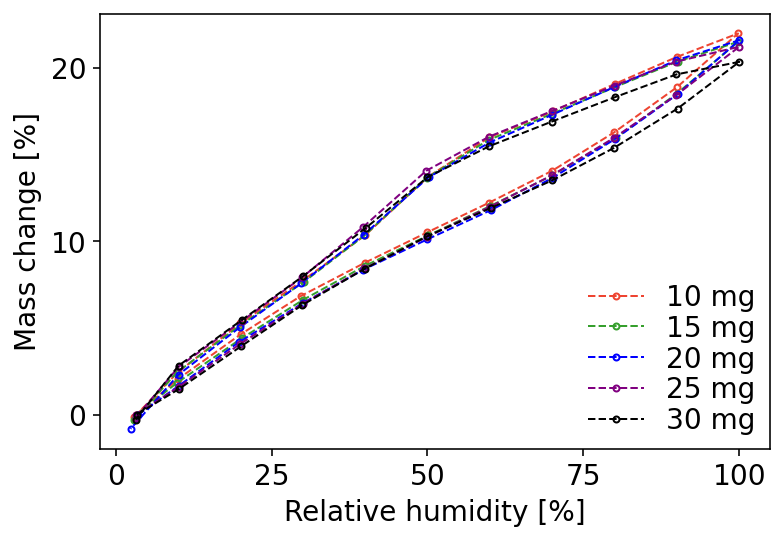

In [109]:

plt.figure(figsize=(6, 4))
plt.plot(chgc_mass_10mg.data['RH'][chgc_mass_10mg.end_segs], 100 * chgc_mass_10mg.mass_frac, marker='o', markersize=3, linestyle='--', label='10 mg', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='#EE4431')
plt.plot(chgc_mass_15mg.data['RH'][chgc_mass_15mg.end_segs], 100 * chgc_mass_15mg.mass_frac, marker='o', markersize=3, linestyle='--', label='15 mg', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='#369F2D')
plt.plot(chgc_mass_20mg.data['RH'][chgc_mass_20mg.end_segs], 100 * chgc_mass_20mg.mass_frac, marker='o', markersize=3, linestyle='--', label='20 mg', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='blue')
plt.plot(chgc_mass_25mg.data['RH'][chgc_mass_25mg.end_segs], 100 * chgc_mass_25mg.mass_frac, marker='o', markersize=3, linestyle='--', label='25 mg', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='purple')
plt.plot(chgc_mass_30mg.data['RH'][chgc_mass_30mg.end_segs], 100 * chgc_mass_30mg.mass_frac, marker='o', markersize=3, linestyle='--', label='30 mg', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='black')
plt.xlabel('Relative humidity [%]', fontsize=14)
plt.ylabel('Mass change [%]', fontsize=14)
plt.legend(fontsize=14, loc='lower right', borderaxespad=0.1, ncol=1, labelspacing=0.1, columnspacing=0.5, frameon=False)#, labelspacing=0.1, columnspacing=0.5, handletextpad=0.1, handlelength=1.5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)



### YT1_RH_Method

In [29]:
chgc_RH_1 = chgc()
chgc_RH_2 = chgc()
chgc_RH_5 = chgc()
chgc_RH_10 = chgc()
chgc_RH_25 = chgc()
chgc_RH_50 = chgc()
chgc_RH_100 = chgc()

In [30]:
chgc_RH_1.import_method('YT1_RH_1_Method\YT1_RH_1_Method.txt')
chgc_RH_1.parse_method()
chgc_RH_2.import_method('YT1_RH_2_Method\YT1_RH_2_Method.txt')
chgc_RH_2.parse_method()
chgc_RH_5.import_method('YT1_RH_5_Method\YT1_RH_5_Method.txt')
chgc_RH_5.parse_method()
chgc_RH_10.import_method('YT1_RH_10_Method\YT1_RH_10_Method.txt')
chgc_RH_10.parse_method()
chgc_RH_25.import_method('YT1_RH_25_Method\YT1_RH_25_Method.txt')
chgc_RH_25.parse_method()
chgc_RH_50.import_method('YT1_RH_50_Method\YT1_RH_50_Method.txt')
chgc_RH_50.parse_method()
chgc_RH_100.import_method('YT1_RH_100_Method\YT1_RH_100_Method.txt')
chgc_RH_100.parse_method()

In [31]:
chgc_RH_1.import_csv('YT1_RH_1_Method\YT1_RH_1.txt', preprocess=True)
chgc_RH_2.import_csv('YT1_RH_2_Method\YT1_RH_2.txt', preprocess=True)
chgc_RH_5.import_csv('YT1_RH_5_Method\YT1_RH_5.txt', preprocess=True)
chgc_RH_10.import_csv('YT1_RH_10_Method\YT1_RH_10.txt', preprocess=True)
chgc_RH_25.import_csv('YT1_RH_25_Method\YT1_RH_25.txt', preprocess=True)
chgc_RH_50.import_csv('YT1_RH_50_Method\YT1_RH_50.txt', preprocess=True)
chgc_RH_100.import_csv('YT1_RH_100_Method\YT1_RH_100.txt', preprocess=True)

In [32]:
# chgc_RH_1.exclude_segments(segs=[1])
# chgc_RH_2.exclude_segments(segs=[1])
# chgc_RH_5.exclude_segments(segs=[1])
# chgc_RH_10.exclude_segments(segs=[1])
# chgc_RH_25.exclude_segments(segs=[1])
# chgc_RH_50.exclude_segments(segs=[1])
# chgc_RH_100.exclude_segments(segs=[1])

chgc_RH_1.data_gradient(sm=1*10**-3)
chgc_RH_2.data_gradient(sm=1*10**-3)
chgc_RH_5.data_gradient(sm=1*10**-3)
chgc_RH_10.data_gradient(sm=1*10**-3)
chgc_RH_25.data_gradient(sm=1*10**-3)
chgc_RH_50.data_gradient(sm=1*10**-3)
chgc_RH_100.data_gradient(sm=1*10**-3)

c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


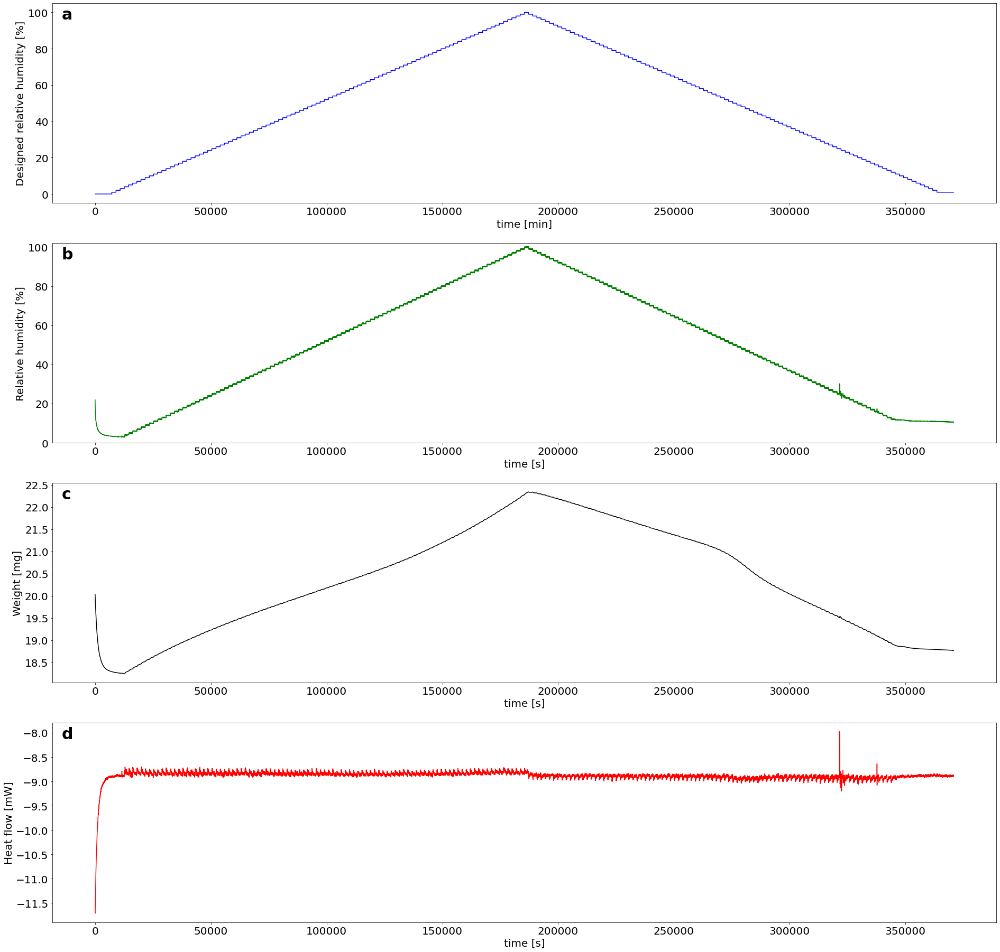

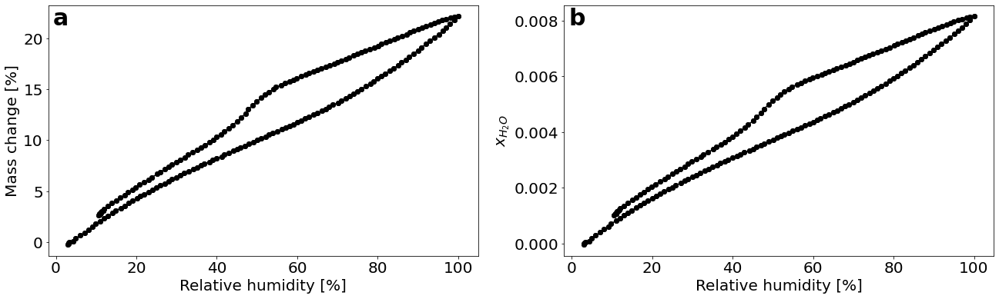

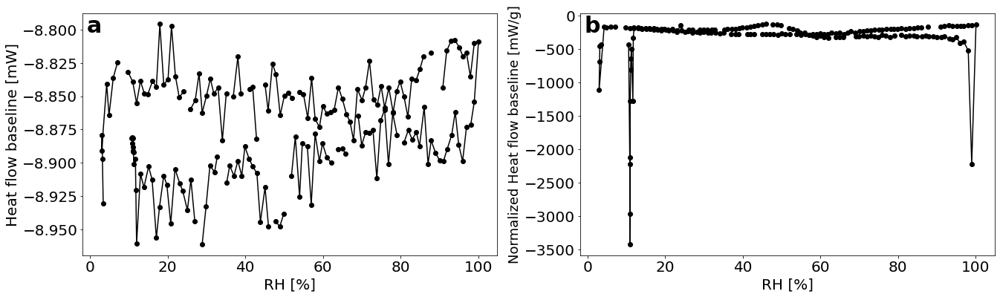

IndexError: index 101 is out of bounds for axis 0 with size 101

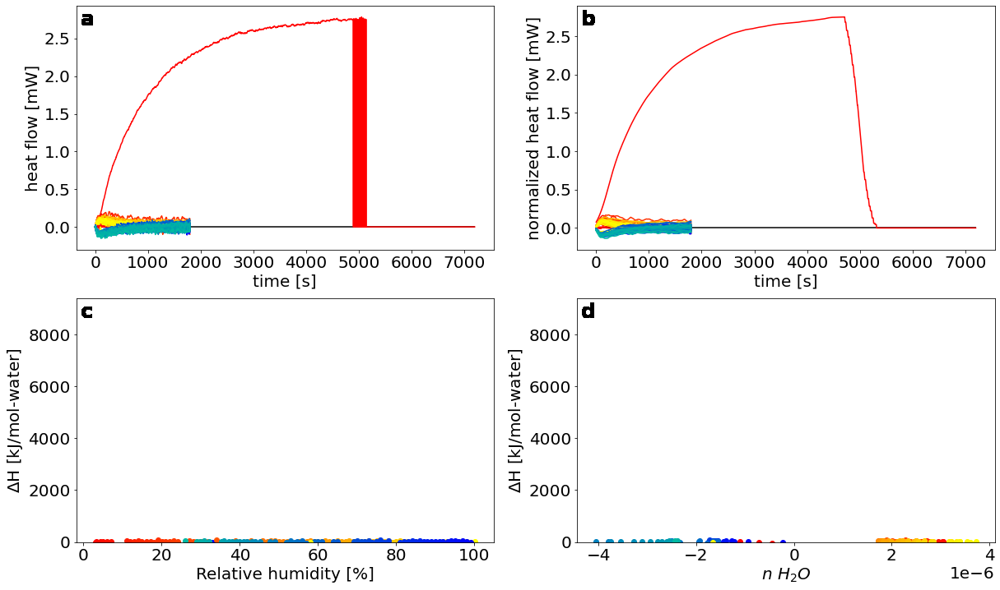

In [33]:
chgc_RH_1.chgc_data(plot=True)
chgc_RH_1.chgc_grad_data(plot=False)
chgc_RH_1.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_1.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
c:\Users\yunti\anaconda3\lib\site-packages\numpy\core\_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


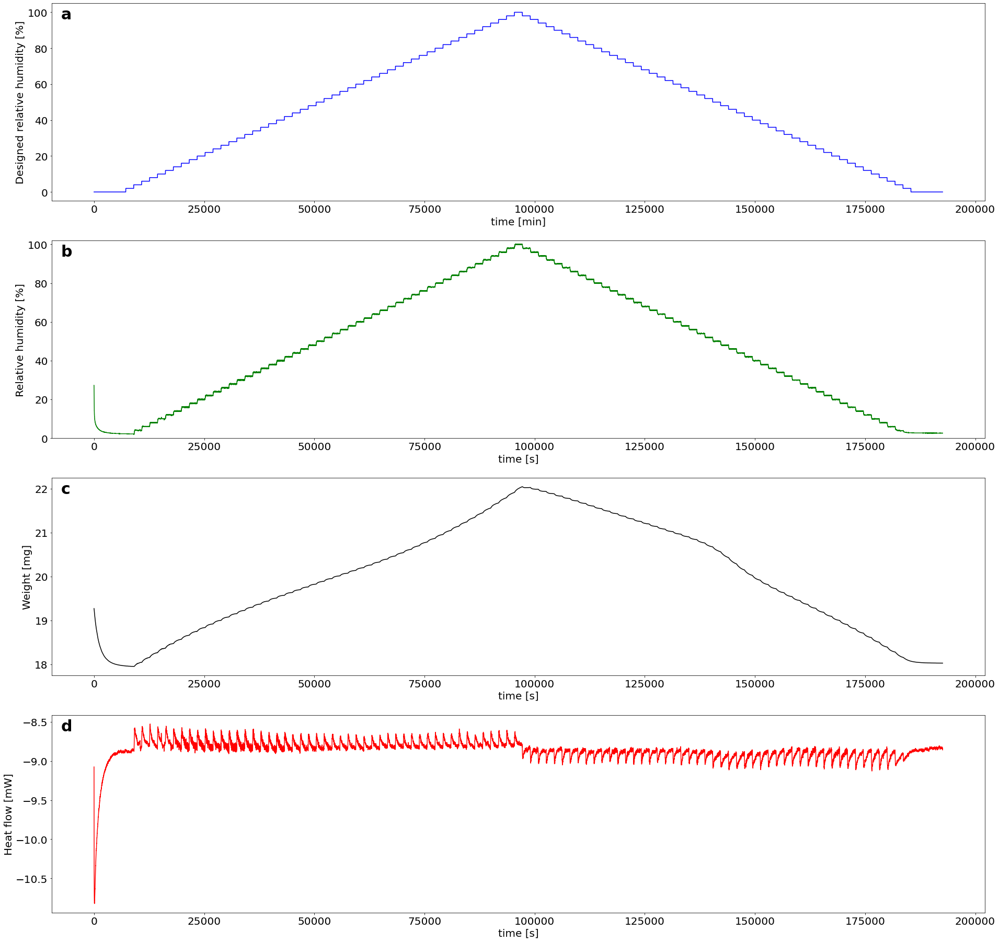

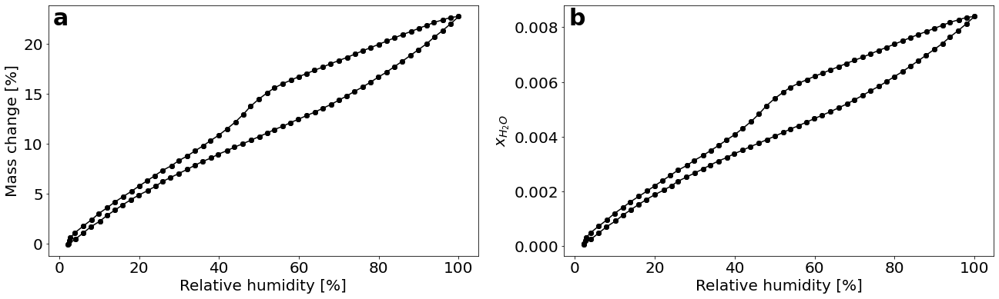

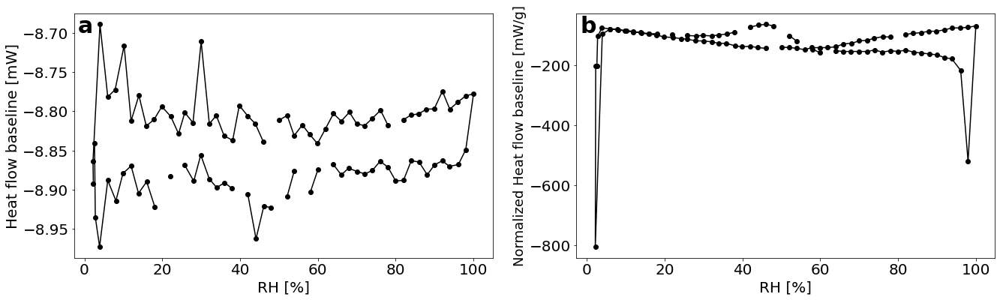

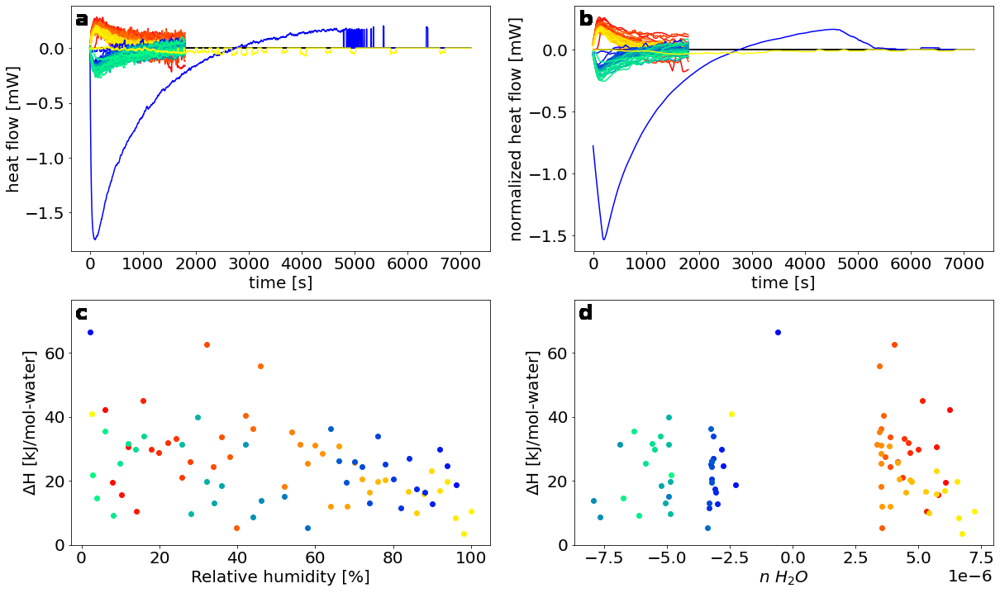

In [34]:
chgc_RH_2.chgc_data(plot=True)
chgc_RH_2.chgc_grad_data(plot=False)
chgc_RH_2.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_2.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

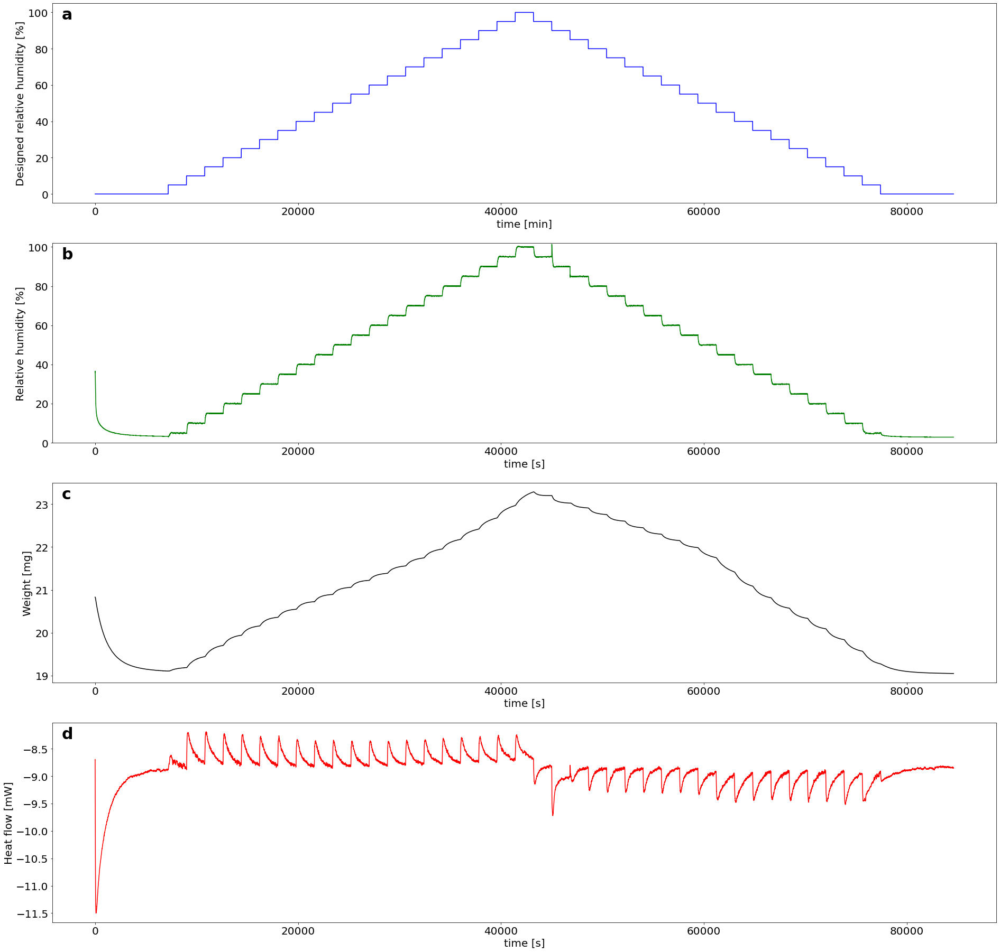

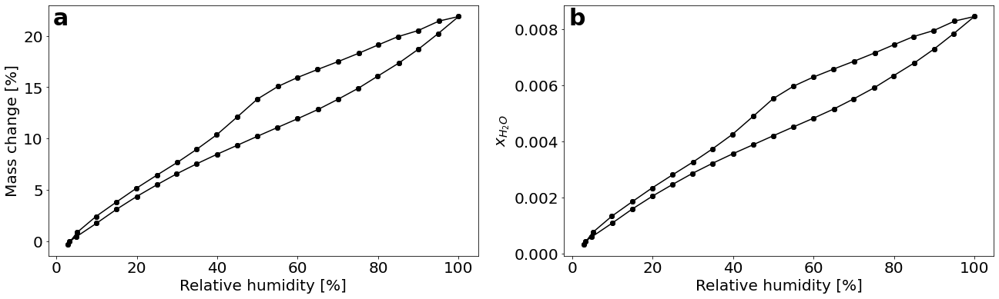

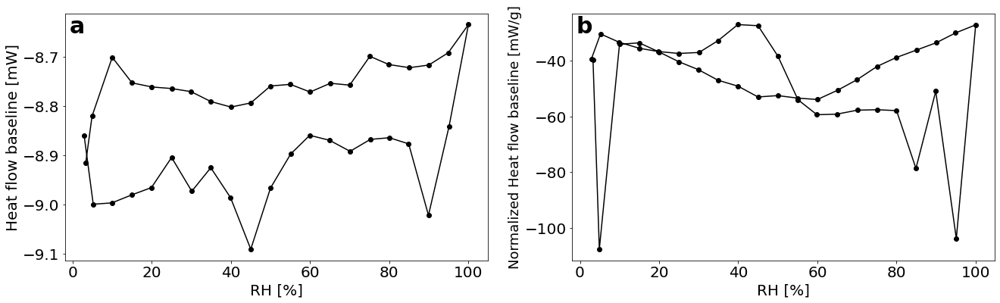

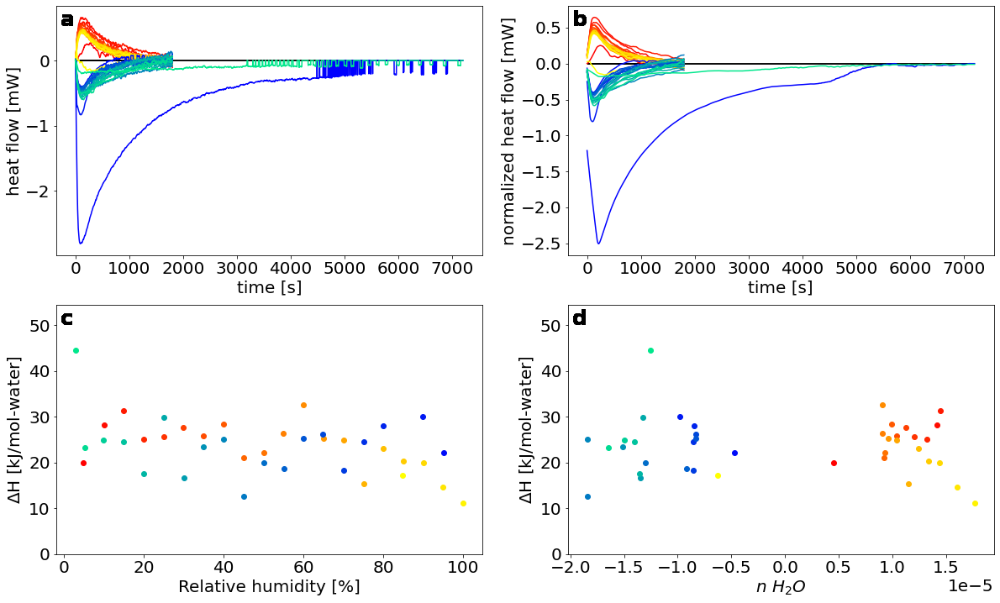

In [35]:
chgc_RH_5.chgc_data(plot=True)
chgc_RH_5.chgc_grad_data(plot=False)
chgc_RH_5.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_5.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

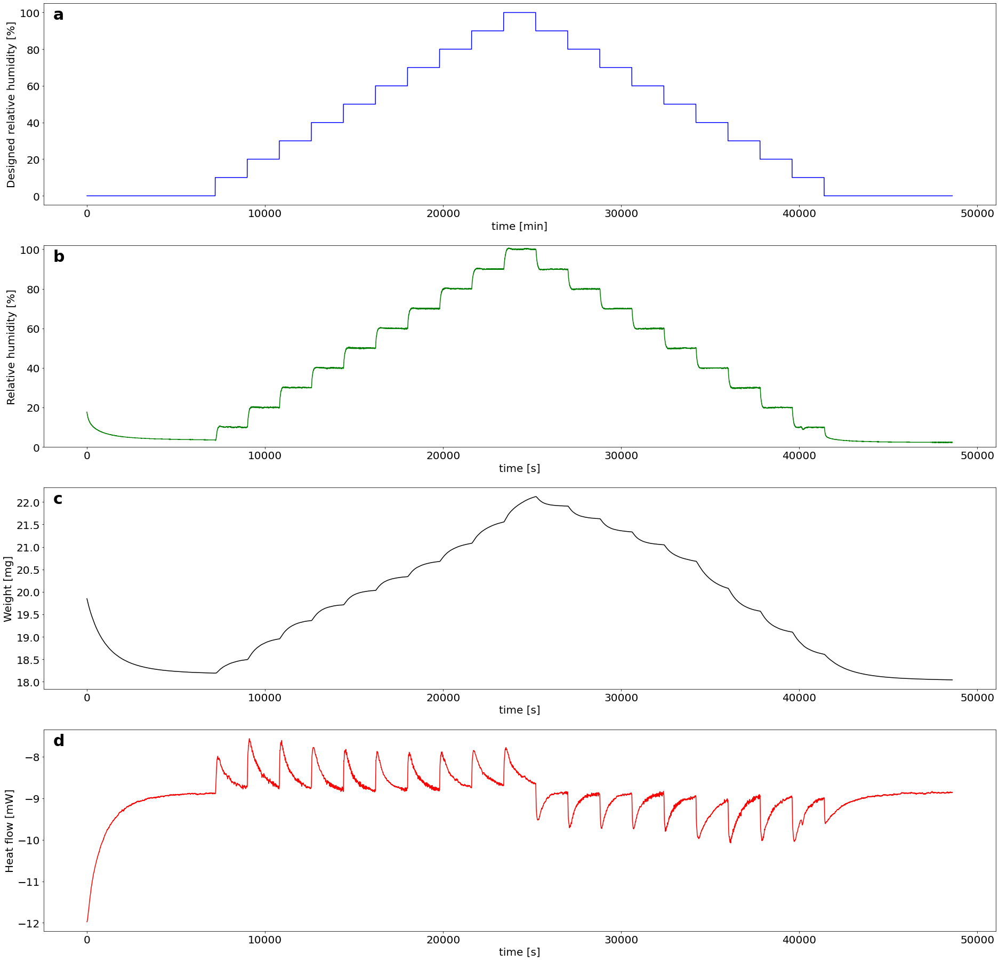

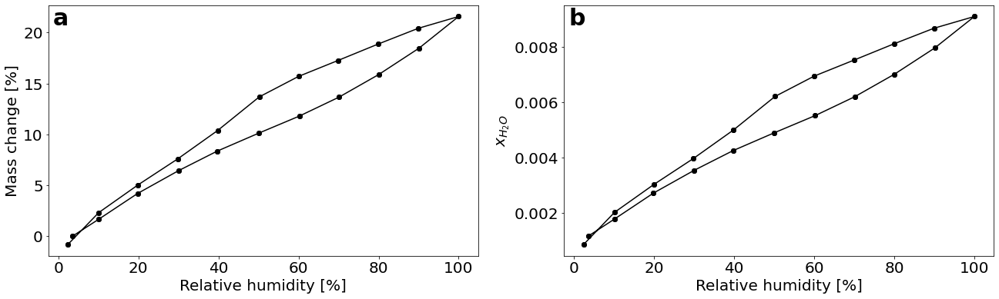

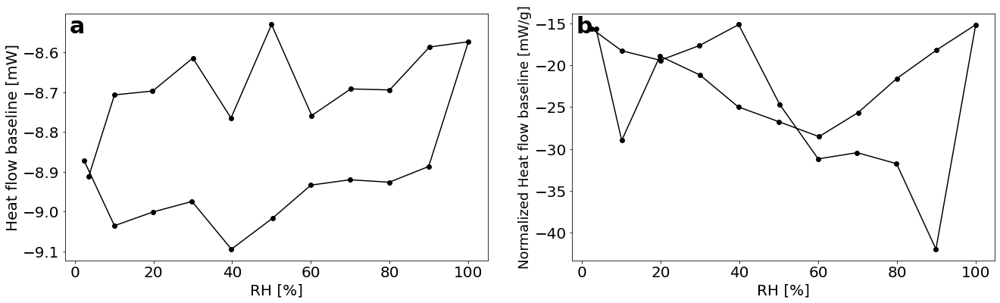

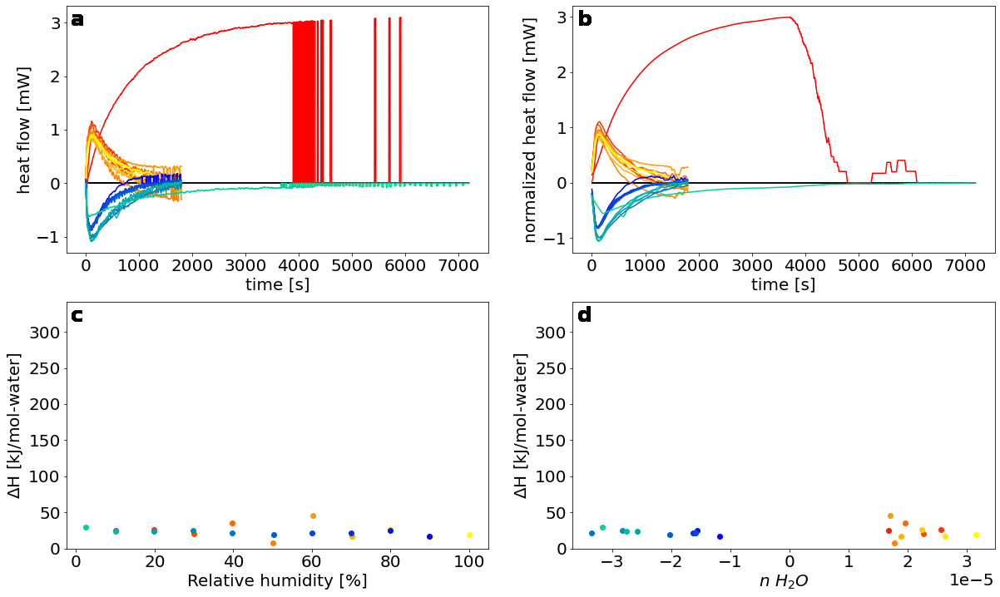

In [36]:
chgc_RH_10.chgc_data(plot=True)
chgc_RH_10.chgc_grad_data(plot=False)
chgc_RH_10.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_10.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

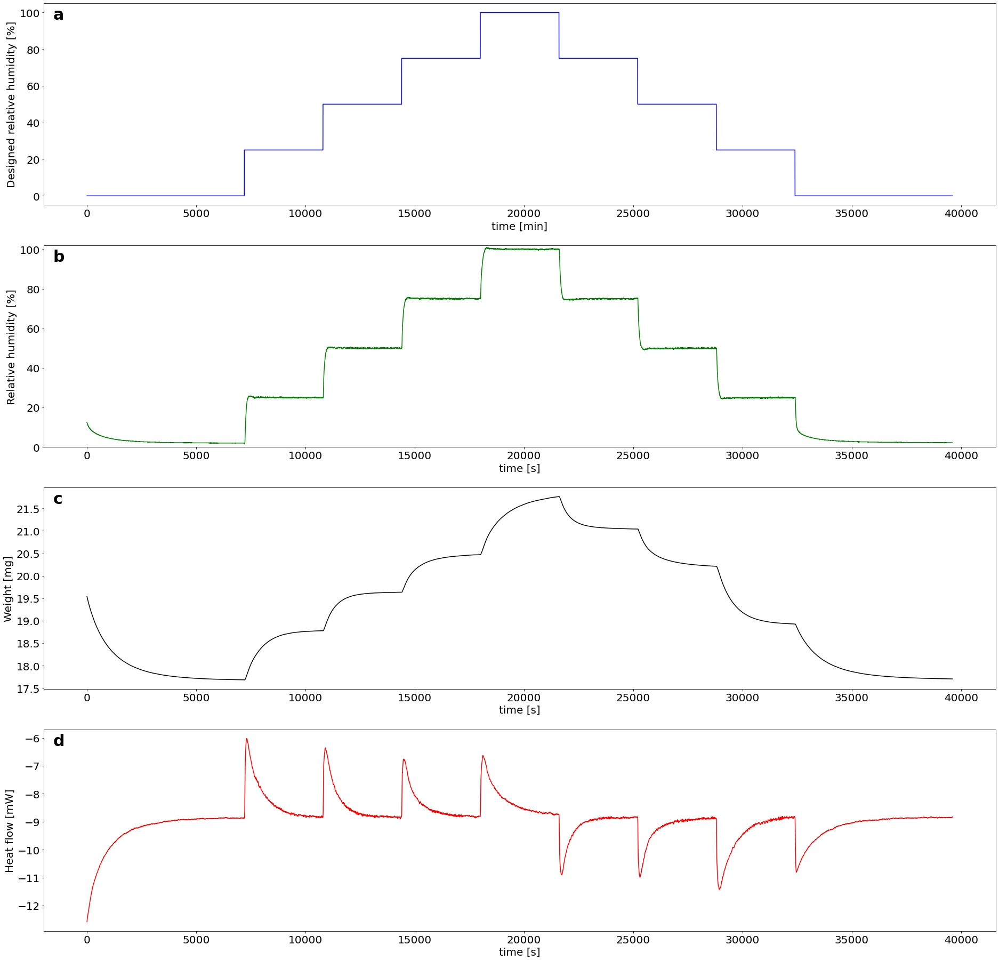

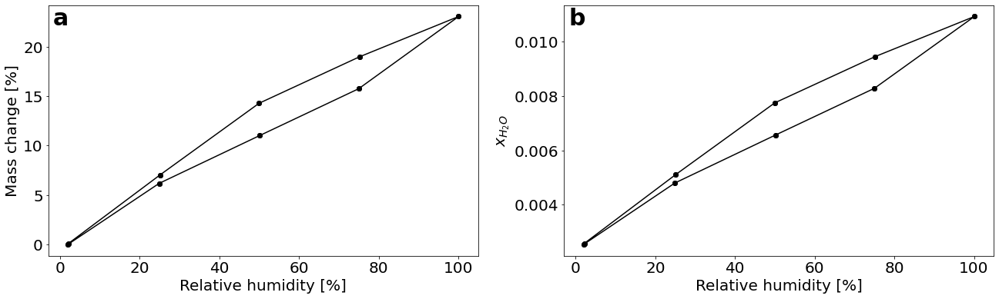

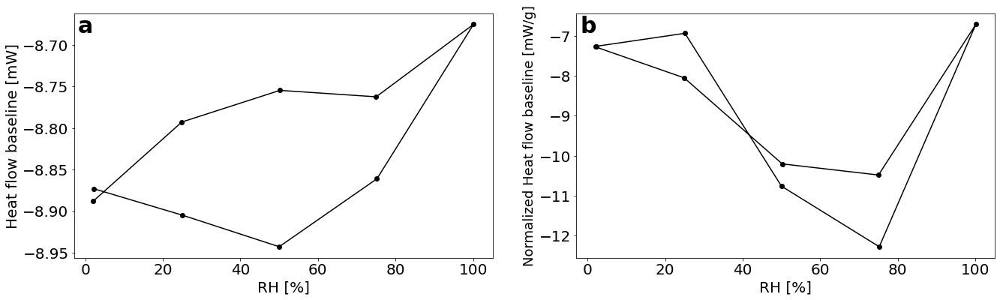

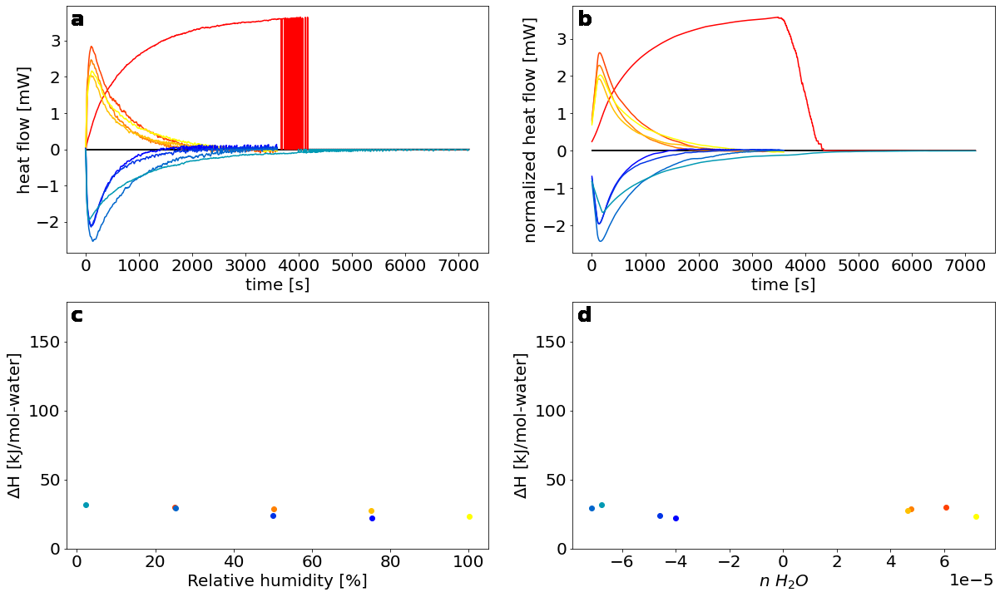

In [37]:
chgc_RH_25.chgc_data(plot=True)
chgc_RH_25.chgc_grad_data(plot=False)
chgc_RH_25.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_25.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

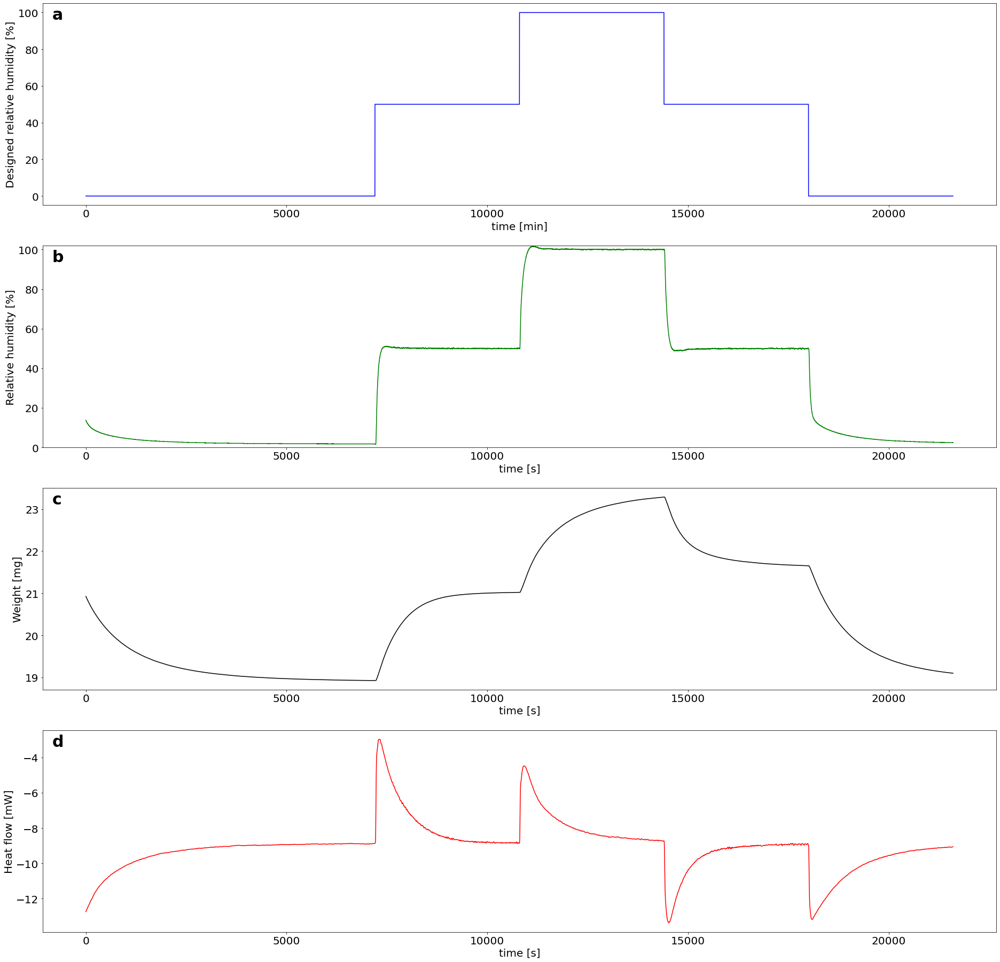

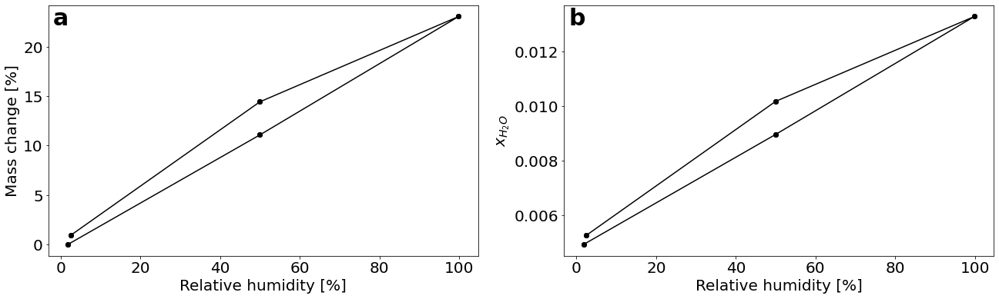

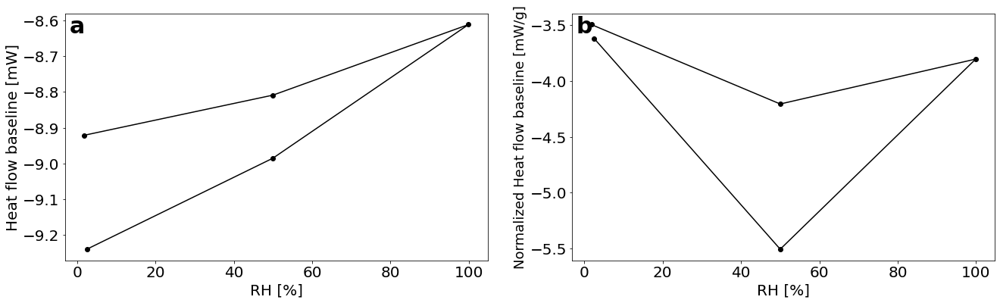

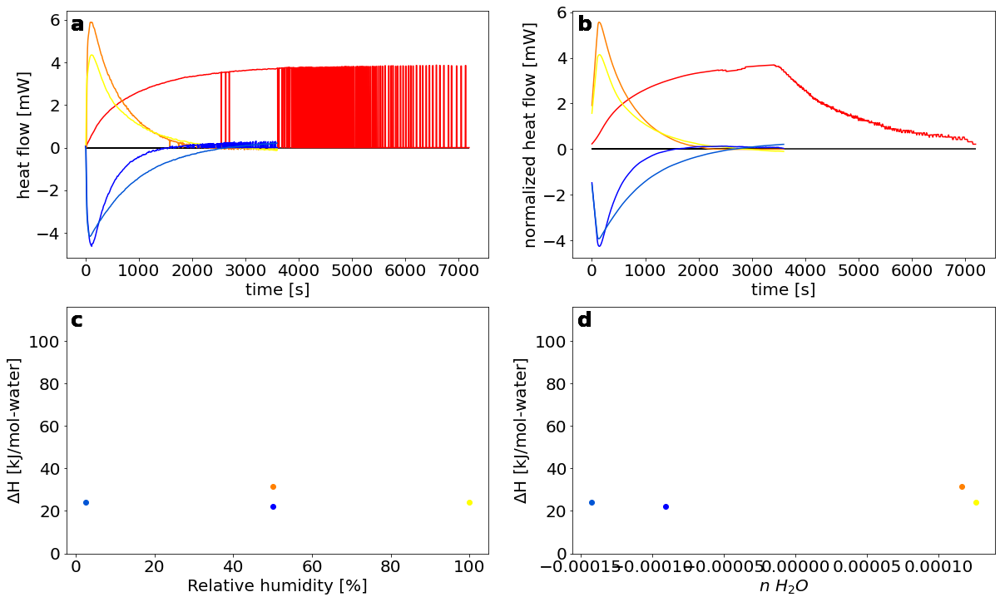

In [38]:
chgc_RH_50.chgc_data(plot=True)
chgc_RH_50.chgc_grad_data(plot=False)
chgc_RH_50.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_50.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

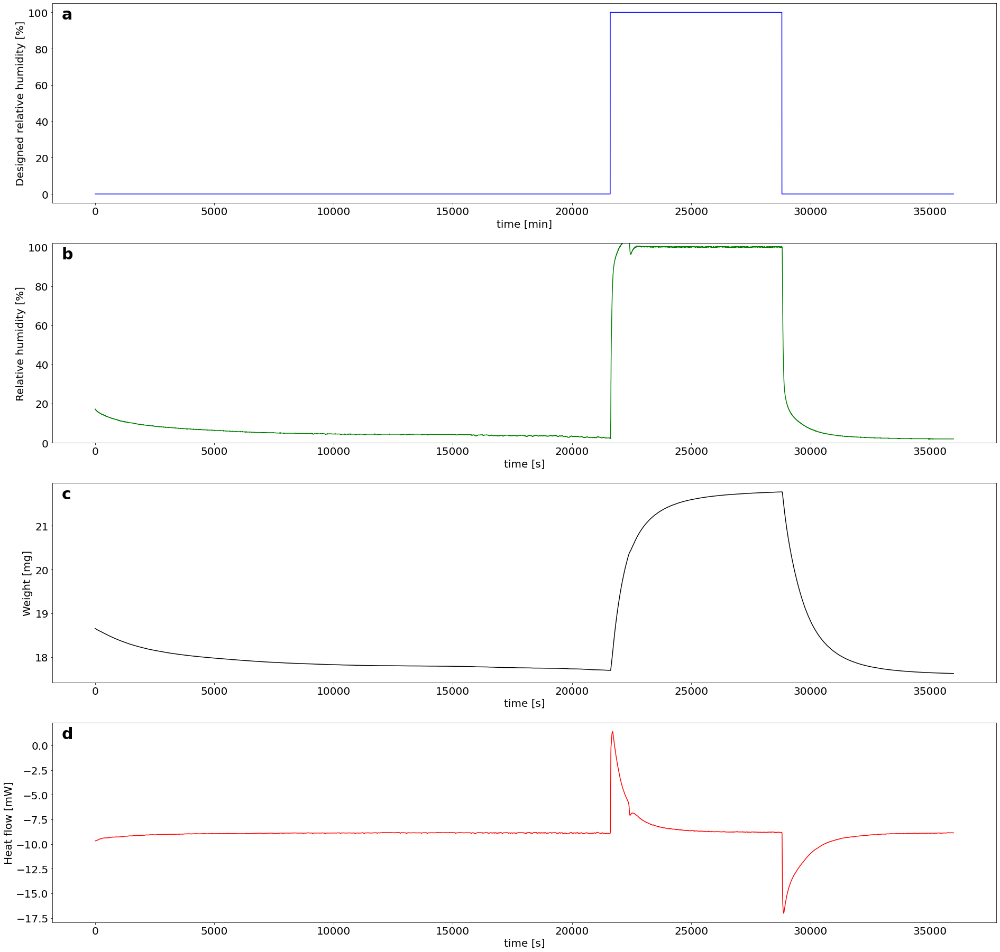

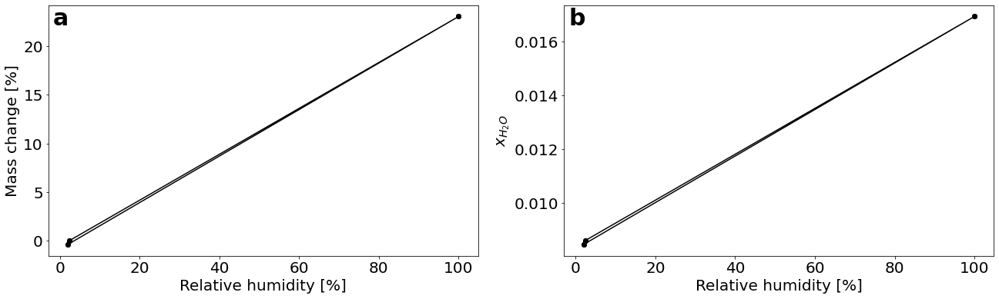

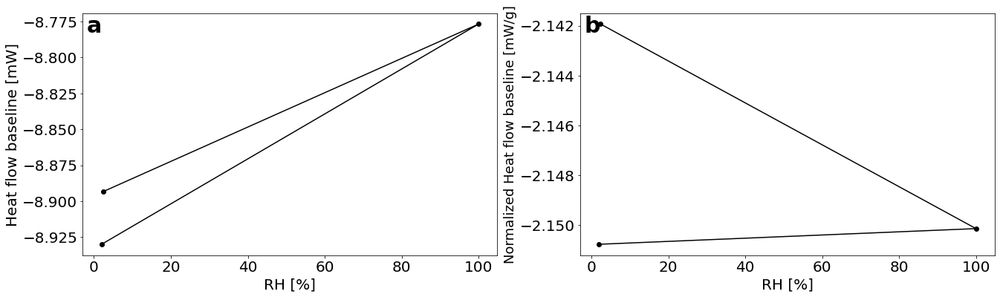

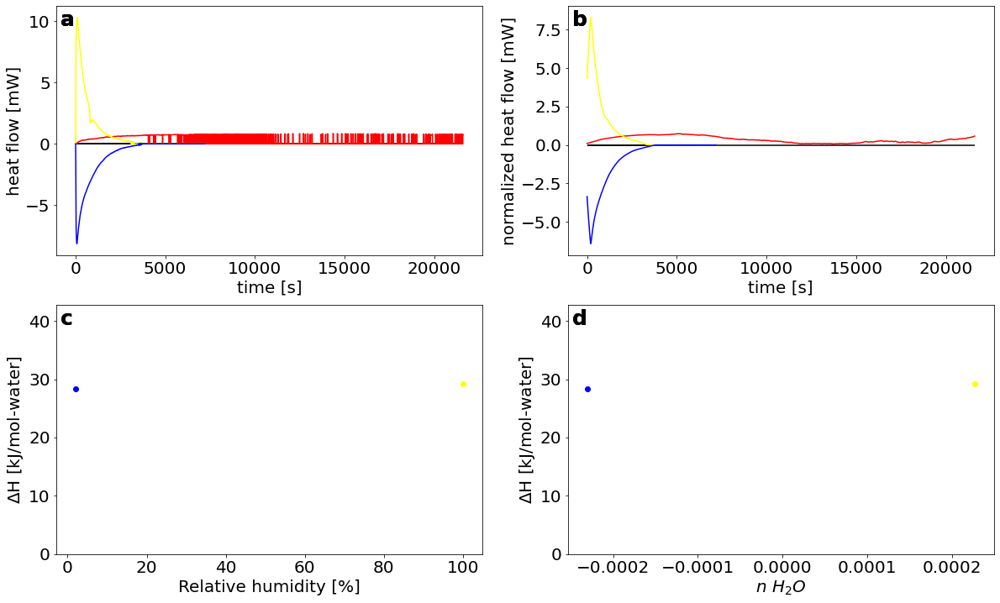

In [39]:
chgc_RH_100.chgc_data(plot=True)
chgc_RH_100.chgc_grad_data(plot=False)
chgc_RH_100.hydration_quant(fsize=100, hfextrema=1)
chgc_RH_100.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

#### hysteresis plot

(array([-10.,   0.,  10.,  20.,  30.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

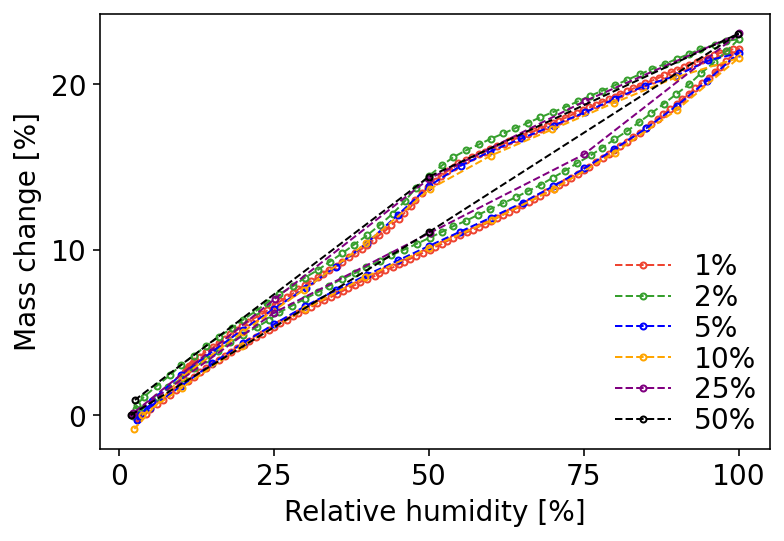

In [110]:
# from matplotlib import cm
# color_map = cm.get_cmap('tab10')
plt.figure(figsize=(6, 4))
plt.plot(chgc_RH_1.data['RH'][chgc_RH_1.end_segs], 100 * chgc_RH_1.mass_frac, marker='o', markersize=3, linestyle='--', label='1%',  markeredgewidth=1, linewidth='1', color='#EE4431', markerfacecolor='none')#, color=color_map(0.1/10)) #markerfacecolor='none',
plt.plot(chgc_RH_2.data['RH'][chgc_RH_2.end_segs], 100 * chgc_RH_2.mass_frac, marker='o', markersize=3, linestyle='--', label='2%',  markeredgewidth=1, linewidth='1', color='#369F2D', markerfacecolor='none')#, color=color_map(1/10))
plt.plot(chgc_RH_5.data['RH'][chgc_RH_5.end_segs], 100 * chgc_RH_5.mass_frac, marker='o', markersize=3, linestyle='--', label='5%', markeredgewidth=1, linewidth='1', color ='blue', markerfacecolor='none')#, color=color_map(2/10))
plt.plot(chgc_RH_10.data['RH'][chgc_RH_10.end_segs], 100 * chgc_RH_10.mass_frac, marker='o', markersize=3, linestyle='--', label='10%',  markeredgewidth=1,linewidth='1', color='orange', markerfacecolor='none')#, color=color_map(3/10))
plt.plot(chgc_RH_25.data['RH'][chgc_RH_25.end_segs], 100 * chgc_RH_25.mass_frac, marker='o', markersize=3, linestyle='--', label='25%',  markeredgewidth=1,linewidth='1', color='purple', markerfacecolor='none')#, color=color_map(4/10))
plt.plot(chgc_RH_50.data['RH'][chgc_RH_50.end_segs], 100 * chgc_RH_50.mass_frac, marker='o', markersize=3, linestyle='--', label='50%',  markeredgewidth=1, linewidth='1', color='BLACK', markerfacecolor='none')#, color=color_map(5/10))
plt.xlabel('Relative humidity [%]', fontsize=14)
plt.ylabel('Mass change [%]', fontsize=14)
plt.legend(fontsize=14, loc='lower right', borderaxespad=0.1, ncol=1, labelspacing=0.1, columnspacing=0.5, frameon=False)#, labelspacing=0.1, columnspacing=0.5, handletextpad=0.1, handlelength=1.5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# 设置整体图的尺寸



### YT1_temperature_study_Method

In [277]:
YT1_16C = chgc()
YT1_20C = chgc()
YT1_22C = chgc()
YT1_24C = chgc()
YT1_26C = chgc()

In [278]:
YT1_16C.import_method('YT1_temperature_study_16C_method\YT1_temperature_study_16C_method.txt')
YT1_16C.parse_method()
YT1_16C.import_csv('YT1_temperature_study_16C_method\YT1_16C_2h_1.txt', preprocess=True)
YT1_20C.import_method('YT1_temperature_study_20C_method_2\YT1_temperature_study_20C_method_2.txt')
YT1_20C.parse_method()
YT1_20C.import_csv('YT1_temperature_study_20C_method_2\YT1_20C_longtime.txt', preprocess=False)
YT1_22C.import_method('YT1_temperature_study_22C_5h_method\YT1_temperature_study_22C_5h_method.txt')
YT1_22C.parse_method()
YT1_22C.import_csv('YT1_temperature_study_22C_5h_method\YT1_22C_longtime_5h.txt', preprocess=True)
YT1_24C.import_method('YT1_temperature_study_24C_method\YT1_temperature_study_24C_method.txt')
YT1_24C.parse_method()
YT1_24C.import_csv('YT1_temperature_study_24C_method\YT1_24C_longtime.txt', preprocess=False)
YT1_26C.import_method('YT1_temperature_study_26C_method\YT1_temperature_study_26C_method.txt')
YT1_26C.parse_method()
YT1_26C.import_csv('YT1_temperature_study_26C_method\YT1_26C_2h.txt', preprocess=False)

In [279]:
YT1_16C.exclude_segments(segs=[1])
YT1_20C.exclude_segments(segs=[1])
YT1_22C.exclude_segments(segs=[1])
YT1_24C.exclude_segments(segs=[1])
YT1_26C.exclude_segments(segs=[1])

YT1_16C.data_gradient(sm=1*10**-3)
YT1_20C.data_gradient(sm=1*10**-3)
YT1_22C.data_gradient(sm=1*10**-3)
YT1_24C.data_gradient(sm=1*10**-3)
YT1_26C.data_gradient(sm=1*10**-3)

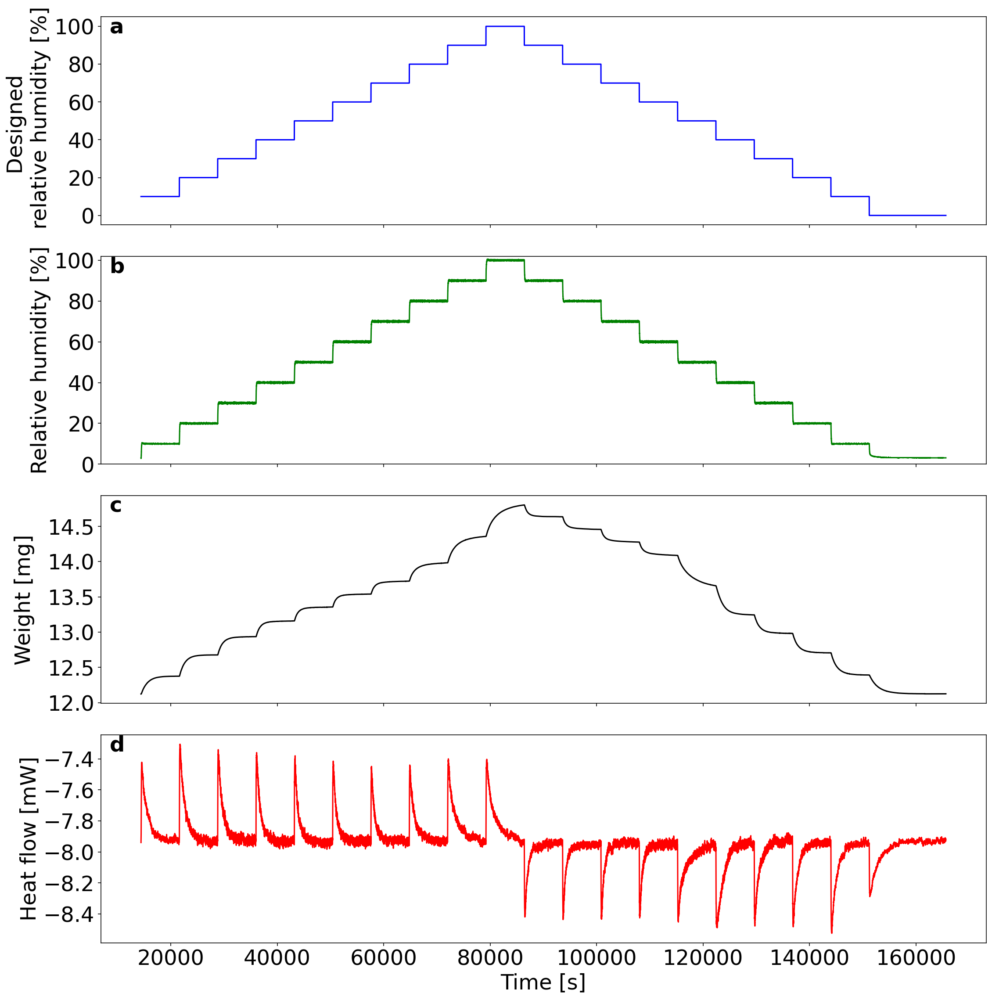

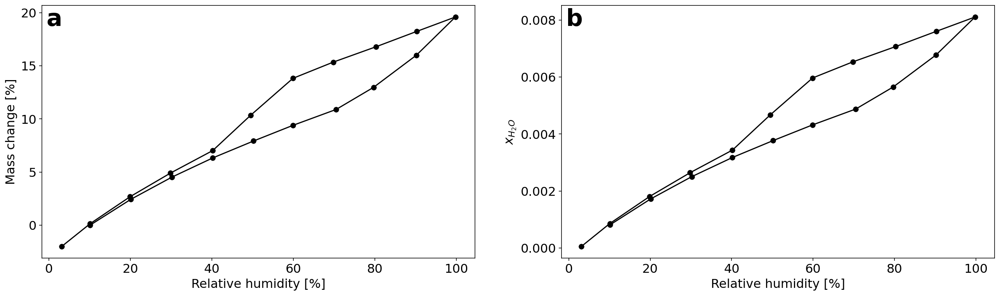

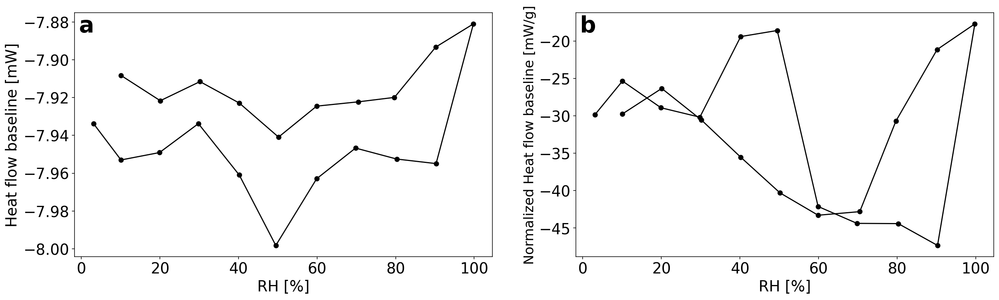

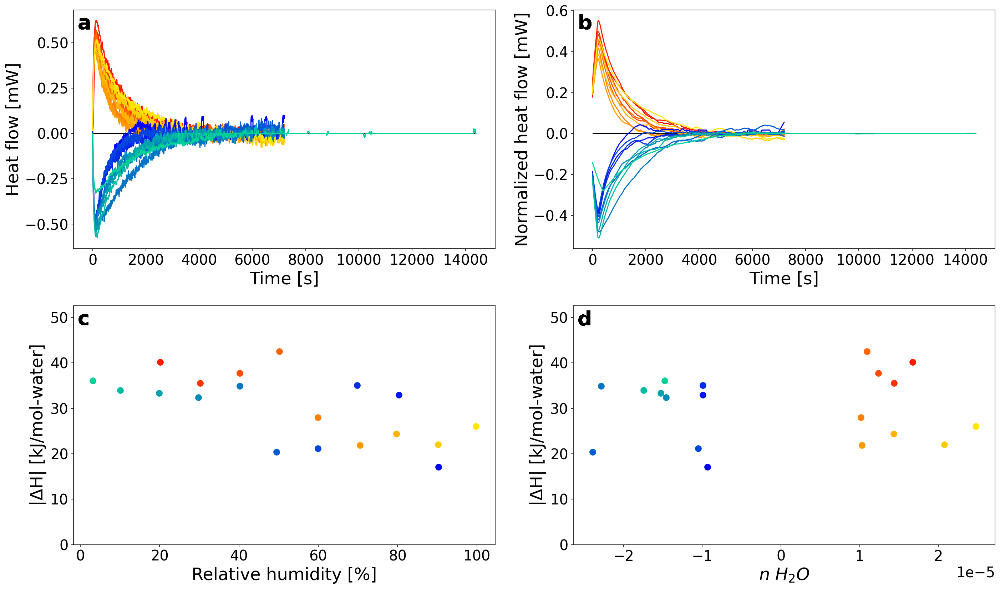

In [280]:
YT1_16C.chgc_data(plot=True)
YT1_16C.chgc_grad_data(plot=False)
YT1_16C.hydration_quant(fsize=100, hfextrema=1)
YT1_16C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

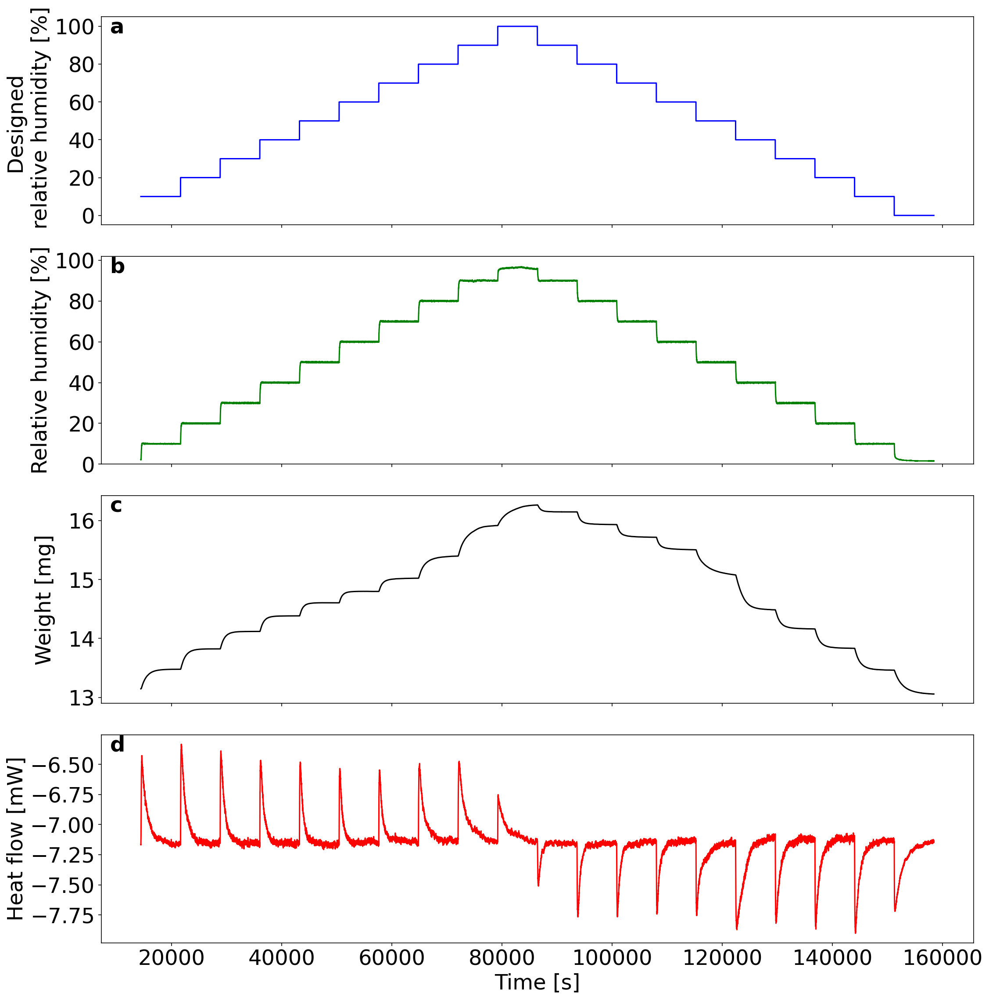

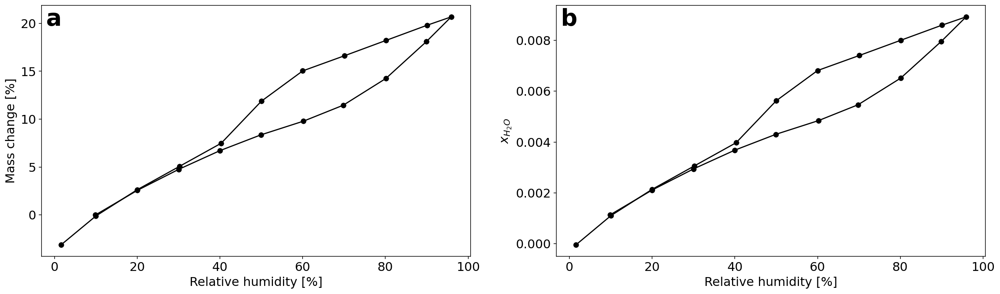

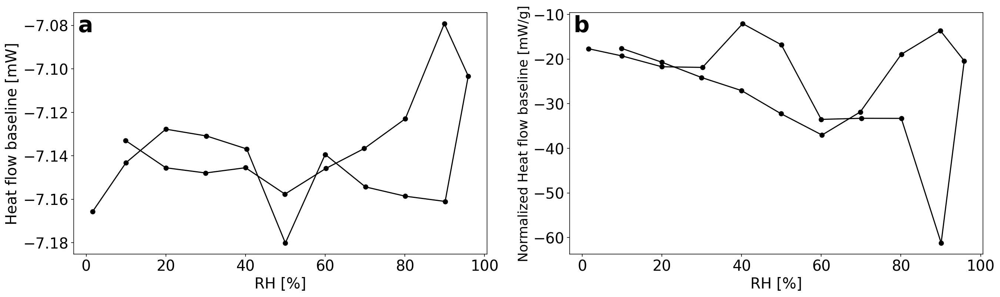

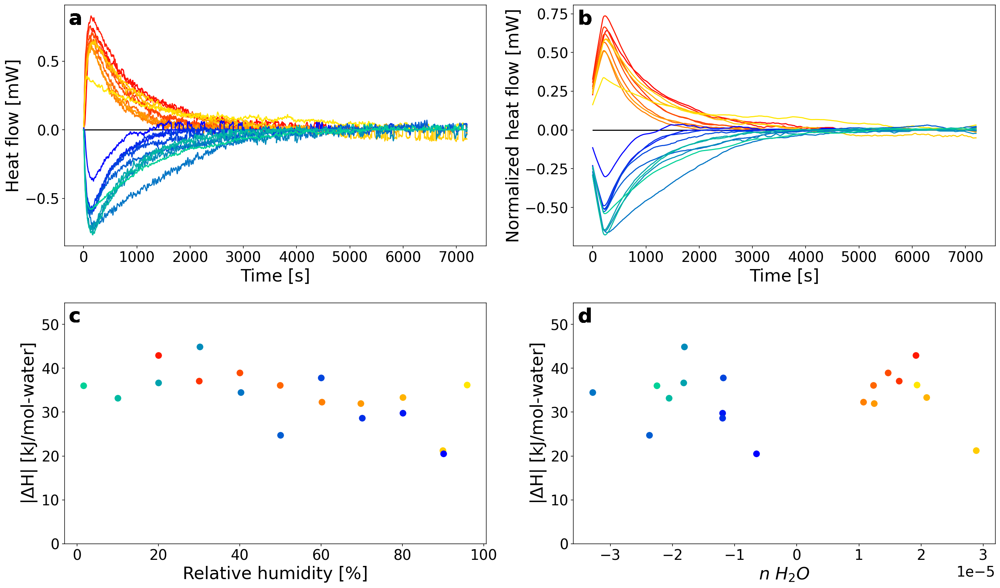

In [281]:
YT1_20C.chgc_data(plot=True)
YT1_20C.chgc_grad_data(plot=False)
YT1_20C.hydration_quant(fsize=100, hfextrema=1)
YT1_20C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

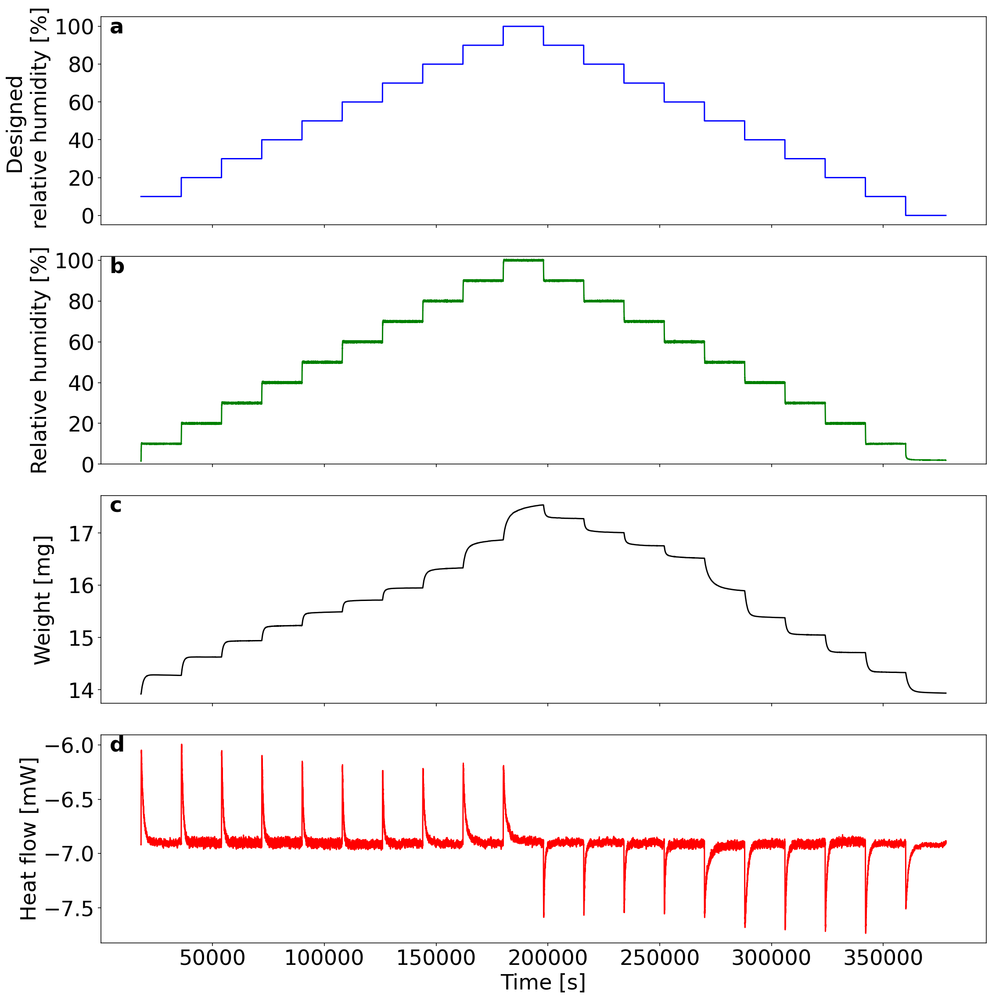

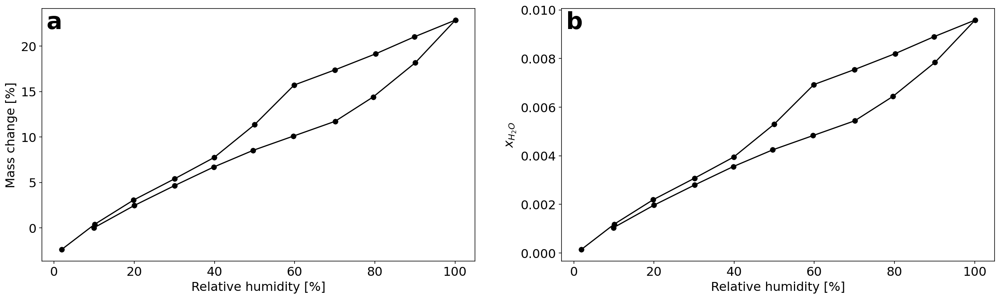

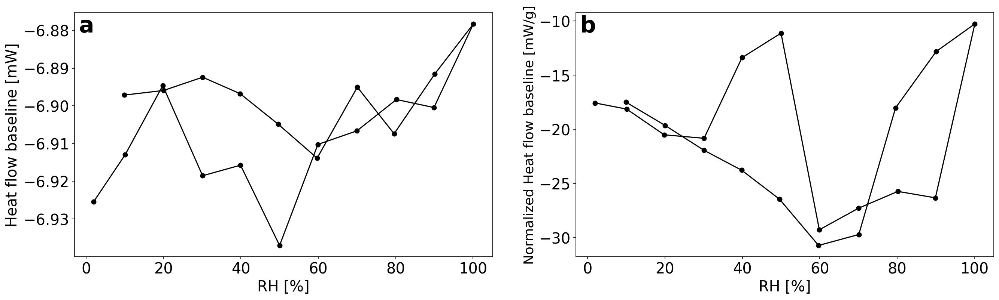

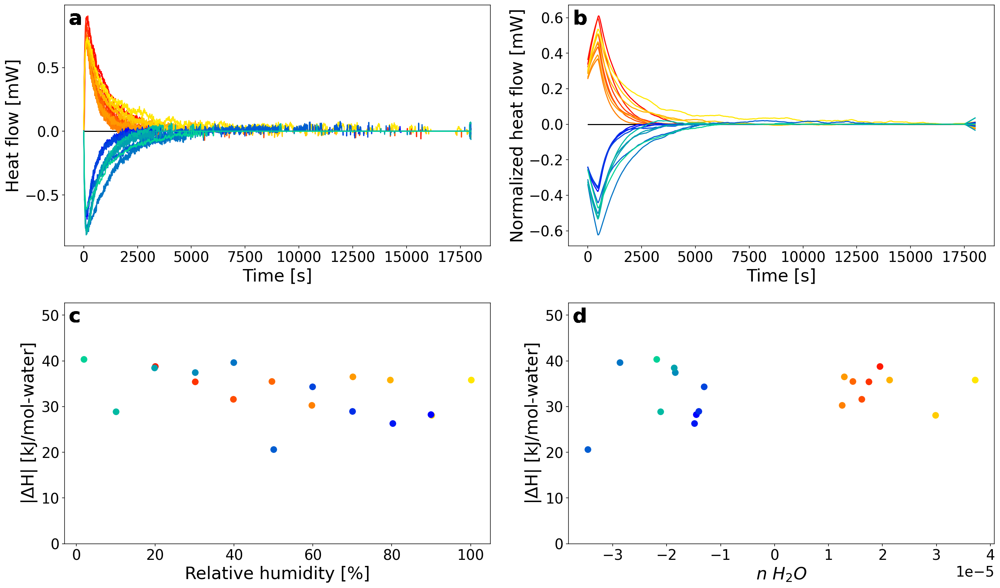

In [282]:
YT1_22C.chgc_data(plot=True)
YT1_22C.chgc_grad_data(plot=False)
YT1_22C.hydration_quant(fsize=100, hfextrema=1)
YT1_22C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

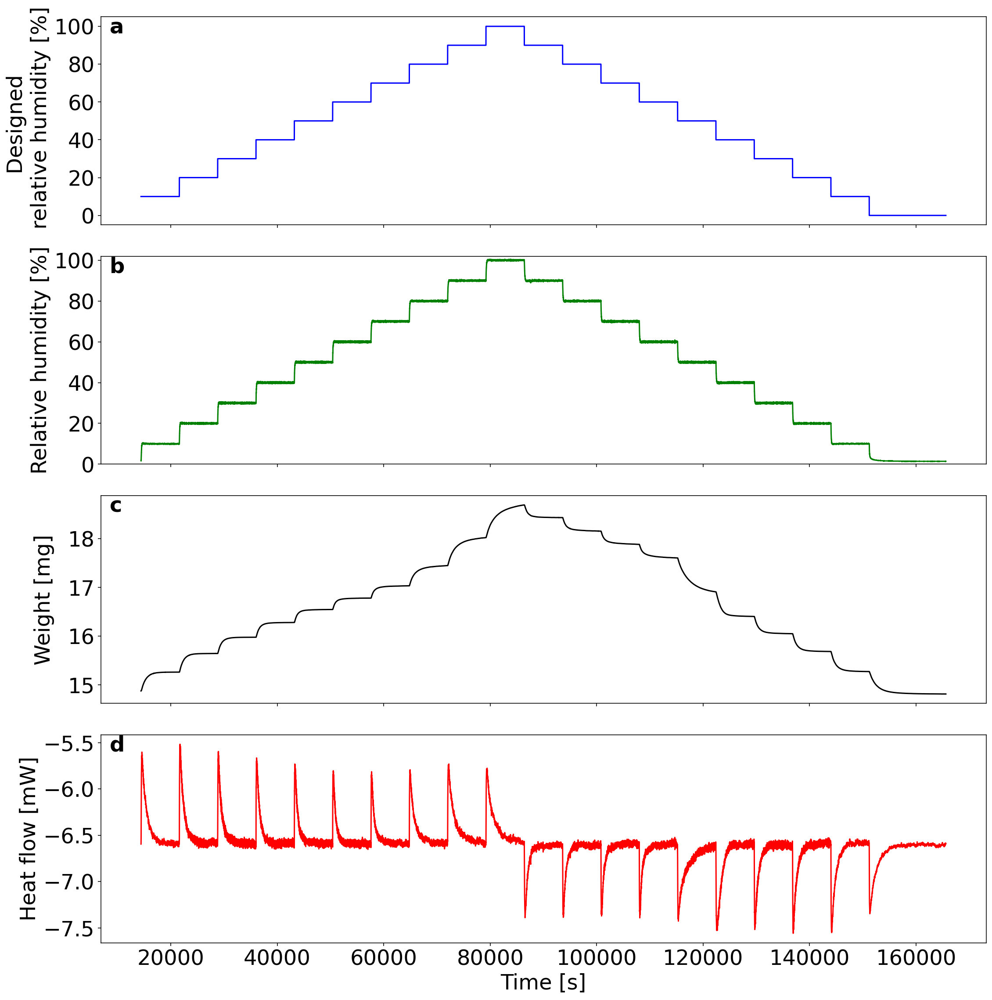

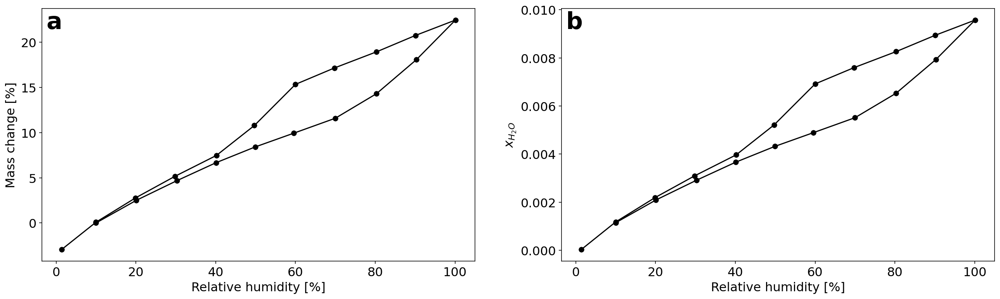

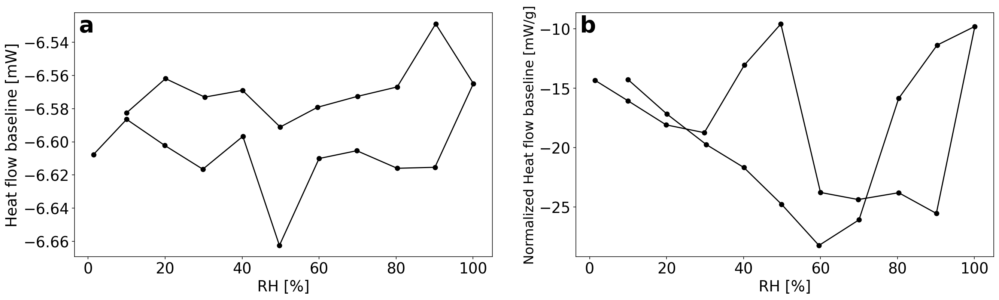

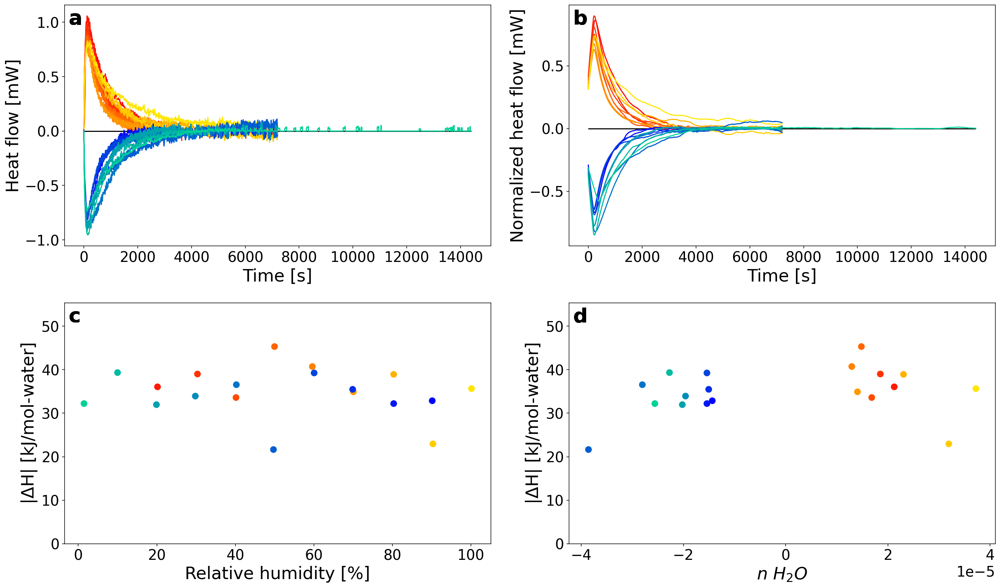

In [283]:
YT1_24C.chgc_data(plot=True)
YT1_24C.chgc_grad_data(plot=False)
YT1_24C.hydration_quant(fsize=100, hfextrema=1)
YT1_24C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

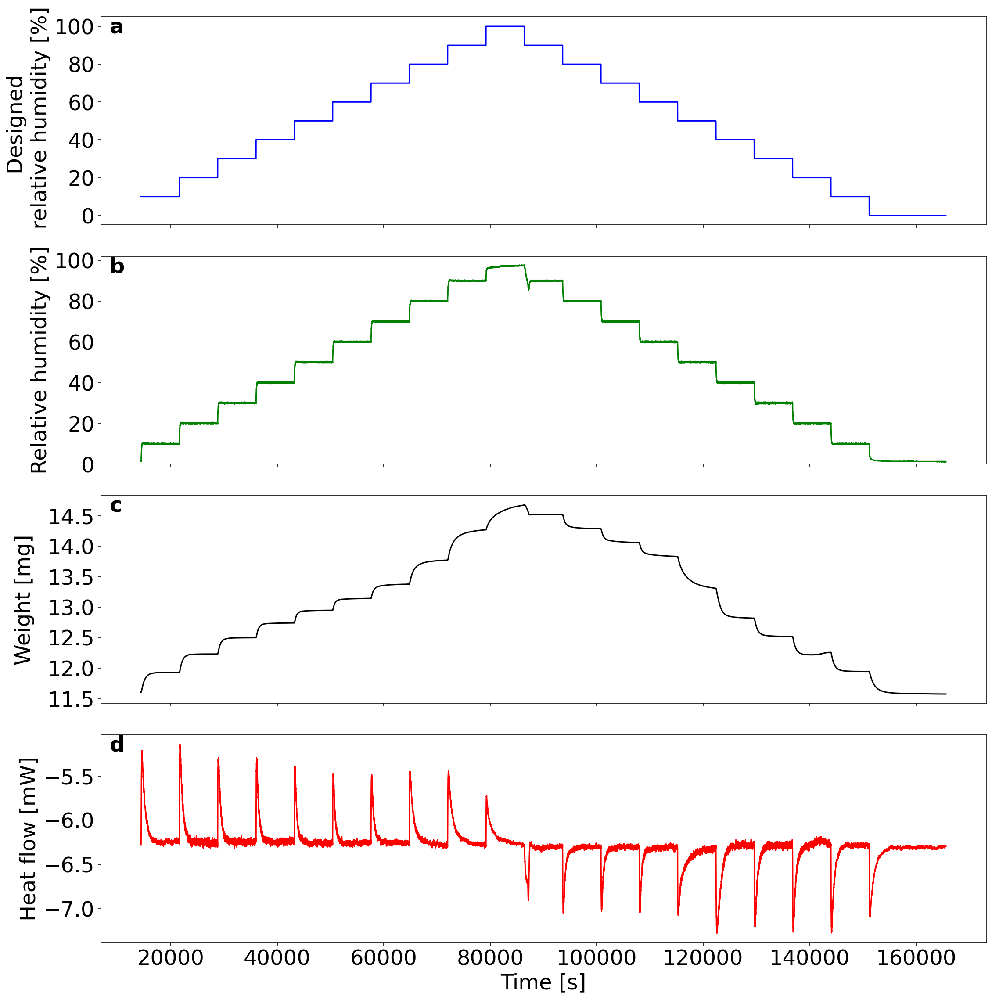

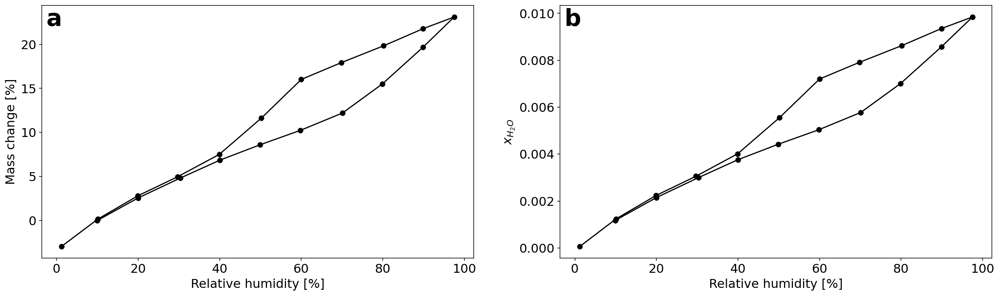

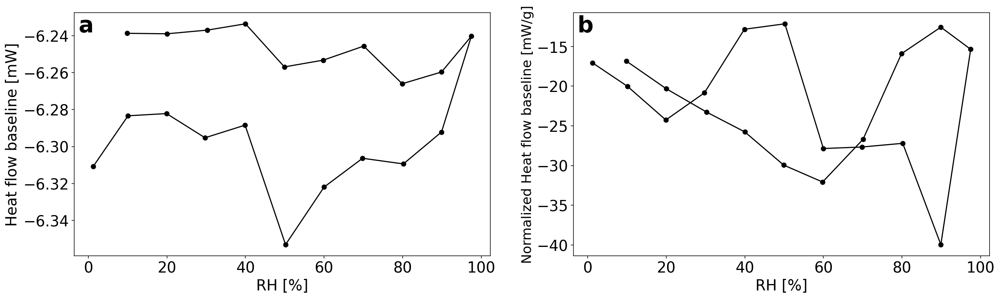

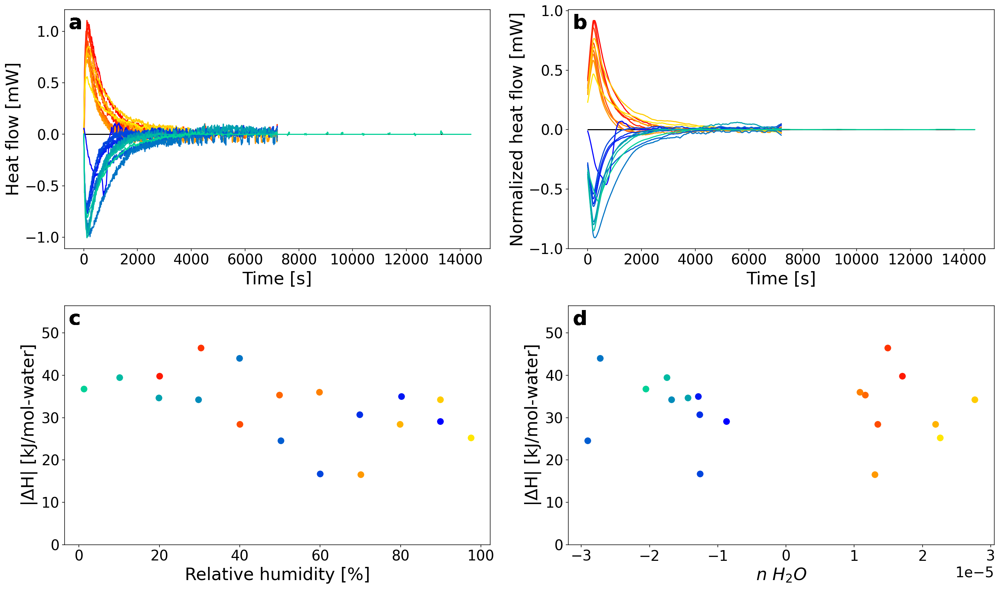

In [284]:
YT1_26C.chgc_data(plot=True)
YT1_26C.chgc_grad_data(plot=False)
YT1_26C.hydration_quant(fsize=100, hfextrema=1)
YT1_26C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

#### hysteresis plot

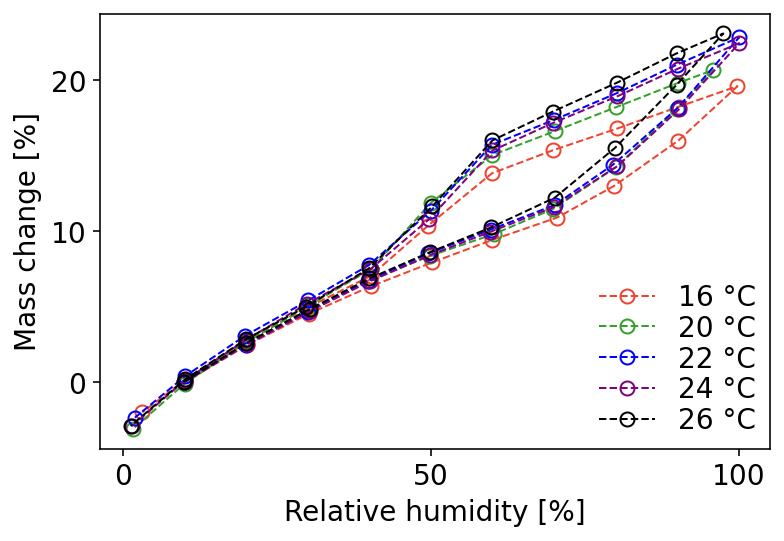

In [288]:
plt.figure(figsize=(6, 4))
plt.plot(YT1_16C.data['RH'][YT1_16C.end_segs], 100 * YT1_16C.mass_frac, marker='o', markersize=7, linestyle='--', label='16 \u00b0C', markerfacecolor='none', markeredgewidth=1, linewidth='1',color='#EE4431')
plt.plot(YT1_20C.data['RH'][YT1_20C.end_segs], 100 * YT1_20C.mass_frac, marker='o', markersize=7, linestyle='--', label='20 \u00b0C', markerfacecolor='none',linewidth='1', markeredgewidth=1, color='#369F2D')
plt.plot(YT1_22C.data['RH'][YT1_22C.end_segs], 100 * YT1_22C.mass_frac, marker='o', markersize=7, linestyle='--', label='22 \u00b0C', markerfacecolor='none', markeredgewidth=1,linewidth='1', color='blue')
plt.plot(YT1_24C.data['RH'][YT1_24C.end_segs], 100 * YT1_24C.mass_frac, marker='o', markersize=7, linestyle='--', label='24 \u00b0C', markerfacecolor='none', linewidth='1',markeredgewidth=1, color='purple')
plt.plot(YT1_26C.data['RH'][YT1_26C.end_segs], 100 * YT1_26C.mass_frac, marker='o', markersize=7, linestyle='--', label='26 \u00b0C', markerfacecolor='none', linewidth='1',markeredgewidth=1, color='black')
plt.xlabel('Relative humidity [%]', fontsize=14)
plt.ylabel('Mass change [%]', fontsize=14)
plt.legend(fontsize=14, loc='lower right', borderaxespad=0.1, ncol=1, labelspacing=0.1, columnspacing=0.5, frameon=False)#, labelspacing=0.1, columnspacing=0.5, handletextpad=0.1, handlelength=1.5)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()


#### YT1_temperature_study_16C_method

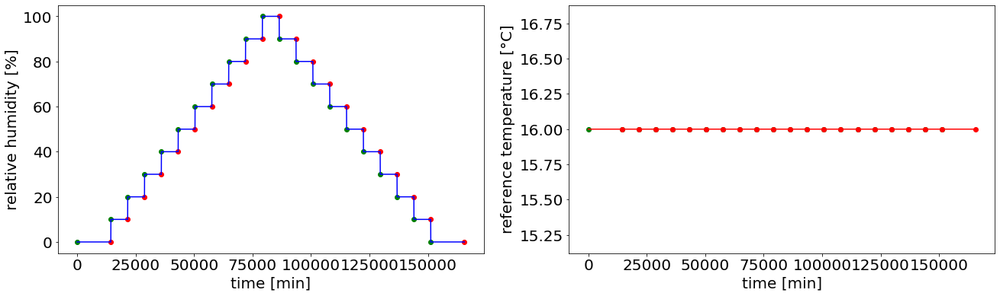

In [16]:
YT1_16C = chgc()

YT1_16C.import_method('YT1_temperature_study_16C_method\YT1_temperature_study_16C_method.txt')
YT1_16C.parse_method()
YT1_16C.plot_method()

YT1_16C.import_csv('YT1_temperature_study_16C_method\YT1_16C_2h_1.txt', preprocess=True)
YT1_16C.exclude_segments(segs=[1])
YT1_16C.data_gradient(sm=1*10**-3)

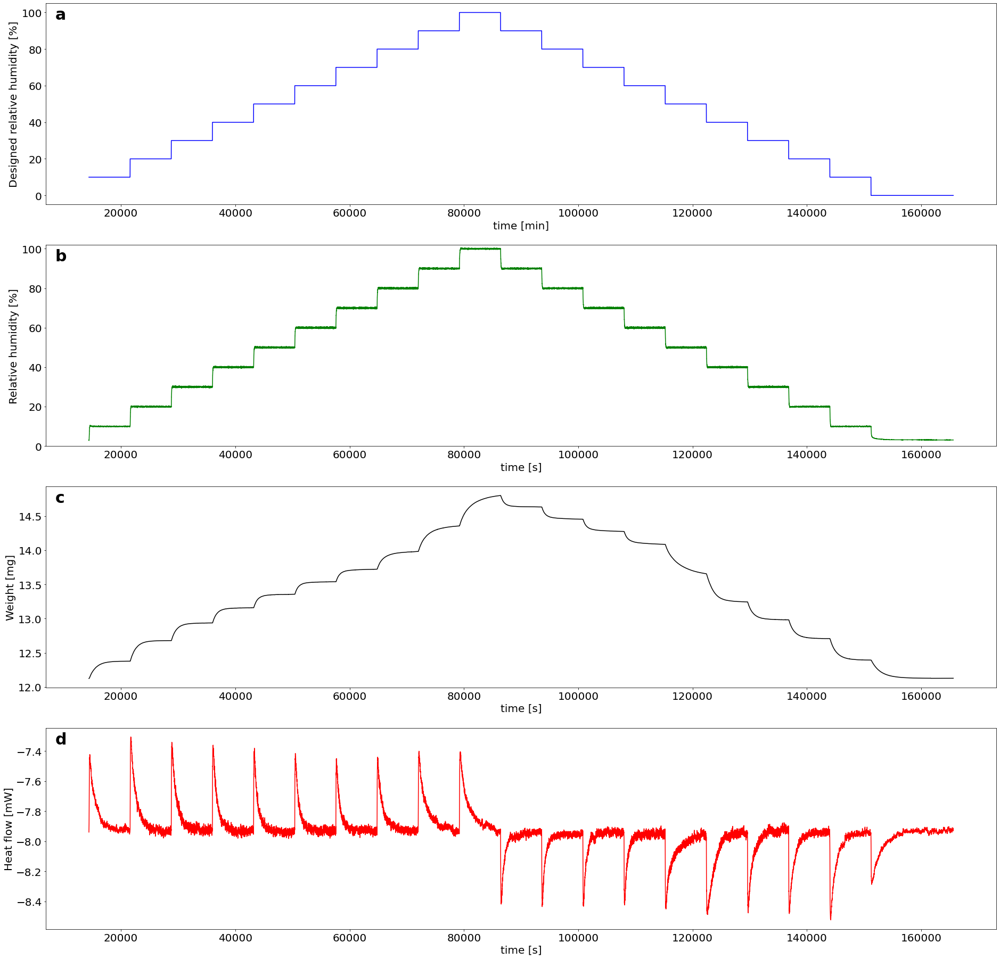

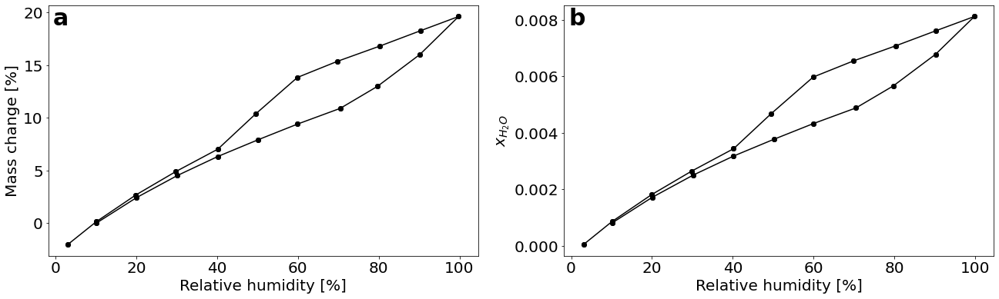

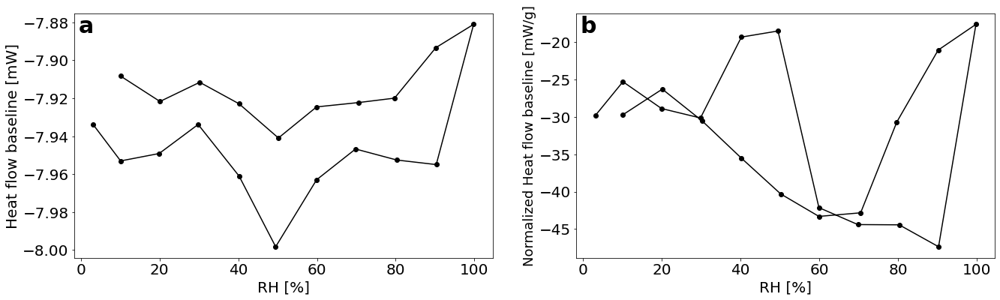

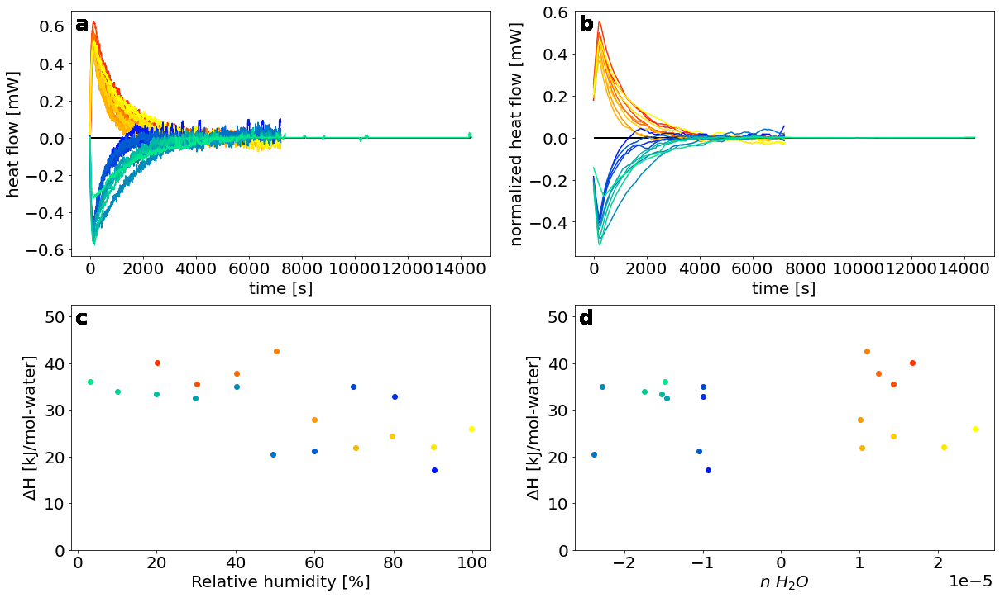

In [17]:
YT1_16C.chgc_data(plot=True)
YT1_16C.chgc_grad_data(plot=False)
YT1_16C.hydration_quant(fsize=100, hfextrema=1)
YT1_16C.hydration_integrate(peak_plot=False ,plot=True, timefactor=1)

####    YT1_temperature_study_20C_method_2

In [4]:
YT1_20C = chgc()

YT1_20C.import_method('YT1_temperature_study_20C_method_2\YT1_temperature_study_20C_method_2.txt')
YT1_20C.parse_method()

YT1_20C.import_csv('YT1_temperature_study_20C_method_2\YT1_20C_longtime.txt', preprocess=False)
#YT1_20C.exclude_segments(segs=[1,21])

#### YT1_temperature_study_22C_5h_method

In [5]:
YT1_22C = chgc()
YT1_22C.import_method('YT1_temperature_study_22C_5h_method\YT1_temperature_study_22C_5h_method.txt')
YT1_22C.parse_method()
YT1_22C.import_csv('YT1_temperature_study_22C_5h_method\YT1_22C_longtime_5h.txt', preprocess=True)
#YT1_22C.plot_method()
#YT1_22C.exclude_segments(segs=[1,21])

#### YT1_temperature_study_24C_method

In [6]:
YT1_24C = chgc()
YT1_24C.import_method('YT1_temperature_study_24C_method\YT1_temperature_study_24C_method.txt')
YT1_24C.parse_method()
YT1_24C.import_csv('YT1_temperature_study_24C_method\YT1_24C_longtime.txt', preprocess=False)
#YT1_24C.exclude_segments(segs=[1,21])

#### YT1_temperature_study_26C_method

In [7]:
YT1_26C = chgc()
YT1_26C.import_method('YT1_temperature_study_26C_method\YT1_temperature_study_26C_method.txt')
YT1_26C.parse_method()
YT1_26C.import_csv('YT1_temperature_study_26C_method\YT1_26C_2h.txt', preprocess=False)
#YT1_26C_2h.exclude_segments(segs=[1,21])

### Van 't Hoff Plot

In [3]:
YT1_16C_2h_1 = chgc()
YT1_16C_2h_1.import_method('YT1_temperature_study_16C_method\YT1_temperature_study_16C_method.txt')
YT1_16C_2h_1.parse_method()
YT1_16C_2h_1.import_csv('YT1_temperature_study_16C_method\YT1_16C_2h_1.txt', preprocess=True)
YT1_16C_2h_1.exclude_segments(segs=[1])

YT1_20C_longtime = chgc()
YT1_20C_longtime.import_method('YT1_temperature_study_20C_method_2\YT1_temperature_study_20C_method_2.txt')
YT1_20C_longtime.parse_method()
YT1_20C_longtime.import_csv('YT1_temperature_study_20C_method_2\YT1_20C_longtime.txt', preprocess=False)
YT1_20C_longtime.exclude_segments(segs=[1])

YT1_22C = chgc()
YT1_22C.import_method('YT1_temperature_study_22C_5h_method\YT1_temperature_study_22C_5h_method.txt')
YT1_22C.parse_method()
YT1_22C.import_csv('YT1_temperature_study_22C_5h_method\YT1_22C_longtime_5h.txt', preprocess=True)
YT1_22C.exclude_segments(segs=[1])

YT1_24C_longtime = chgc()
YT1_24C_longtime.import_method('YT1_temperature_study_24C_method\YT1_temperature_study_24C_method.txt')
YT1_24C_longtime.parse_method()
YT1_24C_longtime.import_csv('YT1_temperature_study_24C_method\YT1_24C_longtime.txt', preprocess=False)
YT1_24C_longtime.exclude_segments(segs=[1])

YT1_26C_2h = chgc()
YT1_26C_2h.import_method('YT1_temperature_study_26C_method\YT1_temperature_study_26C_method.txt')
YT1_26C_2h.parse_method()
YT1_26C_2h.import_csv('YT1_temperature_study_26C_method\YT1_26C_2h.txt', preprocess=False)
YT1_26C_2h.exclude_segments(segs=[1])

""" Get equilibrium constants for all temperatures. The second input is vapor saturation pressure of water at the corresponding temperature """
k_16C_hyd, k_16C_dehyd = YT1_16C_2h_1.equilibrium_constant('YT1_dry_weights_data\YT1_DW_16C_2h_1.txt', 1.818)
k_20C_hyd, k_20C_dehyd = YT1_20C_longtime.equilibrium_constant('YT1_dry_weights_data\YT1_DW_20C_longtime.txt', 2.340)
k_22C_hyd, k_22C_dehyd = YT1_22C.equilibrium_constant('YT1_dry_weights_data\YT1_DW_22C_longtime_5h.txt', 2.646)
k_24C_hyd, k_24C_dehyd = YT1_24C_longtime.equilibrium_constant('YT1_dry_weights_data\YT1_DW_24C_longtime.txt', 2.986)
k_26C_hyd, k_26C_dehyd = YT1_26C_2h.equilibrium_constant('YT1_dry_weights_data\YT1_DW_26C_2h.txt', 3.365)

In [4]:
""" Get the hydration/dehydration equilibrium constants at the 5 temperatures in one array"""

k_all_hyd = np.vstack((k_16C_hyd, k_20C_hyd, k_22C_hyd, k_24C_hyd, k_26C_hyd))
k_all_dehyd = np.vstack((k_16C_dehyd, k_20C_dehyd, k_22C_dehyd, k_24C_dehyd, k_26C_dehyd))

In [6]:
Temp_celcius = [16, 20, 22, 24, 26] # Temperatures of experiments 
Temp_kelvin = np.add(Temp_celcius, 273.15)

In [47]:
""" Get hydration equilibrium constants for each RH, e.g., k_hyd_10 is at 10% RH"""

for i in range(10):
    locals()['k_hyd_'+str(i+1)+'0'] = k_all_hyd[:, i]
    #print('k_hyd_'+str(i+1)+'0')
""" Get dehydration equilibrium constants for each RH, e.g., k_dehyd_10 is at 10% RH"""

for i in range(10):
    locals()['k_dehyd_'+str(i)+'0'] = k_all_dehyd[:, 9-i]
    #print('k_dehyd_'+str(i)+'0')

#### △G = -RTlog(K)

In [38]:
deltaG_hyd_16C = -8.314*(15+273.15)*np.log(k_all_hyd[0])/1000
deltaG_hyd_16C

array([10.51127546,  8.20487428,  6.80767166,  5.81493975,  5.04805935,
        4.41929065,  3.87503366,  3.33748084,  2.78305516,  2.25698971])

In [39]:
deltaG_dehyd_16C = -8.314*(15+273.15)*np.log(k_all_dehyd[0])/1000
deltaG_dehyd_16C

array([ -2.60691883,  -3.00022124,  -3.43965534,  -3.94556969,
        -4.74340257,  -5.70989463,  -6.74094664,  -8.15054183,
       -10.46882811, -14.06306108])

Text(0.5, 1.0, 'Hydration free energy at 15 °C')

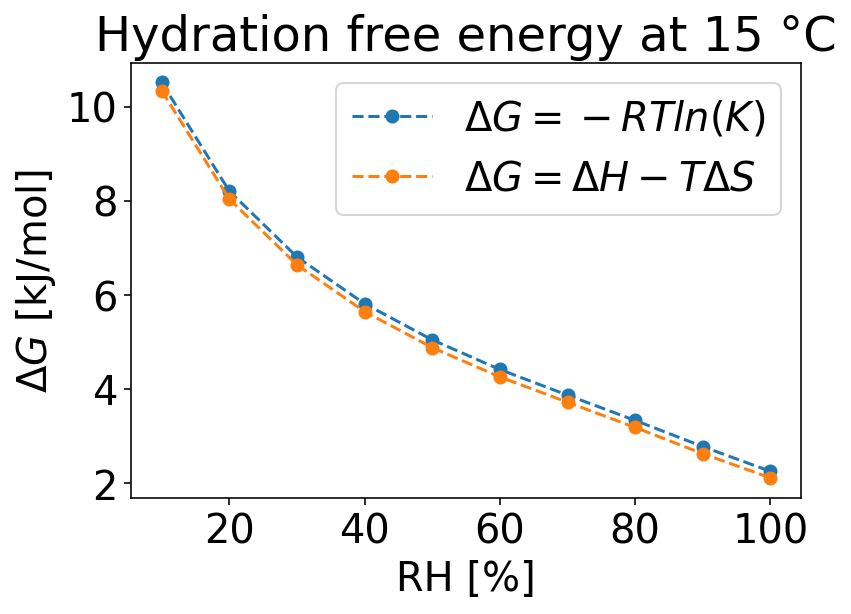

In [46]:
plt.plot(YT1_16C_2h_1.eff_rh[0:10], deltaG_hyd_16C,'o--', label='$\Delta G = -RT ln(K)$')
plt.plot(YT1_16C_2h_1.eff_rh[0:10], delta_gibbs_hyd[3], 'o--',label='$\Delta G = \Delta H - T \Delta S$')
plt.legend()
plt.xlabel('RH [%]')
plt.ylabel('$\Delta G$ [kJ/mol]')
plt.title('Hydration free energy at 15 \u00b0C')

#### △S and △H from Van 't Hoff 

In [9]:
""" Get enthalpy and entropy at each RH during hydration/dehydration using Van 't Hoff Plot """

delta_enthalpies_hyd = []
delta_entropies_hyd = []
delta_enthalpies_dehyd = []
delta_entropies_dehyd = []

for i in range(10):
    locals()['delta_enthalpy_'+str(i+1)+'0_hyd'], locals()['delta_entropy_'+str(i+1)+'0_hyd'] = vant_hoff_plot(Temp_kelvin, locals()['k_hyd_'+str(i+1)+'0'])
    delta_enthalpies_hyd.append(locals()['delta_enthalpy_'+str(i+1)+'0_hyd'])
    delta_entropies_hyd.append(locals()['delta_entropy_'+str(i+1)+'0_hyd'])

for i in range(10):
    locals()['delta_enthalpy_'+str(i)+'0_dehyd'], locals()['delta_entropy_'+str(i)+'0_dehyd'] = vant_hoff_plot(Temp_kelvin, locals()['k_dehyd_'+str(i)+'0'])
    delta_enthalpies_dehyd.append(locals()['delta_enthalpy_'+str(i)+'0_dehyd'])
    delta_entropies_dehyd.append(locals()['delta_entropy_'+str(i)+'0_dehyd'])

Text(0.5, 1.0, "Van 't Hoff Enthalpies")

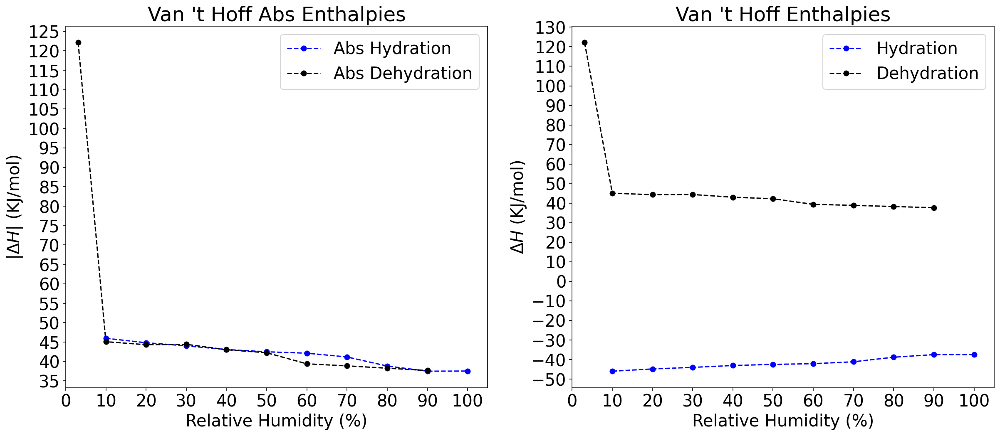

In [10]:
""" Plot absolute ΔH and ΔH against RH. ΔH are from Van 't Hoff Plots. """

fig, axs = plt.subplots(1,2, figsize=(20,8), facecolor='white')

axs[0].plot(YT1_16C_2h_1.eff_rh[0:10], np.abs(delta_enthalpies_hyd), 'bo--', label="Abs Hydration")
axs[0].plot(YT1_16C_2h_1.eff_rh[10:][::-1], delta_enthalpies_dehyd, 'ko--', label="Abs Dehydration")
axs[0].legend()
axs[0].set_xlabel('Relative Humidity (%)')
axs[0].set_ylabel(r'$|\Delta H| $ (KJ/mol)')
axs[0].set_xlim(0,105)
axs[0].xaxis.set_major_locator(ticker.MultipleLocator(10))
axs[0].yaxis.set_major_locator(ticker.MultipleLocator(5))
axs[0].set_title('Van \'t Hoff Abs Enthalpies')

axs[1].plot(YT1_16C_2h_1.eff_rh[0:10], delta_enthalpies_hyd, 'bo--', label="Hydration")
axs[1].plot(YT1_16C_2h_1.eff_rh[10:][::-1], delta_enthalpies_dehyd, 'ko--', label="Dehydration")
axs[1].legend()
axs[1].set_xlabel('Relative Humidity (%)')
axs[1].set_ylabel(r'$\Delta H $ (KJ/mol)')
axs[1].set_xlim(0,105)
axs[1].xaxis.set_major_locator(ticker.MultipleLocator(10))
axs[1].yaxis.set_major_locator(ticker.MultipleLocator(10))
axs[1].set_title('Van \'t Hoff Enthalpies')

(0.0, 105.0)

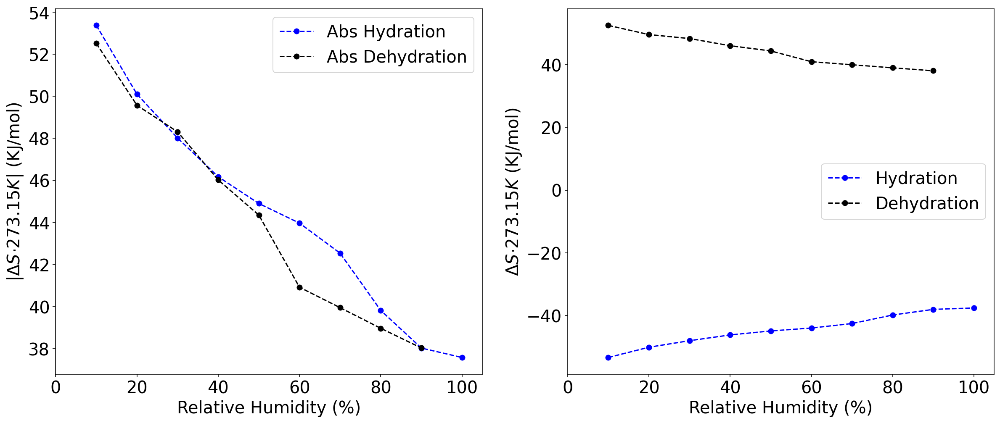

In [11]:
""" Plot of absolute ΔS * 273.15 K and ΔS * 273.15 K against RH.  """

fig, axs = plt.subplots(1,2, figsize=(20,8), facecolor='white')
plt.rcParams.update({'font.size': 20})

axs[0].plot(YT1_16C_2h_1.eff_rh[0:10], np.abs(delta_entropies_hyd)*273.15, 'bo--', label="Abs Hydration")
axs[0].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.dot(delta_entropies_dehyd[1:],273.15), 'ko--', label="Abs Dehydration")
axs[0].legend()
axs[0].set_xlabel('Relative Humidity (%)')
axs[0].set_ylabel(r'$|  \Delta S \dot 273.15K| $ (KJ/mol)')
axs[0].set_xlim(0,105)
#axs[0].xaxis.set_major_locator(ticker.MultipleLocator(10))
#axs[0].yaxis.set_major_locator(ticker.MultipleLocator(5))
#axs[0].set_title('Van \'t Hoff Abs Entropies * 273.15K')

axs[1].plot(YT1_16C_2h_1.eff_rh[0:10], np.dot(delta_entropies_hyd,273.15), 'bo--', label="Hydration")
axs[1].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.dot(delta_entropies_dehyd[1:],273.15), 'ko--', label="Dehydration")
axs[1].legend()
axs[1].set_xlabel('Relative Humidity (%)')
axs[1].set_ylabel(r'$\Delta S \dot 273.15K $ (KJ/mol)')
axs[1].set_xlim(0,105)
#axs[1].set_ylim(-60,60)
#axs[1].xaxis.set_major_locator(ticker.MultipleLocator(10))
#axs[1].yaxis.set_major_locator(ticker.MultipleLocator(20))
#axs[1].set_title('Van \'t Hoff Entropies * 273.15K')

### Gibbs Free Energy ΔG

In [23]:
""" Gibbs Free Energy """
""" ΔG = ΔH - TΔS , ΔH and ΔS are calculated from Van 't Hoff Plots """

Temp_range = [273.15, 278.15, 283.15, 288.15, 293.15, 298.15] # temperatures for testing the Gibbs free energy calculations from 0C to 25C.
delta_gibbs_hyd = []
delta_gibbs_dehyd = []

for i in range(len(Temp_range)):
    delta_gibbs_hyd.append(delta_enthalpies_hyd - np.dot(Temp_range[i],delta_entropies_hyd))
    delta_gibbs_dehyd.append(delta_enthalpies_dehyd - np.dot(Temp_range[i],delta_entropies_dehyd))

In [36]:
delta_gibbs_hyd

[array([7.40601082, 5.28399575, 4.00405806, 3.11235525, 2.41717818,
        1.84699469, 1.38843442, 1.00278219, 0.54212738, 0.05590768]),
 array([8.38300963, 6.20112422, 4.88299934, 3.95761408, 3.23915281,
        2.6519081 , 2.16715532, 1.73173354, 1.23829641, 0.74386209]),
 array([9.36000844, 7.11825269, 5.76194061, 4.80287292, 4.06112744,
        3.45682151, 2.94587622, 2.46068488, 1.93446544, 1.43181649]),
 array([10.33700726,  8.03538116,  6.64088189,  5.64813175,  4.88310207,
         4.26173492,  3.72459712,  3.18963623,  2.63063447,  2.1197709 ]),
 array([11.31400607,  8.95250962,  7.51982317,  6.49339058,  5.7050767 ,
         5.06664833,  4.50331801,  3.91858758,  3.3268035 ,  2.8077253 ]),
 array([12.29100488,  9.86963809,  8.39876445,  7.33864942,  6.52705133,
         5.87156174,  5.28203891,  4.64753893,  4.02297253,  3.49567971])]

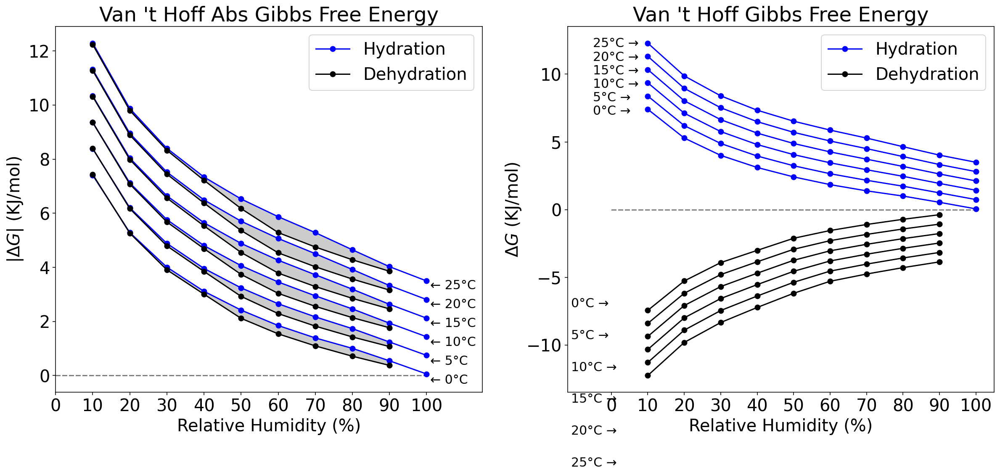

In [201]:
""" Plot Gibbs Free Energy calculated from Van 't Hoff Plots """

fig, axs = plt.subplots(1,2, figsize=(20,8), facecolor='white')
plt.rcParams.update({'font.size': 20})
legend1 = ['Hydration', 'Dehydration']
for i in range(len(Temp_range)):
    axs[0].plot(YT1_16C_2h_1.eff_rh[0:10], delta_gibbs_hyd[i], 'o-', color='b')#markersize=5
    axs[0].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.abs(delta_gibbs_dehyd[i][1:]), 'ko-')#markersize=5
    axs[0].legend(legend1)
    axs[0].set_xlabel('Relative Humidity (%)')
    axs[0].set_ylabel(r'$|\Delta G| $ (KJ/mol)')
    axs[0].set_xlim(0,115)
    axs[0].set_xticks(range(0, 101, 10))
    #axs[0].xaxis.set_major_locator(ticker.MultipleLocator(10))
    #axs[0].yaxis.set_major_locator(ticker.MultipleLocator(1))
    axs[0].set_title('Van \'t Hoff Abs Gibbs Free Energy')
    axs[0].text(101, i*0.7-0.3, "\u2190 %s\u00b0C"%(i*5), fontsize=15)
    #axs[0].text(65, 9, 'Absolute values')
    axs[0].hlines(0, 0, 100, linestyle="--", linewidth=1.5, color='grey') # y, xmin, xmax
    axs[0].fill_between(YT1_16C_2h_1.eff_rh[0:9], delta_gibbs_hyd[i][0:9],np.abs(delta_gibbs_dehyd[i][1:10]), color='k', alpha=0.2)

    axs[1].plot(YT1_16C_2h_1.eff_rh[0:10], delta_gibbs_hyd[i], 'bo-', label="Hydration")
    axs[1].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], delta_gibbs_dehyd[i][1:], 'ko-', label="Dehydration")
    axs[1].legend(legend1)
    axs[1].set_xlabel('Relative Humidity (%)')
    axs[1].set_ylabel(r'$\Delta G $ (KJ/mol)')
    axs[1].set_xlim(-12,105)
    axs[1].set_xticks(range(0, 101, 10))
    #axs[1].xaxis.set_major_locator(ticker.MultipleLocator(10))
    #axs[1].yaxis.set_major_locator(ticker.MultipleLocator(2))
    axs[1].set_title('Van \'t Hoff Gibbs Free Energy')
    axs[1].text(-5, i+7, "%s\u00b0C \u2192"%(i*5), fontsize=15)
    axs[1].text(-11, -i*2.35-7.2, "%s\u00b0C \u2192"%(i*5), fontsize=15)
    axs[1].hlines(0, 0, 100, linestyle="--", linewidth=1.5, color='grey') # y, xmin, xmax
    


#### Plot △G and △S in one figure

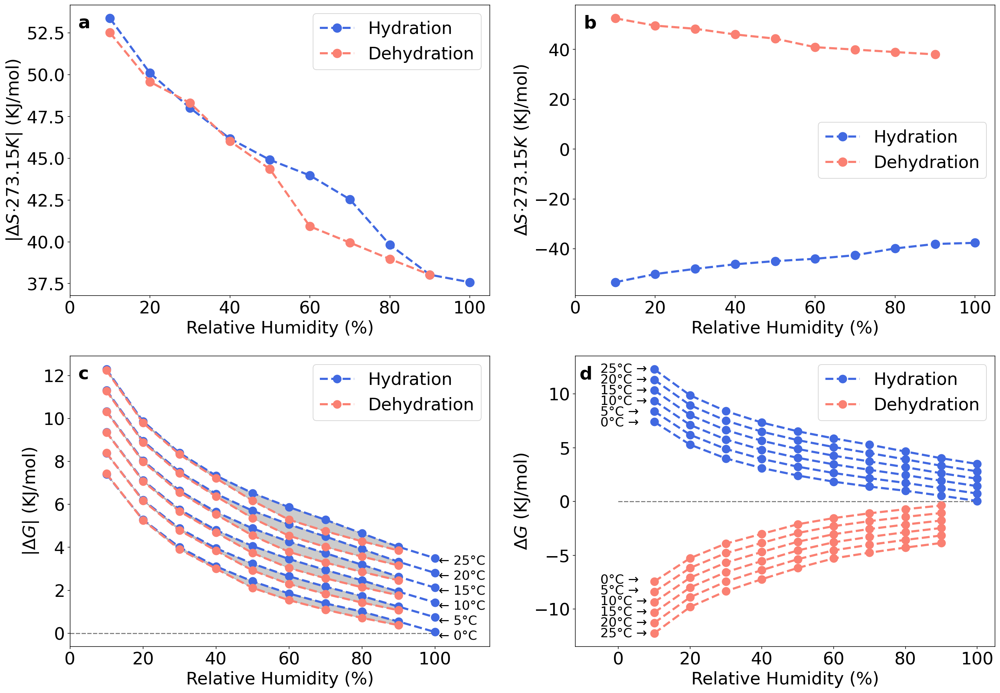

In [274]:
""" Plot S and G """

fig, axs = plt.subplots(2, 2, figsize=(20, 14), facecolor='white')
plt.rcParams.update({'font.size': 24})

axs[0, 0].text(0.02, 0.92, 'a', transform=axs[0, 0].transAxes, fontsize=25, fontweight='bold')
axs[0, 1].text(0.02, 0.92, 'b', transform=axs[0, 1].transAxes, fontsize=25, fontweight='bold')
axs[1, 0].text(0.02, 0.92, 'c', transform=axs[1, 0].transAxes, fontsize=25, fontweight='bold')
axs[1, 1].text(0.01, 0.92, 'd', transform=axs[1, 1].transAxes, fontsize=25, fontweight='bold')

axs[0, 0].plot(YT1_16C_2h_1.eff_rh[0:10], np.abs(delta_entropies_hyd) * 273.15,color='royalblue', marker='o',linestyle='--', markersize=12, linewidth=3,label="Hydration")
axs[0, 0].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.dot(delta_entropies_dehyd[1:], 273.15), color='salmon', marker='o',linestyle='--', markersize=12, linewidth=3,label="Dehydration")
axs[0, 0].legend()
axs[0, 0].set_xlabel('Relative Humidity (%)')
axs[0, 0].set_ylabel(r'$|  \Delta S \dot 273.15K| $ (KJ/mol)')
axs[0, 0].set_xlim(0, 105)

axs[0, 1].plot(YT1_16C_2h_1.eff_rh[0:10], np.dot(delta_entropies_hyd, 273.15), color='royalblue', marker='o',linestyle='--', markersize=12, linewidth=3,label="Hydration")
axs[0, 1].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.dot(delta_entropies_dehyd[1:], 273.15), color='salmon', marker='o',linestyle='--', markersize=12, linewidth=3, label="Dehydration")
axs[0, 1].legend()
axs[0, 1].set_xlabel('Relative Humidity (%)')
axs[0, 1].set_ylabel(r'$\Delta S \dot 273.15K $ (KJ/mol)')
axs[0, 1].set_xlim(0, 105)

for i in range(len(Temp_range)):
    axs[1, 0].plot(YT1_16C_2h_1.eff_rh[0:10], delta_gibbs_hyd[i], color='royalblue', marker='o',linestyle='--', markersize=11, linewidth=3, label="Hydration")
    axs[1, 0].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], np.abs(delta_gibbs_dehyd[i][1:]), color='salmon', marker='o',linestyle='--', markersize=11, linewidth=3, label="Dehydration")
    axs[1, 0].legend(legend1)
    axs[1, 0].set_xlabel('Relative Humidity (%)')
    axs[1, 0].set_ylabel(r'$|\Delta G |$ (KJ/mol)')
    axs[1, 0].set_xlim(0, 115)
    axs[1, 0].text(101, i*0.7-0.3, "\u2190 %s\u00b0C"%(i*5), fontsize=18)
    axs[1, 0].hlines(0, 0, 100, linestyle="--", linewidth=1.5, color='grey') # y, xmin, xmax
    axs[1, 0].fill_between(YT1_16C_2h_1.eff_rh[0:9], delta_gibbs_hyd[i][0:9],np.abs(delta_gibbs_dehyd[i][1:10]), color='k', alpha=0.2)

    axs[1, 1].plot(YT1_16C_2h_1.eff_rh[0:10], delta_gibbs_hyd[i], color='royalblue', marker='o',linestyle='--', markersize=11, linewidth=3,  label="Hydration")
    axs[1, 1].plot(YT1_16C_2h_1.eff_rh[10:19][::-1], delta_gibbs_dehyd[i][1:], color='salmon', marker='o',linestyle='--', markersize=11, linewidth=3,label="Dehydration")
    axs[1, 1].legend(legend1)
    axs[1, 1].set_xlabel('Relative Humidity (%)')
    axs[1, 1].set_ylabel(r'$\Delta G $ (KJ/mol)')
    axs[1, 1].set_xlim(-12, 105)
    axs[1, 1].text(-5, i+7, "%s\u00b0C \u2192"%(i*5), fontsize=18)
    axs[1, 1].text(-5, -i-7.6, "%s\u00b0C \u2192"%(i*5), fontsize=18)
    axs[1, 1].hlines(0, 0, 100, linestyle="--", linewidth=1.5, color='grey') # y, xmin, xmax
    

plt.tight_layout()
plt.show()